In [1]:
import os
import subprocess
# os.environ["HDXER_PATH"] = "/home/alexi/Documents/HDXer"
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import glob
import sys
sys.path.append("/home/alexi/Documents/ValDX/")
import pandas as pd 


In [163]:
protein = "HOIP"

# set plain white style
sns.set_style("ticks")
# set font scales

sns.set_context("paper", rc={
    "axes.labelsize": 20,
    "axes.titlesize": 18,
    "xtick.labelsize": 16,
    "ytick.labelsize": 16,
})

In [3]:
def transform_naming(df):
    """
    Transform complex naming patterns in DataFrame to standardized ensemble categories.
    
    Parameters:
    df (pd.DataFrame): Input DataFrame containing 'name' column with patterns like
                      'BPTI_10Start_RW_bench_R3_k_sequence'
    
    Returns:
    pd.DataFrame: DataFrame with transformed naming columns
    """
    df = df.copy()
    
    # Extract method and fit from name
    df["protein"] = df["name"].apply(lambda x: x.split("_")[0])
    df["method"] = df["name"].apply(lambda x: x.split("_")[2])

    df["fit"] = df["name"].apply(lambda x: x.split("_")[3])
    

    # Initialize ensemble based on the core system type from name
    def determine_ensemble(name):
        parts = name.split("_")
        
        # Check for start conditions
        if "10Start" in name:
            return "MD-10Start"
        if "1Start" in name:
            return "MD-1Start"
            
        # Check for shaw_400
        if "shaw_400" in name:
            return "MD-Shaw"
            
        # Check for TFES
        if "TFES" in name:
            return "MD-TFES"
        # Check for clean/dirty
        if "clean"in parts:
            return "AF2-Filtered"
        if "Cleaned" in name:
            return "AF2-Filtered"
        
        if "dirty" in parts:
            return "AF2-MSAss"


        if  "MSAss" in parts:
            return "AF2-MSAss"
        
        
        if "plddt" in name:
            return "AF2-MaxPLDDT"
        
        if "rank" in name:
            return "AF2-MaxRank"
            
        # Default to method if no special case
        return parts[2]
    
    def determine_split_name(split_type):
        if split_type == "r":
            return "Random"
        if split_type == "s":
            return "Sequence"
        if split_type == "R3":
            return "Non-Redundant"
        if split_type == "Sp":
            return "Spatial"
            
    
    df["ensemble"] = df["name"].apply(determine_ensemble)
    
    df["split_type"] = df ["name"].apply(lambda x: x.split("_")[-3])

    df["split_name"] = df["split_type"].apply(determine_split_name)
    df["replicate"] = df["calc_name"].apply(lambda x: x.split("_")[-1])  

    df["analysis"] = df["name"].apply(lambda x: x.split("_")[3])

    return df

In [4]:
dataset_colours = {
    "af_dirty": "navy",
    "af_clean": "cyan",
    "af_cleaned": "dodgerblue",
    "1Start": "orchid",
    "10Start": "orange",
    "TFES": "purple",
    "af_rank": "darkcyan",
    "af_plddt": "lime",
    
}

full_dataset_colours = {
    "AF2-MSAss": "navy",
    "AF2-Filtered": "dodgerblue",
    "MD-1Start": "orchid",
    "MD-10Start": "orange",
    "MD-TFES": "purple",
    "AF2-MaxRank": "darkcyan",
    "AF2-MaxPLDDT": "lime",
}

split_name_dataset_colours = {
    "Random": "red",
    "Sequence": "black",
    "Non-Redundant": "green",
    "Spatial": "grey"
}


split_type_dataset_colours = {
    "r": "red",
    "s": "black",
    "R3": "green",
    "Sp": "grey"
}

split_name_mapping = {
    "r": "Random",
    "s": "Sequence",
    "R3": "Non-Redundant",
    "Sp": "Spatial"
}

dataset_order = ["af_clean", "1Start"]
full_dataset_order = ["AF2-MaxRank", "AF2-MaxPLDDT"] 

split_name_dataset_order = ["Non-Redundant", "Spatial"]



metric_name_mapping = {
    "delta_H_opt_kj" : "Shape Change ($Work_{shape}$)",
    "-Tdelta_S_opt_kj" : "Redistribution of PFs ($Work_{density}$) ",
    "delta_G_opt_kj" : "Work Done ($Work_{opt}$)",
    "delta_H_abs_kj" : "Uptake-Scale Change ($Work_{scale}$)",
    "dMSE" : "Validation Error Change ($\Delta MSE_{opt}$)",
    "mse" : "Validation Error ($MSE_{Validation}$)"
}


metric_axis_mapping = {
    "delta_H_opt_kj": "$Work_{shape}$ [kJ/mol]",
    "-Tdelta_S_opt_kj": "$Work_{density}$ [kJ/mol]",
    "delta_G_opt_kj": "$Work_{opt}$ [kJ/mol]",
    "delta_H_abs_kj": "$Work_{scale}$ [kJ/mol]",
    "dMSE": "$\Delta MSE_{opt}$",
    "mse": "$MSE_{Validation}$",
    "c_frac1": "Cluster Fraction"
}



In [5]:
results_dir = "/home/alexi/Documents/interpretable-hdxer/data/fig2/HOIP"
# results_dir = "/home/alexi/Documents/ValDX/results"


# results_dir = "/home/alexi/Documents/ValDX/results/Find-Clusters2"
csvs = glob.glob(results_dir + '/**/*.csv', recursive=True)

# only include csvs that include BPTI

csvs = [csv for csv in csvs if 'HOIP' in csv]


print(len(csvs))

56


In [6]:
# # load pkls

# #find all pkls in the BPTI results dir in all subdirs
# # BPTI_pkls = glob.glob(BPTI_results_dir + '/**/*.pkl', recursive=True)



# print(len(BPTI_pkls))

# from ValDX.VDX_dataclasses import merge_AnalysisData_classes


# import pickle

# # load all the pkls
# BPTI_pkl_list = []
# for pkl in BPTI_pkls:
#     with open(pkl, 'rb') as f:
#         BPTI_pkl_list.append(pickle.load(f))


# # merge all the pkls
# BPTI_pkl_merged = merge_AnalysisData_classes(BPTI_pkl_list)



In [162]:
def p_to_stars(p_val):
    """Convert p-value to significance stars."""
    if pd.isna(p_val):
        return 'n.s.'
    elif p_val < 0.0001:
        return '****'
    elif p_val < 0.001:
        return '***'
    elif p_val < 0.01:
        return '**'
    elif p_val < 0.05:
        return '*'
    elif p_val < 0.1:
        return '‡'  # dagger
    elif p_val < 0.25:
        return '†' # dagger
    else:
        return 'n.s.'
        


In [8]:
# 

In [9]:
# load pkls

#find all pkls in the BPTI results dir in all subdirs
pkls = glob.glob(results_dir + '/**/*.pkl', recursive=True)



print(len(pkls))

from ValDX.VDX_dataclasses import merge_AnalysisData_classes

import pickle

# load all the pkls
pkl_list = []
for pkl in pkls:
    with open(pkl, 'rb') as f:
        pkl_list.append(pickle.load(f))


# merge all the pkls
pkl_list = merge_AnalysisData_classes(pkl_list)



56
/home/alexi/Documents/interpretable-hdxer/notebooks/Figure-2_Single_Split_BV


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/Bio/Application/__init__.py:40: BiopythonDeprecationWarning: The Bio.Application modules and modules relying on it have been deprecated.

Due to the on going maintenance burden of keeping command line application
wrappers up to date, we have decided to deprecate and eventually remove these
modules.

We instead now recommend building your command line and invoking it directly
with the subprocess module.
  warnings.warn(


Merging AnalysisData classes
['train_dfs', 'val_dfs', 'expt_df', 'merge_df', 'expt_segs', 'train_segs', 'val_segs', 'HDX_data', 'weights', 'features', 'BV_constants', 'LogPfs', 'analysis_df']


In [10]:
def extract_protein_name(pkl_list:dict, protein_names: list):
    """
    Extracts the protein name from the name in the dictionary of pandas dataframes
    """

    for key, df in pkl_list.items():
        # iterate through the rows
        for i, row in df.iterrows():
            # print(row["name"])
            # iterate through the protein names
            for protein_name in protein_names:
                # check if the protein name is in the row name
                if protein_name in row["name"]:
                    print(i, protein_name)
                    # if it is, set the protein name to the protein name
                    row["protein"] = protein_name
            df.loc[i] = row
        
        pkl_list[key] = df

                    
    return pkl_list

protein_names = ["HOIP"]

pkl_list = extract_protein_name(pkl_list, protein_names)
        
pkl_list["analysis_df"]



0 HOIP
1 HOIP
2 HOIP
3 HOIP
4 HOIP
5 HOIP
6 HOIP
7 HOIP
8 HOIP
9 HOIP
10 HOIP
11 HOIP
12 HOIP
13 HOIP
14 HOIP
15 HOIP
16 HOIP
17 HOIP
18 HOIP
19 HOIP
20 HOIP
21 HOIP
22 HOIP
23 HOIP
24 HOIP
25 HOIP
26 HOIP
27 HOIP
28 HOIP
29 HOIP
30 HOIP
31 HOIP
32 HOIP
33 HOIP
34 HOIP
35 HOIP
36 HOIP
37 HOIP
38 HOIP
39 HOIP
40 HOIP
41 HOIP
42 HOIP
43 HOIP
44 HOIP
45 HOIP
46 HOIP
47 HOIP
48 HOIP
49 HOIP
50 HOIP
51 HOIP
52 HOIP
53 HOIP
54 HOIP
55 HOIP
56 HOIP
57 HOIP
58 HOIP
59 HOIP
60 HOIP
61 HOIP
62 HOIP
63 HOIP
64 HOIP
65 HOIP
66 HOIP
67 HOIP
68 HOIP
69 HOIP
70 HOIP
71 HOIP
72 HOIP
73 HOIP
74 HOIP
75 HOIP
76 HOIP
77 HOIP
78 HOIP
79 HOIP
80 HOIP
81 HOIP
82 HOIP
83 HOIP
84 HOIP
85 HOIP
86 HOIP
87 HOIP
88 HOIP
89 HOIP
90 HOIP
91 HOIP
92 HOIP
93 HOIP
94 HOIP
95 HOIP
96 HOIP
97 HOIP
98 HOIP
99 HOIP
100 HOIP
101 HOIP
102 HOIP
103 HOIP
104 HOIP
105 HOIP
106 HOIP
107 HOIP
108 HOIP
109 HOIP
110 HOIP
111 HOIP
112 HOIP
113 HOIP
114 HOIP
115 HOIP
116 HOIP
117 HOIP
118 HOIP
119 HOIP
120 HOIP
121 HOIP
122 HOIP
123

,time,Type,R,calc_name,mse,name,system,analysis,split_type,protein,name_name,dataset,class
0,0.5,Train,0.367253,train_HOIP_MD_TFES_1,NaN,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV_bench,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_train_H...,train,train_r
1,0.5,Val,0.060466,val_HOIP_MD_TFES_1,NaN,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV_bench,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_val_HOI...,val,val_r
2,0.5,Train,0.418769,train_HOIP_MD_TFES_2,NaN,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV_bench,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_train_H...,train,train_r
3,0.5,Val,-0.021497,val_HOIP_MD_TFES_2,NaN,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV_bench,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_val_HOI...,val,val_r
4,0.5,Train,0.272955,train_HOIP_MD_TFES_3,NaN,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV_bench,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_train_H...,train,train_r
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4587,5.0,Val,NaN,val_HOIP_MD_10Start_6,0.054825,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV_bench,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_val_HOI...,val,val_R3
4588,5.0,Val,NaN,val_HOIP_MD_10Start_7,0.022645,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV_bench,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_val_HOI...,val,val_R3
4589,5.0,Val,NaN,val_HOIP_MD_10Start_8,0.078312,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV_bench,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_val_HOI...,val,val_R3
4590,5.0,Val,NaN,val_HOIP_MD_10Start_9,0.038367,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV_bench,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_val_HOI...,val,val_R3


In [11]:
def extract_benchmark_name(pkl_list:dict):
    """
    Extracts the benchmark name from the name in the dictionary of pandas dataframes
    """

    for key, df in pkl_list.items():
        df['bench'] = df['name'].apply(lambda x: 'noBV' if '_noBV_' in x else 'BV')
        pkl_list[key] = df
  
    return pkl_list

pkl_list = extract_benchmark_name(pkl_list)

In [12]:
pkl_list["analysis_df"].bench.value_counts()

bench
noBV    2296
BV      2296
Name: count, dtype: int64

In [13]:
pkl_list["BV_constants"].bench.value_counts()

bench
noBV    308
BV      308
Name: count, dtype: int64

In [14]:
pkl_list["analysis_df"].protein.value_counts()

protein
HOIP    4592
Name: count, dtype: int64

In [15]:

logpfs = pkl_list["LogPfs"]
print(logpfs)

        Residues      LogPf                calc_name  \
0              2   6.487252     prior_HOIP_MD_TFES_1   
1              3  12.053130     prior_HOIP_MD_TFES_1   
2              4   7.355038     prior_HOIP_MD_TFES_1   
3              5   4.576832     prior_HOIP_MD_TFES_1   
4              6   4.320267     prior_HOIP_MD_TFES_1   
...          ...        ...                      ...   
403629       356  23.568602  test_HOIP_MD_10Start_10   
403630       357  24.551999  test_HOIP_MD_10Start_10   
403631       358  23.382054  test_HOIP_MD_10Start_10   
403632       359  21.767980  test_HOIP_MD_10Start_10   
403633       360  22.421894  test_HOIP_MD_10Start_10   

                                          name  \
0       HOIP_MD_TFES_noBV_bench_r_naive_random   
1       HOIP_MD_TFES_noBV_bench_r_naive_random   
2       HOIP_MD_TFES_noBV_bench_r_naive_random   
3       HOIP_MD_TFES_noBV_bench_r_naive_random   
4       HOIP_MD_TFES_noBV_bench_r_naive_random   
...                        

In [16]:
logpf=transform_naming(logpfs)

logpf.ensemble.value_counts()

ensemble
AF2-MaxRank     58202
MD-TFES         57952
MD-10Start      57570
MD-1Start       57488
AF2-Filtered    57474
AF2-MSAss       57474
AF2-MaxPLDDT    57474
Name: count, dtype: int64

In [17]:
# # load into pandas

# import pandas as pd

# BPTI_dfs = [pd.read_csv(csv) for csv in BPTI_csvs]

# BPTI_dfs = pd.concat(BPTI_dfs)

# BPTI_dfs


In [18]:
# # find _noBV_ or _BV_ in "name" - add to "bench"
# BPTI_dfs['bench'] = BPTI_dfs['naxme'].apply(lambda x: 'noBV' if '_noBV_' in x else 'BV')

# BPTI_dfs


In [19]:
# drop mse nan values
import pandas as pd
df = pkl_list["analysis_df"]
mse_dfs = df.dropna(subset=['mse'])
# order bench by list ['noBV', 'BV']
mse_dfs['bench'] = pd.Categorical(mse_dfs['bench'], categories=['noBV', 'BV'], ordered=True)

mse_dfs = transform_naming(mse_dfs)

# mse_dfs["method"] = mse_dfs["name"].apply(lambda x: x.split("_")[2])
# mse_dfs.method.value_counts()

# mse_dfs["ensemble"] = mse_dfs["method"].apply(lambda x: "Shaw_" + x if x == "small" else x)


# # if dirty, clean or conf in name add af_ to the front
# mse_dfs["ensemble"] = mse_dfs["ensemble"].apply(lambda x: "MD_"+x if not ("TFES" or "Start" or "Start") in x  else "af_"+x)


print(mse_dfs.ensemble.unique())
print(len(mse_dfs.ensemble.unique()))
print(mse_dfs.ensemble.value_counts())

['MD-TFES' 'MD-10Start' 'AF2-Filtered' 'AF2-MSAss' 'MD-1Start'
 'AF2-MaxRank' 'AF2-MaxPLDDT']
7
ensemble
MD-TFES         336
MD-10Start      336
AF2-Filtered    336
AF2-MSAss       336
MD-1Start       336
AF2-MaxRank     336
AF2-MaxPLDDT    336
Name: count, dtype: int64


/tmp/ipykernel_2064812/3318222165.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mse_dfs['bench'] = pd.Categorical(mse_dfs['bench'], categories=['noBV', 'BV'], ordered=True)


In [20]:
mse_dfs[mse_dfs["ensemble"] == "Shaw_small"].bench.value_counts()

bench
noBV    0
BV      0
Name: count, dtype: int64

In [21]:
mse_dfs["replicate"] = mse_dfs["calc_name"].apply(lambda x: x.split("_")[-1])
print(mse_dfs["replicate"].value_counts())

replicate
1               224
2               224
3               224
4               224
5               224
6               224
7               224
8               224
9               224
10              224
Experimental    112
Name: count, dtype: int64


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)


mse
0.090065    2
0.098964    1
0.043578    1
0.051085    1
0.063783    1
           ..
0.074733    1
0.073281    1
0.064713    1
0.052000    1
0.039121    1
Name: count, Length: 1119, dtype: int64


/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and w

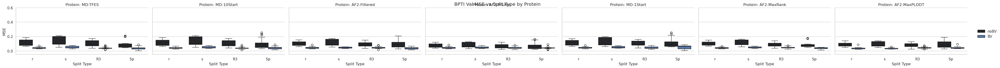

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming val_mse_BPTI_dfs is already filtered to include only 'Val' in "Type"
val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']
print(val_mse_dfs.mse.value_counts())
# Set the figure size and style if not already set globally
sns.set(style="whitegrid")

# Create a FacetGrid, mapping each 'protein' to a subplot
g = sns.FacetGrid(val_mse_dfs, row="protein", col="ensemble", height=3, aspect=2)
g.map_dataframe(sns.boxplot, x='split_type', y='mse', hue='bench', order=['r','s', 'R3', 'Sp'])

# Additional customizations
g.set_titles("Protein: {col_name}")  # Set titles for subplots
g.add_legend()  # Add legend
g.set_axis_labels("Split Type", "MSE")  # Set axis labels

# Adjust the y-axis limits uniformly across all facets
g.set(ylim=(-0.05, 0.6))

# Optional: Adjust the legend and titles
plt.subplots_adjust(top=0.9)  # Adjust subplots to provide space for the title
g.fig.suptitle('BPTI Val MSE vs Split Type by Protein')  # Set a super title for the grid

# Display the plot
plt.show()


In [23]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Assuming val_mse_BPTI_dfs is already filtered to include only 'Val' in "Type"
# val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']

# # remove mse less than 0
# val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]

# print(val_mse_dfs.mse.value_counts())
# # Set the figure size and style if not already set globally
# sns.set(style="whitegrid")

# # Create a FacetGrid, mapping each 'protein' to a subplot
# g = sns.FacetGrid(val_mse_dfs, row="protein", col="ensemble", height=3, aspect=1, sharey=True, sharex=False,row_order=protein_names, col_order=["af_rank1","Shaw_small"])
# g.map_dataframe(sns.boxplot, x='split_type', y='mse', hue='bench', order=[ 'R3', 'Sp'], palette='Set3')

# # Additional customizations
# g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
# g.add_legend()  # Add legend
# g.set_axis_labels("Split Type", "MSE")  # Set axis labels

# # Adjust the y-axis limits uniformly across all facets
# # g.set(ylim=(-0.05, 0.4))

# # Optional: Adjust the legend and titles
# plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# # g.fig.suptitle('BPTI Val MSE vs Split Type by Protein')  # Set a super title for the grid

# # Display the plot
# plt.show()


In [24]:
# import seaborn as sns
# import matplotlib.pyplot as plt
# # Assuming val_mse_dfs is already filtered to include only 'Val' in "Type"
# val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']
# # Remove mse less than 0
# val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]
# print(val_mse_dfs.mse.value_counts())
# # bench_val_mse_dfs = val_mse_dfs[val_mse_dfs['bench'] == 'BV']
# # Set the figure size and style if not already set globally
# sns.set(style="whitegrid")
# # Create a FacetGrid, mapping each 'protein' and 'split_type' to a subplot
# _val_mse_dfs = val_mse_dfs[val_mse_dfs['ensemble'] != 'Shaw_small']
# g = sns.FacetGrid(_val_mse_dfs, row="protein", col="replicate", height=3, aspect=1.5, sharey=False, row_order=protein_names)#, col_order=['r','s', 'R3', 'Sp'])
# # Map the boxplot to the FacetGrid
# g.map_dataframe(sns.boxplot, x="split_type", y="mse", hue="bench", palette='Set1', order=['r','s', 'R3', 'Sp'])#, style='bench')
# # Additional customizations
# g.set_titles(row_template="Protein: {row_name}", col_template="Replicate: {col_name}")  # Set titles for subplots
# g.add_legend()  # Add legend
# g.set_axis_labels("Replicate", "MSE")  # Set axis labels
# # Adjust the y-axis limits uniformly across all facets
# # g.set(ylim=(-0.05, 0.4))
# # Optional: Adjust the legend and titles
# plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('Val MSE vs Dataset by Protein and Split Type')  # Set a super title for the grid
# # Display the plot
# plt.show()

In [25]:
# import seaborn as sns
# import matplotlib.pyplot as plt
# # Assuming val_mse_dfs is already filtered to include only 'Val' in "Type"
# val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']
# # Remove mse less than 0
# val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]
# _val_mse_dfs = val_mse_dfs[val_mse_dfs['ensemble'] != 'Shaw_small']

# print(val_mse_dfs.mse.value_counts())
# bench_val_mse_dfs = val_mse_dfs[_val_mse_dfs['bench'] == 'BV']
# # Set the figure size and style if not already set globally
# sns.set(style="whitegrid")

# # Create a FacetGrid, mapping each 'protein' and 'split_type' to a subplot
# g = sns.FacetGrid(bench_val_mse_dfs, row="protein", col="split_type", height=3, aspect=1.5, sharey=False, row_order=protein_names, col_order=['r','s', 'R3', 'Sp'])
# # Map the boxplot to the FacetGrid
# g.map_dataframe(sns.boxplot, x="replicate", y="mse", hue="replicate", palette='tab10')
# # Additional customizations
# g.set_titles(row_template="Protein: {row_name}", col_template="Split Type: {col_name}")  # Set titles for subplots
# g.add_legend()  # Add legend
# g.set_axis_labels("Replicate", "MSE")  # Set axis labels
# # Adjust the y-axis limits uniformly across all facets
# # g.set(ylim=(-0.05, 0.4))
# # Optional: Adjust the legend and titles
# plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('Val MSE vs Dataset by Protein and Split Type')  # Set a super title for the grid
# # Display the plot
# plt.show()

mse
0.090065    2
0.098964    1
0.043578    1
0.051085    1
0.063783    1
           ..
0.074733    1
0.073281    1
0.064713    1
0.052000    1
0.039121    1
Name: count, Length: 1119, dtype: int64


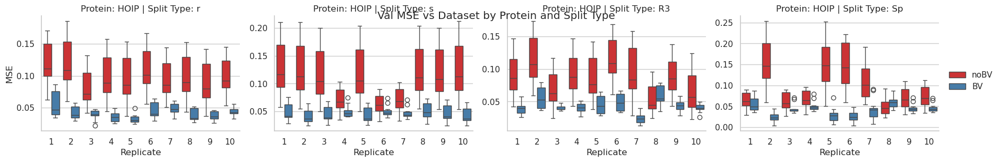

In [26]:
import seaborn as sns
import matplotlib.pyplot as plt
# Assuming val_mse_dfs is already filtered to include only 'Val' in "Type"
val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']
# Remove mse less than 0
val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]
print(val_mse_dfs.mse.value_counts())

_val_mse_dfs = val_mse_dfs[val_mse_dfs['ensemble'] != 'Shaw_small']
# bench_val_mse_dfs = _val_mse_dfs[_val_mse_dfs['bench'] == 'BV']

# Set the figure size and style if not already set globally
sns.set(style="whitegrid")
# Create a FacetGrid, mapping each 'protein' and 'split_type' to a subplot
g = sns.FacetGrid(val_mse_dfs, row="protein", col="split_type", height=3, aspect=1.5, sharey=False, row_order=protein_names, col_order=['r','s', 'R3', 'Sp'])
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="replicate", y="mse", hue="bench", palette='Set1')
# Additional customizations
g.set_titles(row_template="Protein: {row_name}", col_template="Split Type: {col_name}")  # Set titles for subplots
g.add_legend()  # Add legend
g.set_axis_labels("Replicate", "MSE")  # Set axis labels
# Adjust the y-axis limits uniformly across all facets
# g.set(ylim=(-0.05, 0.4))
# Optional: Adjust the legend and titles
plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
g.fig.suptitle('Val MSE vs Dataset by Protein and Split Type')  # Set a super title for the grid
# Display the plot
plt.show()

In [27]:
val_mse_dfs

,time,Type,R,calc_name,mse,name,system,analysis,split_type,protein,name_name,dataset,class,bench,method,fit,ensemble,split_name,replicate
51,0.5,Val,NaN,val_HOIP_MD_TFES_1,0.098964,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_val_HOI...,val,val_r,noBV,TFES,noBV,MD-TFES,Random,1
52,0.5,Val,NaN,val_HOIP_MD_TFES_2,0.094500,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_val_HOI...,val,val_r,noBV,TFES,noBV,MD-TFES,Random,2
53,0.5,Val,NaN,val_HOIP_MD_TFES_3,0.062370,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_val_HOI...,val,val_r,noBV,TFES,noBV,MD-TFES,Random,3
54,0.5,Val,NaN,val_HOIP_MD_TFES_4,0.076036,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_val_HOI...,val,val_r,noBV,TFES,noBV,MD-TFES,Random,4
55,0.5,Val,NaN,val_HOIP_MD_TFES_5,0.072931,HOIP_MD_TFES_noBV_bench_r_naive_random,HOIP_MD_TFES_noBV_bench_r_naive_random,noBV,r,HOIP,HOIP_MD_TFES_noBV_bench_r_naive_random_val_HOI...,val,val_r,noBV,TFES,noBV,MD-TFES,Random,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4587,5.0,Val,NaN,val_HOIP_MD_10Start_6,0.054825,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_val_HOI...,val,val_R3,BV,10Start,BV,MD-10Start,Non-Redundant,6
4588,5.0,Val,NaN,val_HOIP_MD_10Start_7,0.022645,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_val_HOI...,val,val_R3,BV,10Start,BV,MD-10Start,Non-Redundant,7
4589,5.0,Val,NaN,val_HOIP_MD_10Start_8,0.078312,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_val_HOI...,val,val_R3,BV,10Start,BV,MD-10Start,Non-Redundant,8
4590,5.0,Val,NaN,val_HOIP_MD_10Start_9,0.038367,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_val_HOI...,val,val_R3,BV,10Start,BV,MD-10Start,Non-Redundant,9


In [28]:
# import seaborn as sns
# import matplotlib.pyplot as plt
# # Assuming val_mse_dfs is already filtered to include only 'Val' in "Type"
# val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']
# # Remove mse less than 0
# val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]
# print(val_mse_dfs.mse.value_counts())

# # _val_mse_dfs = val_mse_dfs[val_mse_dfs['ensemble'] != 'Shaw_small']
# # bench_val_mse_dfs = _val_mse_dfs[_val_mse_dfs['bench'] == 'BV']

# for ensemble in val_mse_dfs.ensemble.unique():
#     print(ensemble)
#     ensemble_val_mse_dfs = val_mse_dfs[val_mse_dfs['ensemble'] == ensemble]
#     # Set the figure size and style if not already set globally
#     sns.set(style="whitegrid")
#     # Create a FacetGrid, mapping each 'protein' and 'split_type' to a subplot
#     g = sns.FacetGrid(ensemble_val_mse_dfs, row="protein", col="split_type", height=3, aspect=1.5, sharey=False, row_order=protein_names, col_order=['r','s', 'R3', 'Sp'])
#     # Map the boxplot to the FacetGrid
#     g.map_dataframe(sns.boxplot, x="replicate", y="mse", hue="bench", palette='Set1')
#     # Additional customizations
#     g.set_titles(row_template="Protein: {row_name}", col_template="Split Type: {col_name}")  # Set titles for subplots
#     g.add_legend()  # Add legend
#     g.set_axis_labels("Replicate", "MSE")  # Set axis labels
#     # Adjust the y-axis limits uniformly across all facets
#     # g.set(ylim=(-0.05, 0.4))
#     # Optional: Adjust the legend and titles
#     plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
#     g.fig.suptitle('Val MSE vs Dataset by Protein and Split Type')  # Set a super title for the grid
#     # Display the plot
#     plt.show()

In [29]:
# bench_val_mse_dfs.ensemble.unique()

In [30]:
# # drop not val in "Type"
# val_mse_BPTI_dfs = mse_BPTI_dfs[mse_BPTI_dfs['Type'] == 'Val']

# plt.figure(figsize=(10, 6))

# x_order = ['r','s', 'R3', 'Sp']

# sns.boxplot(x='split_type', y='mse', hue='bench', data=val_mse_BPTI_dfs, order=x_order)

# plt.title('BPTI Val MSE vs split type')
# plt.ylim(0, 0.4)
# plt.show()

In [31]:
# # BV_constants_df["bench"].value_counts() 
# BV_constants_df

['MD-TFES' 'MD-10Start' 'AF2-Filtered' 'AF2-MSAss' 'MD-1Start'
 'AF2-MaxRank' 'AF2-MaxPLDDT']
7
ensemble
MD-TFES         88
MD-10Start      88
AF2-Filtered    88
AF2-MSAss       88
MD-1Start       88
AF2-MaxRank     88
AF2-MaxPLDDT    88
Name: count, dtype: int64


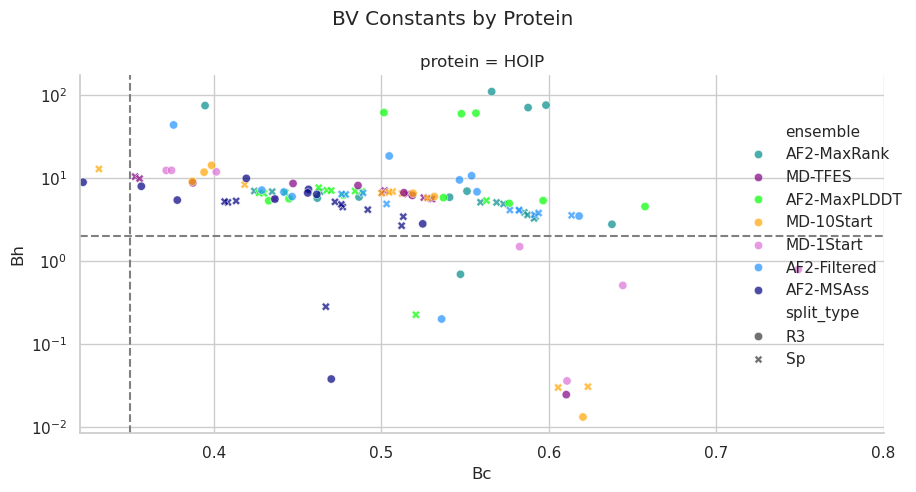

In [32]:

import seaborn as sns
import matplotlib.pyplot as plt
BV_constants_df = pkl_list["BV_constants"]

BV_constants_df = transform_naming(BV_constants_df)
print(BV_constants_df.ensemble.unique())
print(len(BV_constants_df.ensemble.unique()))
print(BV_constants_df.ensemble.value_counts())



# select only the BV constants from bench
BV_constants_df = BV_constants_df[BV_constants_df['bench'] == 'BV']
BV_constants_df = BV_constants_df[BV_constants_df['dataset'] != 'prior']
BV_constants_df = BV_constants_df[BV_constants_df['ensemble'] != 'Shaw_small']
# select R3 and Sp
BV_constants_df = BV_constants_df[BV_constants_df['split_type'].isin(['R3', 'Sp'])]
# Set up a FacetGrid to create a grid of scatter plots
g = sns.FacetGrid(BV_constants_df, row="protein",  height=5, aspect=1.5, sharey=True)
g.map_dataframe(sns.scatterplot, x='Bc', y='Bh', hue='ensemble', alpha=0.7, style='split_type', palette=full_dataset_colours)
# Draw the _BV constants lines on each subplot
_Bc = 0.35
_Bh = 2.0

# Define a helper function to draw lines across facets
def add_lines(**kwargs):
    plt.axvline(x=_Bc, color='grey', linestyle='--')
    plt.axhline(y=_Bh, color='grey', linestyle='--')

g.map(add_lines)

# Adjust the axes limits uniformly
g.set(xlim=(0.32, 0.8))

# Additional customizations
g.add_legend()  # Add a legend to the plot
g.set_axis_labels("Bc", "Bh")  # Set axis labels
# g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
g.set(yscale='log')  # Set the y-axis to log scale
# Optional: Adjust the layout and title
g.fig.suptitle('BV Constants by Protein')  # Set a super title for the grid

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
 
plt.tight_layout()


# Show the plot
plt.show()


In [33]:

# # Set up a FacetGrid to create a grid of scatter plots
# g = sns.FacetGrid(BV_constants_df, row="protein", col="ensemble", height=4, aspect=1, row_order=["HOIP"], sharey=True)
# g.map_dataframe(sns.scatterplot, x='Bc', y='Bh', hue='split_type', alpha=0.7)

# # Draw the _BV constants lines on each subplot
# _Bc = 0.35
# _Bh = 2.0

# # Define a helper function to draw lines across facets
# def add_lines(**kwargs):
#     plt.axvline(x=_Bc, color='grey', linestyle='--')
#     plt.axhline(y=_Bh, color='grey', linestyle='--')

# g.map(add_lines)

# # Adjust the axes limits uniformly
# g.set(xlim=(0, 0.7))

# # Additional customizations
# g.add_legend()  # Add a legend to the plot
# g.set_axis_labels("Bc", "Bh")  # Set axis labels
# g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
# g.set(yscale='log')  # Set the y-axis to log scale
# # Optional: Adjust the layout and title
# # plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# # g.fig.suptitle('BV Constants by Protein')  # Set a super title for the grid

# # Show the plot
# plt.show()

In [34]:
BV_constants_df

,Bc,Bh,calc_name,name,system,analysis,split_type,protein,name_name,dataset,class,bench,method,fit,ensemble,split_name,replicate
320,0.565898,109.089639,train_HOIP_high_rank_1,HOIP_high_rank_BV_bench_R3_k_sequence,HOIP_high_rank_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_high_rank_BV_bench_R3_k_sequence_train_HO...,train,train_R3,BV,rank,BV,AF2-MaxRank,Non-Redundant,1
321,0.547251,0.687261,train_HOIP_high_rank_2,HOIP_high_rank_BV_bench_R3_k_sequence,HOIP_high_rank_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_high_rank_BV_bench_R3_k_sequence_train_HO...,train,train_R3,BV,rank,BV,AF2-MaxRank,Non-Redundant,2
322,0.637742,2.751577,train_HOIP_high_rank_3,HOIP_high_rank_BV_bench_R3_k_sequence,HOIP_high_rank_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_high_rank_BV_bench_R3_k_sequence_train_HO...,train,train_R3,BV,rank,BV,AF2-MaxRank,Non-Redundant,3
323,0.598339,74.991496,train_HOIP_high_rank_4,HOIP_high_rank_BV_bench_R3_k_sequence,HOIP_high_rank_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_high_rank_BV_bench_R3_k_sequence_train_HO...,train,train_R3,BV,rank,BV,AF2-MaxRank,Non-Redundant,4
324,0.486663,5.868747,train_HOIP_high_rank_5,HOIP_high_rank_BV_bench_R3_k_sequence,HOIP_high_rank_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_high_rank_BV_bench_R3_k_sequence_train_HO...,train,train_R3,BV,rank,BV,AF2-MaxRank,Non-Redundant,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
611,0.387067,9.052010,train_HOIP_MD_10Start_6,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_train_H...,train,train_R3,BV,10Start,BV,MD-10Start,Non-Redundant,6
612,0.266941,15.626601,train_HOIP_MD_10Start_7,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_train_H...,train,train_R3,BV,10Start,BV,MD-10Start,Non-Redundant,7
613,0.303405,15.000136,train_HOIP_MD_10Start_8,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_train_H...,train,train_R3,BV,10Start,BV,MD-10Start,Non-Redundant,8
614,0.518937,6.509287,train_HOIP_MD_10Start_9,HOIP_MD_10Start_BV_bench_R3_k_sequence,HOIP_MD_10Start_BV_bench_R3_k_sequence,BV,R3,HOIP,HOIP_MD_10Start_BV_bench_R3_k_sequence_train_H...,train,train_R3,BV,10Start,BV,MD-10Start,Non-Redundant,9


In [35]:
BV_constants_df.Bh.value_counts()

Bh
109.089639    1
7.895690      1
9.831264      1
0.037635      1
2.786516      1
             ..
6.824789      1
4.499492      1
59.041356     1
5.757167      1
17.357863     1
Name: count, Length: 140, dtype: int64

In [36]:
# # plot BV constants as a scatter graph coloured by split type
# BPTI_BV_constants_df = BPTI_pkl_merged["BV_constants"]
# plt.figure(figsize=(10, 6))
# _Bc = 0.35
# _Bh = 2.0

# sns.scatterplot(x='Bc', y='Bh', hue='split_type', data=BPTI_BV_constants_df, alpha=0.5)

# # plot the _BV constants as dashed lines

# plt.axvline(x=_Bc, color='grey', linestyle='--')

# plt.axhline(y=_Bh, color='grey', linestyle='--')

# plt.title('BPTI BV constants')


# plt.ylim(-0.2, 12)
# plt.xlim(0, 1)

# plt.show()

In [37]:
from scipy.optimize import minimize
from sklearn.linear_model import LinearRegression


In [38]:
# # plot BV constants as a scatter graph coloured by split type
# # BPTI_BV_constants_df = BPTI_pkl_merged["BV_/constants"]
# plt.figure(figsize=(10, 6))
# _Bc = 0.35
# _Bh = 2.0

# inverse_x = np.linspace(0, 0.7, 100)
# inverse_y = [4-(2*i/0.35) for i in inverse_x]

# plt.plot(inverse_x, inverse_y, color='red', linestyle='--')

# # Constants
# x0, y0 = 0.35, 2

# # Adjust data

# selected_proteins = BV_constants_df[BV_constants_df['protein'].isin(['BPTI', 'MBP', 'LXR'])]

# adjusted_x = selected_proteins['Bc'].to_numpy() 
# adjusted_y = selected_proteins['Bh'].to_numpy() 

# # Prepare for linear regression
# model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # The slope of the best fit line
# m = model.coef_[0]
# c = model.intercept_
# print(f"Slope of the best fit line: {m}")

# # Calculate the line points for plotting
# x_vals = np.linspace(0, 0.7, 100)
# y_vals = (m * x_vals) + c

# # Plot the best fit line
# plt.plot(x_vals, y_vals, color='Blue', linestyle='--')

# selected_proteins = BV_constants_df[BV_constants_df['protein'].isin(['BRD4', 'HOIP'])]

# adjusted_x = selected_proteins['Bc'].to_numpy() 
# adjusted_y = selected_proteins['Bh'].to_numpy() 

# # Prepare for linear regression
# model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # The slope of the best fit line
# m = model.coef_[0]
# c = model.intercept_
# print(f"Slope of the best fit line: {m}")

# # Calculate the line points for plotting
# x_vals = np.linspace(0, 0.7, 100)
# y_vals = (m * x_vals) + c

# # Plot the best fit line
# plt.plot(x_vals, y_vals, color='Green', linestyle='--')



# adjusted_x = BV_constants_df['Bc'].to_numpy() 
# adjusted_y = BV_constants_df['Bh'].to_numpy() 

# # Prepare for linear regression
# model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # The slope of the best fit line
# m = model.coef_[0]
# c = model.intercept_
# print(f"Slope of the best fit line: {m}")

# # Calculate the line points for plotting
# x_vals = np.linspace(0, 0.7, 100)
# y_vals = (m * x_vals) + c

# # Plot the best fit line
# plt.plot(x_vals, y_vals, color='Purple', linestyle='--')



# x0, y0 = 0.35, 2

# # Adjust data
# adjusted_x = BV_constants_df['Bc'] - x0
# adjusted_y = BV_constants_df['Bh'] - y0

# # Prepare for linear regression
# model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# model.fit(adjusted_x.values.reshape(-1, 1), adjusted_y.values)

# # The slope of the best fit line
# m = model.coef_[0]
# print(f"Slope of the best fit line: {m}")

# # Calculate the line points for plotting
# x_vals = np.linspace(0, 0.7, 100)
# y_vals = m * (x_vals - x0) + y0

# # Plot the best fit line
# plt.plot(x_vals, y_vals, color='Brown', linestyle='--')



# x0, y0 = 0.35, 2

# # Adjust data
# selected_proteins = BV_constants_df[BV_constants_df['protein'].isin(['BPTI', 'MBP', 'LXR'])]

# adjusted_x = selected_proteins['Bc'].to_numpy() 
# adjusted_y = selected_proteins['Bh'].to_numpy() 

# # Prepare for linear regression
# model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # The slope of the best fit line
# m = model.coef_[0]
# print(f"Slope of the best fit line: {m}")

# # Calculate the line points for plotting
# x_vals = np.linspace(0, 0.7, 100)
# y_vals = m * (x_vals - x0) + y0

# # Plot the best fit line
# plt.plot(x_vals, y_vals, color='Cyan', linestyle='--')


# # Adjust data
# selected_proteins = BV_constants_df[BV_constants_df['protein'].isin(['HOIP', 'BRD4'])]

# adjusted_x = selected_proteins['Bc'].to_numpy() 
# adjusted_y = selected_proteins['Bh'].to_numpy() 

# # Prepare for linear regression
# model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # The slope of the best fit line
# m = model.coef_[0]
# print(f"Slope of the best fit line: {m}")

# # Calculate the line points for plotting
# x_vals = np.linspace(0, 0.7, 100)
# y_vals = m * (x_vals - x0) + y0

# # Plot the best fit line
# plt.plot(x_vals, y_vals, color='Teal', linestyle='--')



# sns.scatterplot(x='Bc', y='Bh', hue='protein', data=BV_constants_df, alpha=0.7)

# # plot the _BV constants as dashed lines

# plt.axvline(x=_Bc, color='grey', linestyle='--')

# plt.axhline(y=_Bh, color='grey', linestyle='--')

# plt.title('BV constants by Protein')


# plt.ylim(-0.2, 12)
# plt.xlim(0, 0.7)


# plt.show()

In [39]:
# # plot BV constants as a scatter graph coloured by split type
# # BPTI_BV_constants_df = BPTI_pkl_merged["BV_/constants"]
# plt.figure(figsize=(10, 6))
# _Bc = 0.35
# _Bh = 2.0

# # inverse_x = np.linspace(0, 0.7, 100)
# # inverse_y = [4-(2*i/0.35) for i in inverse_x]

# # plt.plot(inverse_x, inverse_y, color='red', linestyle='--')

# # # Constants
# # x0, y0 = 0.35, 2

# # # Adjust data

# # selected_proteins = normalised_BV_constants_df[normalised_BV_constants_df['protein'].isin(['BPTI', 'MBP', 'LXR'])]

# # adjusted_x = selected_proteins['Bc'].to_numpy() 
# # adjusted_y = selected_proteins['Bh'].to_numpy() 

# # # Prepare for linear regression
# # model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# # model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # # The slope of the best fit line
# # m = model.coef_[0]
# # c = model.intercept_
# # print(f"Slope of the best fit line: {m}")

# # # Calculate the line points for plotting
# # x_vals = np.linspace(0, 0.7, 100)
# # y_vals = (m * x_vals) + c

# # # Plot the best fit line
# # plt.plot(x_vals, y_vals, color='Blue', linestyle='--')

# # selected_proteins = normalised_BV_constants_df[normalised_BV_constants_df['protein'].isin(['BRD4', 'HOIP'])]

# # adjusted_x = selected_proteins['Bc'].to_numpy() 
# # adjusted_y = selected_proteins['Bh'].to_numpy() 

# # # Prepare for linear regression
# # model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# # model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # # The slope of the best fit line
# # m = model.coef_[0]
# # c = model.intercept_
# # print(f"Slope of the best fit line: {m}")

# # # Calculate the line points for plotting
# # x_vals = np.linspace(0, 0.7, 100)
# # y_vals = (m * x_vals) + c

# # # Plot the best fit line
# # plt.plot(x_vals, y_vals, color='Green', linestyle='--')



# # adjusted_x = BV_constants_df['Bc'].to_numpy() 
# # adjusted_y = BV_constants_df['Bh'].to_numpy() 

# # # Prepare for linear regression
# # model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# # model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # # The slope of the best fit line
# # m = model.coef_[0]
# # c = model.intercept_
# # print(f"Slope of the best fit line: {m}")

# # # Calculate the line points for plotting
# # x_vals = np.linspace(0, 0.7, 100)
# # y_vals = (m * x_vals) + c

# # # Plot the best fit line
# # plt.plot(x_vals, y_vals, color='Purple', linestyle='--')



# # x0, y0 = 0.35, 2

# # # Adjust data
# # adjusted_x = BV_constants_df['Bc'] - x0
# # adjusted_y = BV_constants_df['Bh'] - y0

# # # Prepare for linear regression
# # model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# # model.fit(adjusted_x.values.reshape(-1, 1), adjusted_y.values)

# # # The slope of the best fit line
# # m = model.coef_[0]
# # print(f"Slope of the best fit line: {m}")

# # # Calculate the line points for plotting
# # x_vals = np.linspace(0, 0.7, 100)
# # y_vals = m * (x_vals - x0) + y0

# # # Plot the best fit line
# # plt.plot(x_vals, y_vals, color='Brown', linestyle='--')



# # x0, y0 = 0.35, 2

# # # Adjust data
# # selected_proteins = normalised_BV_constants_df[normalised_BV_constants_df['protein'].isin(['BPTI', 'MBP', 'LXR'])]

# # adjusted_x = selected_proteins['Bc'].to_numpy() 
# # adjusted_y = selected_proteins['Bh'].to_numpy() 

# # # Prepare for linear regression
# # model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# # model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # # The slope of the best fit line
# # m = model.coef_[0]
# # print(f"Slope of the best fit line: {m}")

# # # Calculate the line points for plotting
# # x_vals = np.linspace(0, 0.7, 100)
# # y_vals = m * (x_vals - x0) + y0

# # # Plot the best fit line
# # plt.plot(x_vals, y_vals, color='Cyan', linestyle='--')


# # # Adjust data
# # selected_proteins = normalised_BV_constants_df[normalised_BV_constants_df['protein'].isin(['HOIP', 'BRD4'])]

# # adjusted_x = selected_proteins['Bc'].to_numpy() 
# # adjusted_y = selected_proteins['Bh'].to_numpy() 

# # # Prepare for linear regression
# # model = LinearRegression(fit_intercept=True)  # No intercept, line through origin
# # model.fit(adjusted_x.reshape(-1, 1), adjusted_y)

# # # The slope of the best fit line
# # m = model.coef_[0]
# # print(f"Slope of the best fit line: {m}")

# # # Calculate the line points for plotting
# # x_vals = np.linspace(0, 0.7, 100)
# # y_vals = m * (x_vals - x0) + y0

# # # Plot the best fit line
# # plt.plot(x_vals, y_vals, color='Teal', linestyle='--')



# sns.scatterplot(x='Bc', y='Bh', hue='protein', data=normalised_BV_constants_df, alpha=0.7)

# # plot the _BV constants as dashed lines

# plt.axvline(x=1, color='grey', linestyle='--')

# plt.axhline(y=1, color='grey', linestyle='--')

# plt.title('BV constants by Protein')


# plt.ylim(-0.2, 6)
# # plt.xlim(0, 0.7)

# # plt.yscale('log')
# plt.show()

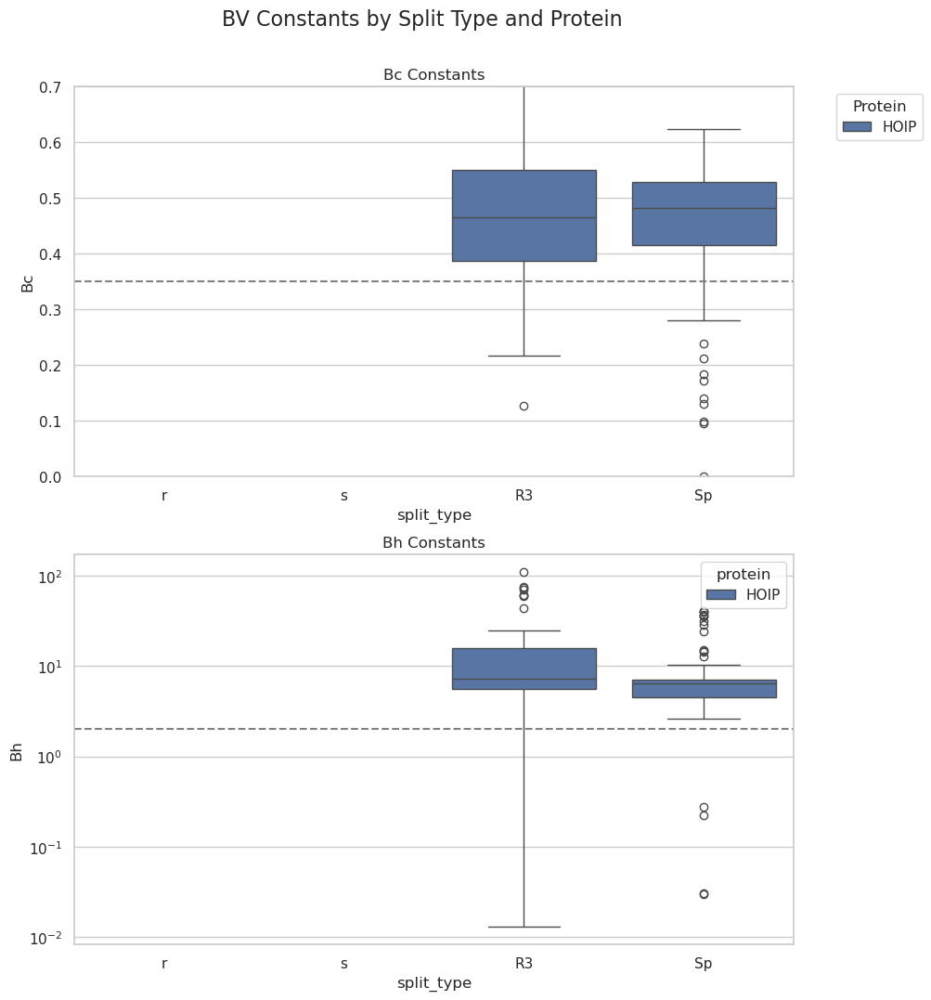

In [40]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming BV_constants_df is already loaded with appropriate data
x_order = ['r', 's', 'R3', 'Sp']

plt.figure(figsize=(10, 12))  # Increase figure size for better readability
plt.suptitle('BV Constants by Split Type and Protein', fontsize=16, y=0.95)  # Add a main title and adjust its position

# Plot for Bc
plt.subplot(2, 1, 1)
sns.boxplot(x='split_type', y='Bc', hue='protein', data=BV_constants_df, order=x_order)
plt.axhline(y=_Bc, color='grey', linestyle='--')
plt.title('Bc Constants')  # Add a title for the first subplot
plt.ylim(0, 0.7)  # Set y-axis limits based on your data range
plt.ylabel('Bc')  # Label y-axis
plt.legend(title='Protein', bbox_to_anchor=(1.05, 1), loc='upper left')  # Adjust legend position outside the plot

# Plot for Bh
plt.subplot(2, 1, 2)
sns.boxplot(x='split_type', y='Bh', hue='protein', data=BV_constants_df, order=x_order)
plt.axhline(y=_Bh, color='grey', linestyle='--')
plt.title('Bh Constants')  # Add a title for the second subplot
# plt.ylim(-0.2, 12)  # Set y-axis limits based on your data range
plt.ylabel('Bh')  # Label y-axis
plt.yscale('log')  # Use log scale for better visualization
# plt.tight_layout()  # Automatically adjust subplot parameters to give specified padding and avoid overlap

# Show the plot
plt.show()


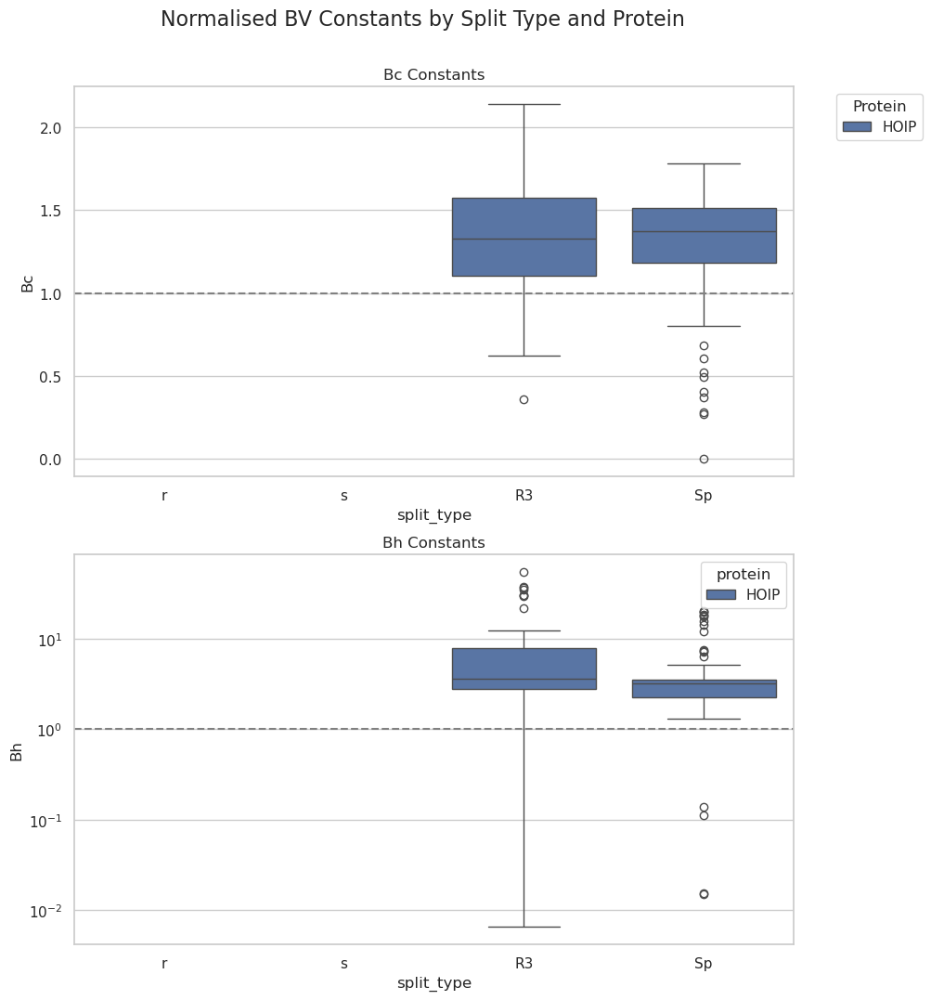

In [41]:
import matplotlib.pyplot as plt
import seaborn as sns
normalised_BV_constants_df = BV_constants_df.copy()
normalised_BV_constants_df["Bc"] = normalised_BV_constants_df["Bc"].values / _Bc
normalised_BV_constants_df["Bh"] = normalised_BV_constants_df["Bh"].values / _Bh

# Assuming BV_constants_df is already loaded with appropriate data
x_order = ['r', 's', 'R3', 'Sp']

plt.figure(figsize=(10, 12))  # Increase figure size for better readability
plt.suptitle('Normalised BV Constants by Split Type and Protein', fontsize=16, y=0.95)  # Add a main title and adjust its position

# Plot for Bc
plt.subplot(2, 1, 1)
sns.boxplot(x='split_type', y='Bc', hue='protein', data=normalised_BV_constants_df, order=x_order)
plt.axhline(y=1, color='grey', linestyle='--')
plt.title('Bc Constants')  # Add a title for the first subplot
# plt.ylim(0, 0.7)  # Set y-axis limits based on your data range
plt.ylabel('Bc')  # Label y-axis
plt.legend(title='Protein', bbox_to_anchor=(1.05, 1), loc='upper left')  # Adjust legend position outside the plot

# Plot for Bh
plt.subplot(2, 1, 2)
sns.boxplot(x='split_type', y='Bh', hue='protein', data=normalised_BV_constants_df, order=x_order)
plt.axhline(y=1, color='grey', linestyle='--')
plt.title('Bh Constants')  # Add a title for the second subplot
# plt.ylim(-0.2, 12)  # Set y-axis limits based on your data range
plt.ylabel('Bh')  # Label y-axis
plt.yscale('log')  # Use log scale for better visualization
# plt.tight_layout()  # Automatically adjust subplot parameters to give specified padding and avoid overlap

# Show the plot
plt.show()


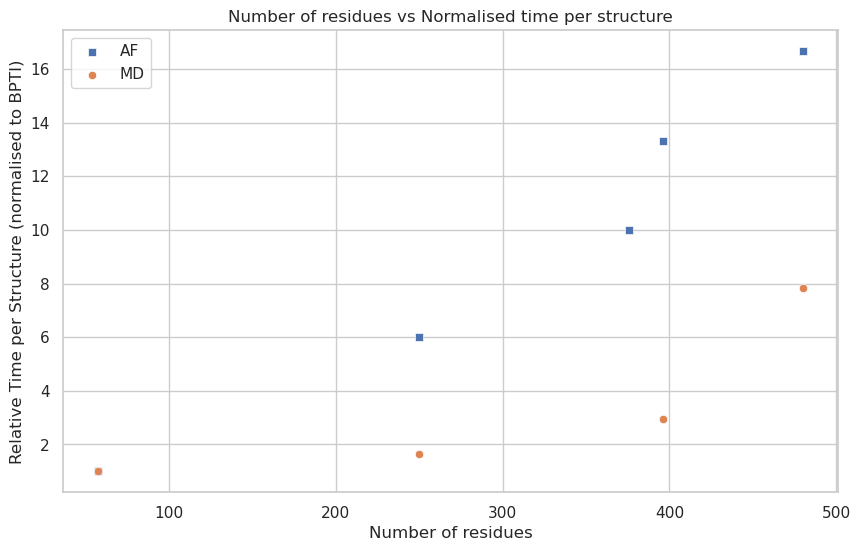

In [42]:
protein_names = ["BPTI", "HOIP", "BRD4", "LXR", "MBP"]
num_res = np.array([58, 376, 480, 250, 396])
time_per_af = np.array([1.5, 15, 25, 9, 20])
time_per_af = time_per_af / time_per_af[0]
md_protein_names = ["BPTI","BRD4","LXR", "MBP"]
md_num_res = np.array([58, 480, 250, 396])
ns_per_day = np.array([234.8, 30, 141.9, 80])
ns_per_day = ns_per_day / ns_per_day[0]
day_per_ns = 1/ns_per_day
plt.figure(figsize=(10, 6))

sns.scatterplot(x=num_res, y=time_per_af,  marker='s', label='AF')
sns.scatterplot(x=md_num_res, y=day_per_ns,  marker='o', label='MD')

plt.title('Number of residues vs Normalised time per structure')
plt.xlabel('Number of residues')
plt.ylabel('Relative Time per Structure (normalised to BPTI)')

plt.show()

In [43]:
# protein_names = ["BPTI", "HOIP", "BRD4", "LXRa", "MBP"]
# num_res = np.array([58, 376, 480, 250, 396])
# time_per_af = np.array([1.5, 15, 25, 9, 20])
# time_per_af = time_per_af / time_per_af[0]
# md_protein_names = ["BPTI","BRD4","LXR", "MBP"]
# md_num_res = np.array([58, 480, 250, 396])
# ns_per_day = np.array([234.8, 30, 141.9, 80])
# ns_per_day = ns_per_day / ns_per_day[0]
# day_per_ns = 1/ns_per_day
# plt.figure(figsize=(10, 6))

# sns.lineplot(x=num_res, y=time_per_af,  marker='s', label='AF')
# sns.lineplot(x=md_num_res, y=day_per_ns,  marker='o', label='MD')


# plt.title('Number of residues vs normalised time per structure')
# plt.xlabel('Number of residues')
# plt.ylabel('Time per Structure /s')

# plt.show()

In [44]:
protein_names = ["BPTI", "HOIP", "BRD4", "LXRa", "MBP"]


In [45]:
weights = pkl_list["weights"]


weights["protein"] = weights["name"].apply(lambda x: x.split("_")[0])
# log_PFs["method"] = log_PFs["name"].apply(lambda x: x.split("_")[3])
weights["replicate"] = weights["calc_name"].apply(lambda x: x.split("_")[-1])

weights["method"] = weights["name"].apply(lambda x: x.split("_")[2])

# if 400 add shaw to the front
weights["ensemble"] = weights["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)

# if top or bottom in name add "500" to the end
weights["ensemble"] = weights["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)

# if dirty, clean or conf in name add af_ to the front
weights["ensemble"] = weights["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)
print(weights.ensemble.unique())
print(len(weights.ensemble.unique()))
print(weights.ensemble.value_counts())

['TFES' '10Start' 'Cleaned' 'MSAss' '1Start' 'rank' 'plddt']
7
ensemble
TFES       168
10Start    168
Cleaned    168
MSAss      168
1Start     168
rank       168
plddt      168
Name: count, dtype: int64


In [46]:
features = pkl_list["features"]

BV_constants = pkl_list["BV_constants"]
 
log_PF_df = pkl_list["LogPfs"]

log_PF_df.dataset.unique()

array(['prior', 'val', 'test'], dtype=object)

In [47]:
# import numpy as np
# import pandas as pd
# log_PF_df = pkl_list["LogPfs"]

# def calc_pmf(logPfs: pd.DataFrame, R=8.31, T=300):
#     """
#     Calculates the ensemble-average conformational enthalpy and entropy at each residue position using the logPFs.
#     Returns a tuple of two dataframes: (result_df, ensemble_df)
#     """
#     logPfs = logPfs.copy()
#     logPfs["rep"] = logPfs["calc_name"].apply(lambda x: x.split("_")[-1])
#     logPfs["system_name"] = logPfs["system"] + "_" + logPfs["rep"]
#     logPfs = logPfs[logPfs["dataset"] != "val"]
    
#     systems = logPfs.system_name.unique()
    
#     dfs = []
#     ensemble_data = []
    
#     for system in systems:
#         system_df = logPfs[logPfs["system_name"] == system]
#         prior = system_df[system_df["dataset"] == "prior"]
#         # standardeviation of the pfs
#         system_df["bar_beta_star"] = system_df.groupby("calc_name")["LogPf"].transform("std")/(R*T)

#         system_df["avg_logPF"] = system_df.groupby("calc_name")["LogPf"].transform("mean")
#         system_df["log_delta_PFi"] = np.abs(system_df["LogPf"] - system_df["avg_logPF"])
#         system_df["H_opt"] = -R * T * system_df["log_delta_PFi"]
        
#         prior = system_df[system_df["dataset"] == "prior"]
#         prior_enthalpy = prior["H_opt"].values
#         prior_residues = prior["Residues"].values
#         system_residues = system_df["Residues"].values
        
#         enthalpy_diff = np.abs(system_df["H_opt"].values[:, np.newaxis] - prior_enthalpy)
#         residue_mask = system_residues[:, np.newaxis] == prior_residues
#         system_df["delta_H_opt"] = np.where(residue_mask, enthalpy_diff, 0).max(axis=1)
#         system_df["delta_H_kj"] = system_df["delta_H_opt"] / 1000
#         system_df["Pi_opt"] = (1/R*T*2*np.pi*system_df["bar_beta_star"])*np.exp(system_df["log_delta_PFi"])


#         # # normalise the probabilities
#         # for dataset in system_df.dataset.unique():
#         #     dataset_df = system_df[system_df["dataset"] == dataset]
#         #     dataset_df["Pi"] = dataset_df["Pi"] / dataset_df["Pi"].sum()

#         system_df["S_opt"] = R * system_df["Pi_opt"] * np.log(system_df["Pi_opt"])
#         prior = system_df[system_df["dataset"] == "prior"]
#         prior_entropy = prior["S_opt"].values
#         entropy_diff = np.abs(system_df["S_opt"].values[:, np.newaxis] - prior_entropy)
#         system_df["delta_S_opt"] = -np.where(residue_mask, entropy_diff, 0).max(axis=1)
    

#         system_df["delta_S_k"] = system_df["delta_S_opt"] / 1000
#         system_df["Tdelta_S"] = T * system_df["delta_S_opt"]
#         system_df["Tdelta_S_kj"] = system_df["Tdelta_S"] / 1000
        
#         system_df["delta_G_opt"] = system_df["delta_H_opt"] - T * system_df["delta_S_opt"]
#         system_df["delta_G_kj"] = system_df["delta_G_opt"] / 1000
        
#         dfs.append(system_df)

#         test_df = system_df[system_df["dataset"] == "test"]

#         # Calculate ensemble averages for the current system
#         ensemble_metrics = {
#             'dataset': 'test',
#             'name': test_df['name'].iloc[0],
#             'system': test_df['system'].iloc[0],
#             'system_name': test_df,
#             'calc_name': test_df['calc_name'].iloc[0],
#             'avg_delta_H': test_df['delta_H_opt'].mean(),
#             'avg_delta_H_kj': test_df['delta_H_kj'].mean(),
#             'avg_delta_S': test_df['delta_S_opt'].mean(),
#             'avg_delta_S_k': test_df['delta_S_k'].mean(),
#             'avg_Tdelta_S': test_df['Tdelta_S'].mean(),
#             'avg_Tdelta_S_kj': test_df['Tdelta_S_kj'].mean(),
#             'avg_delta_G': test_df['delta_G_opt'].mean(),
#             'avg_delta_G_kj': test_df['delta_G_kj'].mean(),
#             '-avg_delta_S_k': -test_df['delta_S_k'].mean(),

#         }

#         # calculate likelihood from avg_delta_G
#         ensemble_metrics['likelihood_opt'] = np.exp(-ensemble_metrics['avg_delta_G_kj'] / (R * T))

#         ensemble_data.append(ensemble_metrics)

    
#     result_df = pd.concat(dfs, ignore_index=True)
#     ensemble_df = pd.DataFrame(ensemble_data)
    
#     return result_df, ensemble_df

#         # Usage
# pmf_df, ensemble_pmf_df = calc_pmf(log_PF_df)

# # Further processing


# pmf_df["protein"] = pmf_df["name"].apply(lambda x: x.split("_")[0])
# pmf_df["replicate"] = pmf_df["calc_name"].apply(lambda x: x.split("_")[-1])
# pmf_df["method"] = pmf_df["name"].apply(lambda x: x.split("_")[2])

# pmf_df["ensemble"] = pmf_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)
# pmf_df["ensemble"] = pmf_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)
# pmf_df["ensemble"] = pmf_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)


# print(pmf_df.head())


# ensemble_pmf_df["protein"] = ensemble_pmf_df["name"].apply(lambda x: x.split("_")[0])
# ensemble_pmf_df["replicate"] = ensemble_pmf_df["calc_name"].apply(lambda x: x.split("_")[-1])
# ensemble_pmf_df["method"] = ensemble_pmf_df["name"].apply(lambda x: x.split("_")[2])

# ensemble_pmf_df["ensemble"] = ensemble_pmf_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)
# ensemble_pmf_df["ensemble"] = ensemble_pmf_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)
# ensemble_pmf_df["ensemble"] = ensemble_pmf_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)

# ensemble_pmf_df["split_type"] = ensemble_pmf_df["name"].apply(lambda x: x.split("_")[-3])
# ensemble_pmf_df["analysis"] = ensemble_pmf_df["name"].apply(lambda x: x.split("_")[3])

# print(pmf_df.head())
# print(ensemble_pmf_df.head())




In [48]:
log_PF_df = pkl_list["LogPfs"]
log_PF_df.calc_name.unique()

array(['prior_HOIP_MD_TFES_1', 'val_HOIP_MD_TFES_1',
       'test_HOIP_MD_TFES_1', 'prior_HOIP_MD_TFES_2',
       'val_HOIP_MD_TFES_2', 'test_HOIP_MD_TFES_2',
       'prior_HOIP_MD_TFES_3', 'val_HOIP_MD_TFES_3',
       'test_HOIP_MD_TFES_3', 'prior_HOIP_MD_TFES_4',
       'val_HOIP_MD_TFES_4', 'test_HOIP_MD_TFES_4',
       'prior_HOIP_MD_TFES_5', 'val_HOIP_MD_TFES_5',
       'test_HOIP_MD_TFES_5', 'prior_HOIP_MD_TFES_6',
       'val_HOIP_MD_TFES_6', 'test_HOIP_MD_TFES_6',
       'prior_HOIP_MD_TFES_7', 'val_HOIP_MD_TFES_7',
       'test_HOIP_MD_TFES_7', 'prior_HOIP_MD_TFES_8',
       'val_HOIP_MD_TFES_8', 'test_HOIP_MD_TFES_8',
       'prior_HOIP_MD_TFES_9', 'val_HOIP_MD_TFES_9',
       'test_HOIP_MD_TFES_9', 'prior_HOIP_MD_TFES_10',
       'val_HOIP_MD_TFES_10', 'test_HOIP_MD_TFES_10',
       'prior_HOIP_MD_10Start_1', 'val_HOIP_MD_10Start_1',
       'test_HOIP_MD_10Start_1', 'prior_HOIP_MD_10Start_2',
       'val_HOIP_MD_10Start_2', 'test_HOIP_MD_10Start_2',
       'prior_HOIP_MD_10S

In [49]:
import numpy as np
import pandas as pd
log_PF_df = pkl_list["LogPfs"]


def calc_pmf(logPfs: pd.DataFrame, R=8.31, T=300):
    """
    Calculates ensemble-average conformational and optimization thermodynamic quantities at each residue position.
    Returns a tuple of two dataframes: (result_df, ensemble_df)
    
    Calculates:
    - Optimization metrics (opt): Total changes during optimization
    - Conformational metrics (conf): Changes in conformational dynamics at fixed interaction strength
    """
    logPfs = logPfs.copy()
    logPfs["rep"] = logPfs["calc_name"].apply(lambda x: x.split("_")[-1])
    logPfs["system_name"] = logPfs["system"] + "_" + logPfs["rep"]
    logPfs = logPfs[logPfs["dataset"] != "val"]
    
    systems = logPfs.system_name.unique()
    dfs = []
    ensemble_data = []
    
    for system in systems:
        # Get data for this system
        system_df = logPfs[logPfs["system_name"] == system].copy()
        
        # Calculate initial metrics for all data points
        system_df["beta_star"] = system_df.groupby("calc_name")["LogPf"].transform("std")/(R*T)
        system_df["avg_logPF"] = system_df.groupby("calc_name")["LogPf"].transform("mean")
        system_df["log_delta_PFi"] = np.abs(system_df["LogPf"] - system_df["avg_logPF"])
        system_df["N_quanta"] = system_df["log_delta_PFi"] / system_df["beta_star"]
        
        # Get prior data after calculating initial metrics
        prior_df = system_df[system_df["dataset"] == "prior"].copy()


        # Calculate delta metrics using prior data
        system_df["delta_beta_star"] = system_df["beta_star"] - prior_df["beta_star"].iloc[0]
        system_df["delta_avg_logPF"] = np.abs(system_df["avg_logPF"] - prior_df["avg_logPF"].iloc[0])
        system_df["delta_N_quanta"] = system_df["N_quanta"] - prior_df["N_quanta"].iloc[0]
        
        # Calculate enthalpies
        system_df["H_opt"] = R * T * system_df["log_delta_PFi"].abs()
        system_df["H_conf"] = R * T * system_df["beta_star"] * np.abs(system_df["delta_N_quanta"])
        system_df["H_interaction"] = R * T * np.abs(system_df["delta_beta_star"]) * system_df["N_quanta"]
        
        # Calculate partition function and probabilities
        system_df["omega_opt"] = R*T*np.log(system_df.groupby("calc_name")["log_delta_PFi"].transform("sum"))
        # system_df["Z_opt"] = 1/np.exp(-system_df["omega_opt"] / (R * T))
        system_df["q"] = np.exp(-system_df["log_delta_PFi"].abs())
        system_df["Z_opt"] = system_df.groupby("calc_name")["q"].transform("sum")
        print(system_df["Z_opt"])


        system_df["Pi_opt"] = system_df["Z_opt"] * np.exp(-system_df["H_opt"].abs() / (R * T))
        system_df["Pi_conf"] = system_df["Z_opt"] * np.exp(-system_df["H_conf"] / (R * T))
        
        # Calculate entropy terms
        system_df["S_opt"] = -R * system_df["Pi_opt"] * np.log(system_df["Pi_opt"])
        system_df["S_conf"] = -R * system_df["Pi_conf"] * np.log(system_df["Pi_conf"])
        
        # Calculate TdS terms
        system_df["TdS_opt"] = T * system_df["S_opt"]
        system_df["TdS_conf"] = T * system_df["S_conf"]
        
        # Calculate Gibbs free energy terms
        system_df["G_opt"] = system_df["H_opt"] - T * system_df["S_opt"]
        system_df["G_conf"] = system_df["H_conf"] - T * system_df["S_conf"]
        system_df["G_quasi"] = (R*T * system_df.groupby("calc_name")["delta_avg_logPF"].transform("mean")) - T * system_df["S_opt"]
        
        # Convert to kJ/mol
        for metric in ["H_opt", "H_conf", "H_interaction", "S_opt", "S_conf", "G_opt", "G_conf"]:
            system_df[f"{metric}_kj"] = system_df[metric] / 1000
        
        system_df["TdS_opt_kj"] = system_df["TdS_opt"] / 1000
        system_df["TdS_conf_kj"] = system_df["TdS_conf"] / 1000
        
        dfs.append(system_df)
        
        # Calculate ensemble averages for test data
        test_df = system_df[system_df["dataset"] == "test"].copy()
        prior_df = system_df[system_df["dataset"] == "prior"].copy()

            
        # Create aligned prior and test dataframes based on shared indices
        common_cols = test_df.columns.intersection(prior_df.columns)
        test_data = test_df[common_cols]
        prior_data = prior_df[common_cols]
        
        # Ensure we have matching indices/positions for comparison
        test_data = test_data.reset_index(drop=True)
        prior_data = prior_data.reset_index(drop=True)
        
        if len(test_df) > 0:
            ensemble_metrics = {
                'dataset': 'test',
                'name': test_df['name'].iloc[0],
                'system': test_df['system'].iloc[0],
                'system_name': test_df['system_name'].iloc[0],
                'calc_name': test_df['calc_name'].iloc[0],
                
                # Optimization metrics
                'avg_H_opt': test_df['H_opt'].mean(),
                'avg_H_opt_kj': test_df['H_opt_kj'].mean(),
                'avg_S_opt': test_df['S_opt'].mean(),
                'avg_S_opt_k': test_df['S_opt_kj'].mean(),
                'avg_TdS_opt': test_df['TdS_opt'].mean(),
                'avg_TdS_opt_kj': test_df['TdS_opt_kj'].mean(),
                '-avg_TdS_opt_kj': -test_df['TdS_opt_kj'].mean(),
                'avg_G_opt': test_df['G_opt'].mean(),
                'avg_G_opt_kj': test_df['G_opt_kj'].mean(),
                'avg_G_quasi': test_df['G_quasi'].mean(),
                'avg_G_quasi_kj': test_df['G_quasi'].mean()/1000,
                
                # Conformational metrics
                'avg_H_conf': test_df['H_conf'].mean(),
                'avg_H_conf_kj': test_df['H_conf_kj'].mean(),
                'avg_S_conf': test_df['S_conf'].mean(),
                'avg_S_conf_k': test_df['S_conf_kj'].mean(),
                'avg_TdS_conf': test_df['TdS_conf'].mean(),
                'avg_TdS_conf_kj': test_df['TdS_conf_kj'].mean(),
                'avg_G_conf': test_df['G_conf'].mean(),
                'avg_G_conf_kj': test_df['G_conf_kj'].mean(),
                
                # Interaction metrics
                'avg_H_interaction': test_df['H_interaction'].mean(),
                'avg_H_interaction_kj': test_df['H_interaction_kj'].mean(),
                
                # Other metrics
                'avg_beta_star': test_df['beta_star'].mean(),
                'avg_delta_avg_logPF': test_df['delta_avg_logPF'].mean(),
                'delta_PFi': test_df['log_delta_PFi'].mean(),
                'delta_H_abs': R*T*test_df['delta_avg_logPF'].mean(),
                'delta_H_abs_kj': R*T*test_df['delta_avg_logPF'].mean()/1000,
            }
            
            # Calculate delta metrics using aligned data
            delta_metrics = {
                'delta_H_opt': (test_data['H_opt'] - prior_data['H_opt']).abs().mean(),
                'delta_H_opt_kj': (test_data['H_opt'] - prior_data['H_opt']).abs().mean() / 1000,
                'delta_S_opt': (test_data['S_opt'] - prior_data['S_opt']).abs().mean(),
                'delta_S_opt_kj': (test_data['S_opt'] - prior_data['S_opt']).abs().mean() / 1000,
                'Tdelta_S_opt': T * (test_data['S_opt'] - prior_data['S_opt']).abs().mean(),
                'Tdelta_S_opt_kj': T * (test_data['S_opt'] - prior_data['S_opt']).abs().mean() / 1000,
                '-Tdelta_S_opt_kj': T * (-test_data['S_opt'] - -prior_data['S_opt']).abs().mean() / 1000,
                'delta_G_opt': (test_data['G_opt'] - prior_data['G_opt']).abs().mean(),
                'delta_G_opt_kj': (test_data['G_opt'] - prior_data['G_opt']).abs().mean() / 1000,
                'delta_G_conf': (test_data['G_conf'] - prior_data['G_conf']).abs().mean(),
                'delta_G_conf_kj': (test_data['G_conf'] - prior_data['G_conf']).abs().mean() / 1000,
                'delta_G_quasi': (test_data['G_quasi'] - prior_data['G_quasi']).abs().mean(),
                'delta_G_quasi_kj': (test_data['G_quasi'] - prior_data['G_quasi']).abs().mean() / 1000,
                'K_abs': np.exp(test_data['log_delta_PFi'].abs().mean()),
                'Q_abs': np.exp(test_data['delta_beta_star'].abs().mean()),
                'Z_opt': test_data['Z_opt'].mean(),
            }
            
            # Update ensemble metrics with delta metrics
            ensemble_metrics.update(delta_metrics)
            
            # Calculate likelihoods
            ensemble_metrics['likelihood_opt'] = np.exp(-ensemble_metrics['delta_G_opt_kj'] / (R * T))
            ensemble_metrics['likelihood_conf'] = np.exp(-ensemble_metrics['delta_G_conf_kj'] / (R * T))
            ensemble_metrics['quasi_likelihood'] = np.exp(-ensemble_metrics['delta_G_quasi_kj'] / (R * T))
            
            ensemble_data.append(ensemble_metrics)
    
    if not dfs:
        raise ValueError("No valid data was processed")
        
    result_df = pd.concat(dfs, ignore_index=True)
    ensemble_df = pd.DataFrame(ensemble_data)
    
    return result_df, ensemble_df

        # Usage
pmf_df, ensemble_pmf_df = calc_pmf(log_PF_df)

# Further processing


# pmf_df["protein"] = pmf_df["name"].apply(lambda x: x.split("_")[0])
# pmf_df["replicate"] = pmf_df["calc_name"].apply(lambda x: x.split("_")[-1])
# pmf_df["method"] = pmf_df["name"].apply(lambda x: x.split("_")[2])


# pmf_df["ensemble"] = pmf_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)

# # if top or bottom in name add "500" to the end
# pmf_df["ensemble"] = pmf_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)

# # if pmf_df, clean or conf in name add af_ to the front
# pmf_df["ensemble"] = pmf_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)

# # if Good or Bad in name add MD to the front
# pmf_df["ensemble"] = pmf_df["ensemble"].apply(lambda x: "MD_" + x if "Good" in x or "Bad" in x else x)

pmf_df = transform_naming(pmf_df)
print(pmf_df.head())


# ensemble_pmf_df["protein"] = ensemble_pmf_df["name"].apply(lambda x: x.split("_")[0])
# ensemble_pmf_df["replicate"] = ensemble_pmf_df["calc_name"].apply(lambda x: x.split("_")[-1])
# ensemble_pmf_df["method"] = ensemble_pmf_df["name"].apply(lambda x: x.split("_")[2])


# ensemble_pmf_df["ensemble"] = ensemble_pmf_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)

# # if top or bottom in name add "500" to the end
# ensemble_pmf_df["ensemble"] = ensemble_pmf_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)

# # if pmf_df, clean or conf in name add af_ to the front
# ensemble_pmf_df["ensemble"] = ensemble_pmf_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)

# # if Good or Bad in name add MD to the front
# ensemble_pmf_df["ensemble"] = ensemble_pmf_df["ensemble"].apply(lambda x: "MD_" + x if "Good" in x or "Bad" in x else x)


# ensemble_pmf_df["split_type"] = ensemble_pmf_df["name"].apply(lambda x: x.split("_")[-3])
# ensemble_pmf_df["analysis"] = ensemble_pmf_df["name"].apply(lambda x: x.split("_")[3])



ensemble_pmf_df = transform_naming(ensemble_pmf_df)

print(pmf_df.head())
print(ensemble_pmf_df.head())




0      69.963136
1      69.963136
2      69.963136
3      69.963136
4      69.963136
         ...    
777    69.963136
778    69.963136
779    69.963136
780    69.963136
781    69.963136
Name: Z_opt, Length: 562, dtype: float64
782     69.963136
783     69.963136
784     69.963136
785     69.963136
786     69.963136
          ...    
1577    69.963136
1578    69.963136
1579    69.963136
1580    69.963136
1581    69.963136
Name: Z_opt, Length: 562, dtype: float64
1582    69.963136
1583    69.963136
1584    69.963136
1585    69.963136
1586    69.963136
          ...    
2370    69.963136
2371    69.963136
2372    69.963136
2373    69.963136
2374    69.963136
Name: Z_opt, Length: 562, dtype: float64
2375    69.963136
2376    69.963136
2377    69.963136
2378    69.963136
2379    69.963136
          ...    
3167    69.963136
3168    69.963136
3169    69.963136
3170    69.963136
3171    69.963136
Name: Z_opt, Length: 562, dtype: float64
3172    69.963136
3173    69.963136
3174    69.963136
3

13128    68.140982
13129    68.140982
13130    68.140982
13131    68.140982
13132    68.140982
           ...    
13797    68.140982
13798    68.140982
13799    68.140982
13800    68.140982
13801    68.140982
Name: Z_opt, Length: 562, dtype: float64
13802    68.140982
13803    68.140982
13804    68.140982
13805    68.140982
13806    68.140982
           ...    
14471    68.140982
14472    68.140982
14473    68.140982
14474    68.140982
14475    68.140982
Name: Z_opt, Length: 562, dtype: float64
14476    58.978146
14477    58.978146
14478    58.978146
14479    58.978146
14480    58.978146
           ...    
15193    58.978146
15194    58.978146
15195    58.978146
15196    58.978146
15197    58.978146
Name: Z_opt, Length: 562, dtype: float64
15198    58.978146
15199    58.978146
15200    58.978146
15201    58.978146
15202    58.978146
           ...    
15906    58.978146
15907    58.978146
15908    58.978146
15909    58.978146
15910    58.978146
Name: Z_opt, Length: 562, dtype: float64


In [50]:
ensemble_pmf_df.ensemble.unique()

array(['MD-TFES', 'MD-10Start', 'AF2-Filtered', 'AF2-MSAss', 'MD-1Start',
       'AF2-MaxRank', 'AF2-MaxPLDDT'], dtype=object)

In [51]:
# Print all columns of the DataFrame where delta_H_abs_kj is greater than 0
# pd.set_option('display.max_columns', None)
# pd.set_option('display.width', None)
# # set_option('display.max_rows', None)
# pd.set_option('display.max_rows', None)

print(ensemble_pmf_df[ensemble_pmf_df["delta_H_abs_kj"] > 0])


    dataset                                    name  \
280    test    HOIP_MD_TFES_BV_bench_r_naive_random   
281    test    HOIP_MD_TFES_BV_bench_r_naive_random   
282    test    HOIP_MD_TFES_BV_bench_r_naive_random   
283    test    HOIP_MD_TFES_BV_bench_r_naive_random   
284    test    HOIP_MD_TFES_BV_bench_r_naive_random   
..      ...                                     ...   
555    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
556    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
557    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
558    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
559    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   

                                     system  \
280    HOIP_MD_TFES_BV_bench_r_naive_random   
281    HOIP_MD_TFES_BV_bench_r_naive_random   
282    HOIP_MD_TFES_BV_bench_r_naive_random   
283    HOIP_MD_TFES_BV_bench_r_naive_random   
284    HOIP_MD_TFES_BV_bench_r_naive_random   
..                                      ...   
555  HOIP_

In [52]:
_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"] 

print(_free_energy_df[_free_energy_df["delta_H_abs_kj"] > 0])


    dataset                                    name  \
280    test    HOIP_MD_TFES_BV_bench_r_naive_random   
281    test    HOIP_MD_TFES_BV_bench_r_naive_random   
282    test    HOIP_MD_TFES_BV_bench_r_naive_random   
283    test    HOIP_MD_TFES_BV_bench_r_naive_random   
284    test    HOIP_MD_TFES_BV_bench_r_naive_random   
..      ...                                     ...   
555    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
556    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
557    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
558    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
559    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   

                                     system  \
280    HOIP_MD_TFES_BV_bench_r_naive_random   
281    HOIP_MD_TFES_BV_bench_r_naive_random   
282    HOIP_MD_TFES_BV_bench_r_naive_random   
283    HOIP_MD_TFES_BV_bench_r_naive_random   
284    HOIP_MD_TFES_BV_bench_r_naive_random   
..                                      ...   
555  HOIP_

In [53]:
# print dataset =test
print(ensemble_pmf_df[ensemble_pmf_df["dataset"] == "test"])

    dataset                                    name  \
0      test  HOIP_MD_TFES_noBV_bench_r_naive_random   
1      test  HOIP_MD_TFES_noBV_bench_r_naive_random   
2      test  HOIP_MD_TFES_noBV_bench_r_naive_random   
3      test  HOIP_MD_TFES_noBV_bench_r_naive_random   
4      test  HOIP_MD_TFES_noBV_bench_r_naive_random   
..      ...                                     ...   
555    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
556    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
557    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
558    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   
559    test  HOIP_MD_10Start_BV_bench_R3_k_sequence   

                                     system  \
0    HOIP_MD_TFES_noBV_bench_r_naive_random   
1    HOIP_MD_TFES_noBV_bench_r_naive_random   
2    HOIP_MD_TFES_noBV_bench_r_naive_random   
3    HOIP_MD_TFES_noBV_bench_r_naive_random   
4    HOIP_MD_TFES_noBV_bench_r_naive_random   
..                                      ...   
555  HOIP_

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

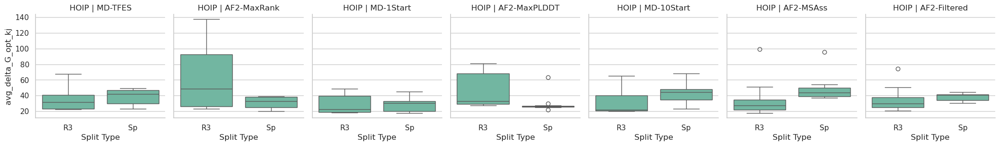

In [54]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("Set2", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="avg_G_opt_kj", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("avg_delta_G_opt_kj")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
# g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

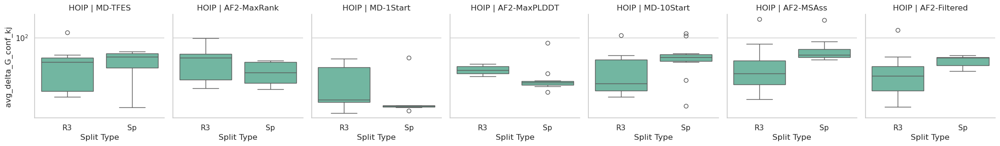

In [55]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("Set2", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="avg_G_conf_kj", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("avg_delta_G_conf_kj")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

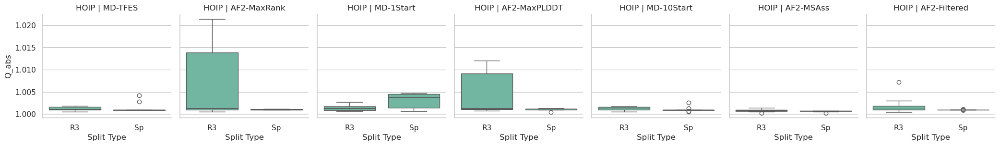

In [56]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("Set2", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="Q_abs", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("Q_abs")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
# g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

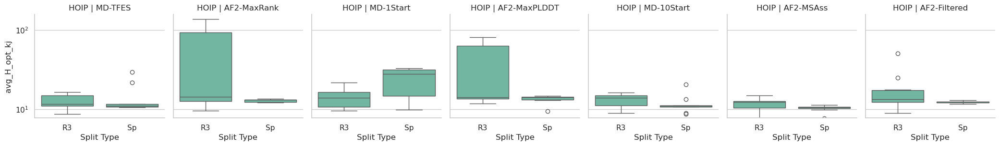

In [57]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("Set2", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="avg_H_opt_kj", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("avg_H_opt_kj")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')
g.set(yscale="log")
# 
plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

[  8.21304795  12.49689257  19.57210321  11.8046463   11.36918276
  10.81039388  20.7290881   10.2448926   11.86350603  12.18711906
 167.31258854   7.71552799  15.15854315 118.98262191  12.34031588
  10.86018615 107.58828343  14.92167102 111.20384017  16.99663466
  14.17973921  12.56455349  14.72430976  15.15006392  11.16470469
  10.83608423  13.89431541  15.04738462  13.60305745  13.89368842
  41.31511186  12.36252377  13.70474928  14.34546406  22.84764618
  11.67280639  13.60025418  13.58264734  13.50920307  14.06797159
   7.51841586  16.19148555  17.49891857  16.56477234  10.41776748
  21.02688358  16.60469604  10.24058124  22.3176488   15.92121375
   7.66692694   9.87916339   7.24984781  14.09771143   7.94593609
  13.82576155  13.61767348   7.51979068   7.62094818   8.35591397
  92.61262695   8.98730403  15.83885435  94.02931016  12.55545813
  10.04890413  17.4601951   15.0374221   92.17214088  19.43165233
   8.5350934   14.66781822  20.69073299  12.1106066   11.57358832
  12.10119

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

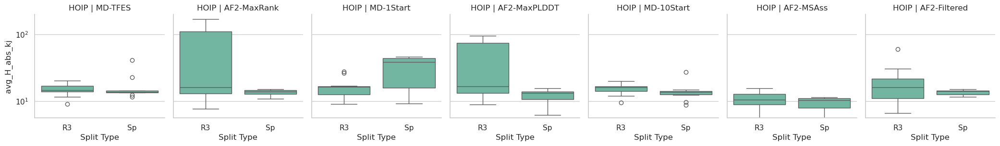

In [58]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"] 
test_df = _free_energy_df[_free_energy_df["delta_H_abs_kj"] > 0]

print(test_df.delta_H_abs_kj.values)
 # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("Set2", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="delta_H_abs_kj", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("avg_H_abs_kj")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')
g.set(yscale="log")
# 
plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

In [59]:



# import seaborn as sns
# import matplotlib.pyplot as plt
# # Set context and style
# # sns.set_context("talk")
# # sns.set_style("whitegrid")
# # # Create a custom palette

# _free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
# _free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# # _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
# palette = sns.color_palette("Set2", n_colors=len(_free_energy_df["split_type"].unique()))
# # Create the FacetGrid
# g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# # Map the boxplot to the FacetGrid
# g.map_dataframe(sns.boxplot, x="split_type", y="avg_H_conf_kj", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# # Customize the plot
# g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
# g.set_xlabels("Split Type")
# g.set_ylabels("avg_H_conf_kj")
# # Rotate x-tick labels
# # for ax in g.axes.flat:
# #     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
# # g.tight_layout()
# # Add legend
# for ax in g.axes.flat:
#     ax.axhline(y=0, color='black', linestyle='--')
# g.set(yscale="log")

# plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# # g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# # g.add_legend(title="split type")
# # Show the plot
# plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

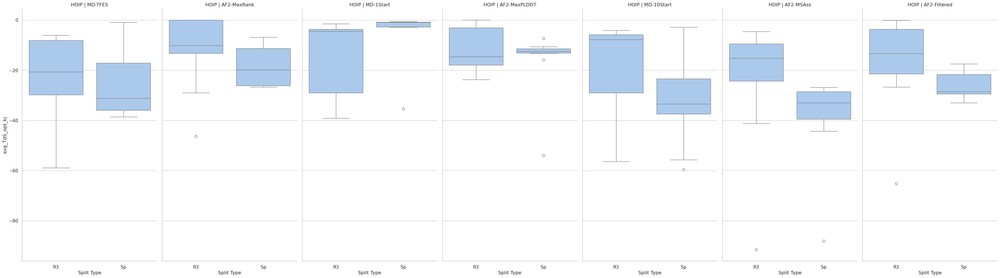

In [60]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("pastel", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=10, aspect=0.5, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="avg_TdS_opt_kj", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("avg_TdS_opt_kj")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
# g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

In [61]:
ensemble_pmf_df.avg_delta_avg_logPF

0      0.000000
1      0.000000
2      0.000000
3      0.000000
4      0.000000
         ...   
555    4.838744
556    6.502772
557    6.804703
558    5.767248
559    7.818375
Name: avg_delta_avg_logPF, Length: 560, dtype: float64

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

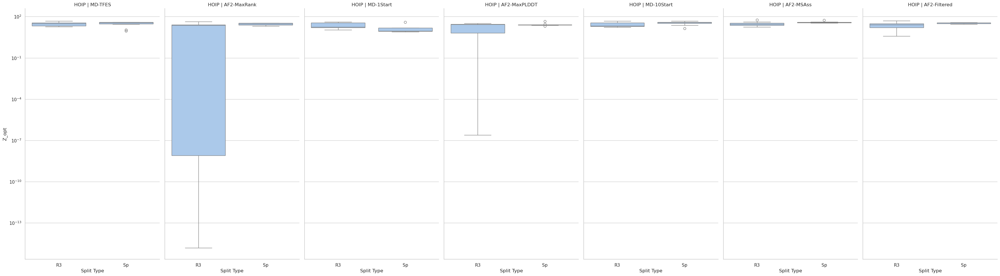

In [62]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("pastel", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=10, aspect=0.5, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="Z_opt", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("Z_opt")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

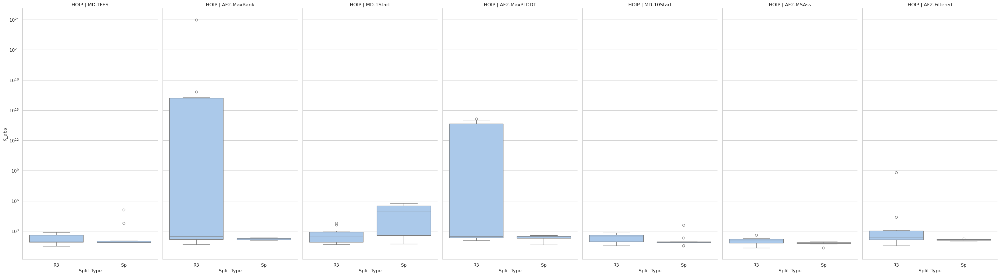

In [63]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("pastel", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=10, aspect=0.5, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="K_abs", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("K_abs")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

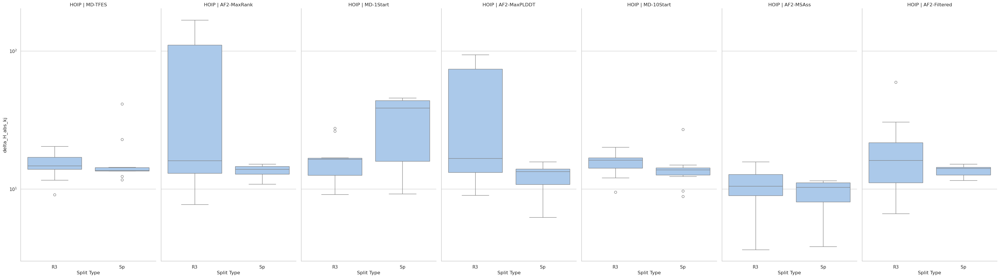

In [64]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("pastel", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=10, aspect=0.5, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="delta_H_abs_kj", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("delta_H_abs_kj")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

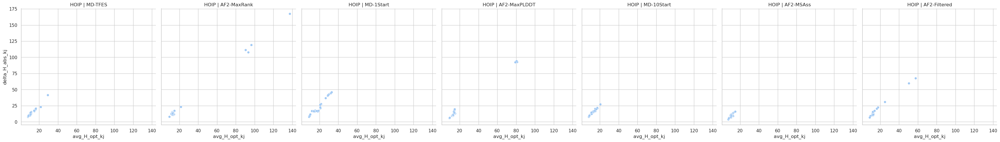

In [65]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("pastel", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=5, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_H_opt_kj", y="delta_H_abs_kj", hue="ensemble", palette=palette)#, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
# g.set_xlabels("Split Type")
# g.set_ylabels("K_abs")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
# g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

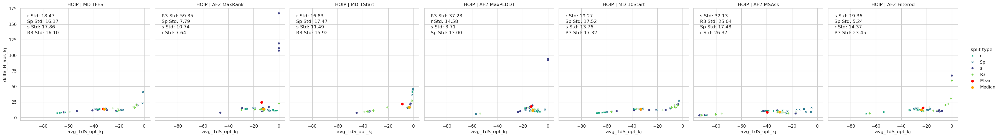

In [66]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"] != "prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] == "BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("viridis", n_colors=len(_free_energy_df["split_type"].unique()))

# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=5, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)

# Map the scatterplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_TdS_opt_kj", y="delta_H_abs_kj", hue="split_type", palette=palette, style="split_type")

# Function to calculate and annotate standard deviation for each split type
def annotate_std(data, **kwargs):
    split_types = data["split_type"].unique()
    ax = plt.gca()
    for split_type in split_types:
        subset = data[data["split_type"] == split_type]
        x = subset["avg_TdS_opt_kj"].astype(float)
        y = subset["delta_H_abs_kj"].astype(float)
        std_x = np.std(x)
        std_y = np.std(y)
        std_combined = np.sqrt(std_x**2 + std_y**2)
        ax.text(0.05, 0.95 - 0.05 * list(split_types).index(split_type), f'{split_type} Std: {std_combined:.2f}', transform=ax.transAxes, fontsize=12, verticalalignment='top')

# Function to plot mean and median
def plot_mean_median(data, **kwargs):
    ax = plt.gca()
    mean_x = data["avg_TdS_opt_kj"].mean()
    mean_y = data["delta_H_abs_kj"].mean()
    median_x = data["avg_TdS_opt_kj"].median()
    median_y = data["delta_H_abs_kj"].median()
    ax.scatter(mean_x, mean_y, color='red', label='Mean', zorder=5)
    ax.scatter(median_x, median_y, color='orange', label='Median', zorder=5)

# Apply the annotation function and plot mean/median to each subplot
g.map_dataframe(annotate_std)
g.map_dataframe(plot_mean_median)

# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
# g.set_xlabels("Split Type")
# g.set_ylabels("K_abs")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
# g.set(yscale="log")
# g.set(xscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

g.add_legend(title="split type")
# Show the plot
plt.show()

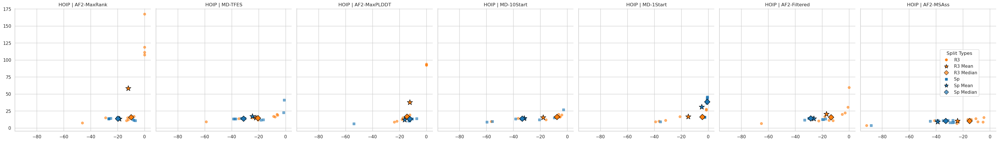

In [67]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set up the data
free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"] != "prior"]
free_energy_df = free_energy_df[free_energy_df["analysis"] == "BV"]
free_energy_df = free_energy_df[free_energy_df["split_type"].isin(["R3", "Sp"])]

# Define consistent styles for split types
split_styles = {
    'R3': {'marker': 'o', 'color': '#ff7f0e'},  # Orange
    'Sp': {'marker': 's', 'color': '#1f77b4'}   # Blue
}

# Create the FacetGrid
g = sns.FacetGrid(free_energy_df, 
                  row="protein", 
                  col="ensemble", 
                  height=5, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["avg_TdS_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  label=split_type,
                  alpha=0.6)

# Function to calculate and annotate mean and median with consistent styling
def annotate_mean_median(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            mean_x = subset["avg_TdS_opt_kj"].mean()
            mean_y = subset["delta_H_abs_kj"].mean()
            median_x = subset["avg_TdS_opt_kj"].median()
            median_y = subset["delta_H_abs_kj"].median()
            
            # Plot mean with darker version of split type color
            ax.scatter(mean_x, mean_y, 
                      marker='*', 
                      s=200,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_type} Mean',
                      zorder=5)
            
            # Plot median with lighter version of split type color
            ax.scatter(median_x, median_y, 
                      marker='D', 
                      s=100,
                      color=style['color'], 
                      edgecolor='black',
                      alpha=1,
                      label=f'{split_type} Median',
                      zorder=5)
            
            # # Add annotations
            # ax.annotate(f'{split_type} mean', 
            #            (mean_x, mean_y),
            #            xytext=(5, 5), 
            #            textcoords='offset points',
            #            fontsize=8,
            #            color=style['color'])
            # ax.annotate(f'{split_type} median', 
            #            (median_x, median_y),
            #            xytext=(5, -5), 
            #            textcoords='offset points',
            #            fontsize=8,
            #            color=style['color'])

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_mean_median)

# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")
# g.set(yscale="log")

# Adjust layout
plt.subplots_adjust(top=0.95)

# Add a custom legend
handles = []
labels = []
for split_type, style in split_styles.items():
    # Add scatter plot points
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            label=split_type))
    # Add mean markers
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            markersize=10,
                            label=f'{split_type} Mean'))
    # Add median markers
    handles.append(plt.Line2D([0], [0], 
                            marker='D',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            alpha=0.7,
                            markersize=8,
                            label=f'{split_type} Median'))
    labels.extend([split_type, f'{split_type} Mean', f'{split_type} Median'])

g.fig.legend(handles, labels, 
            loc='center right', 
            bbox_to_anchor=(0.98, 0.5),
            title="Split Types")

plt.show()

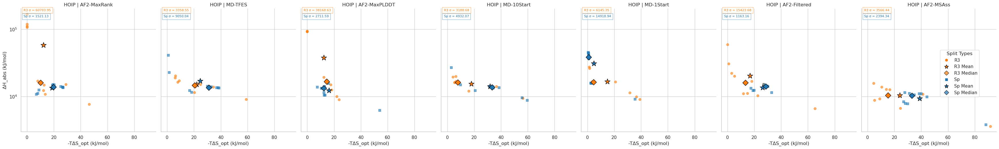

In [68]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Set up the data
free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"] != "prior"]
free_energy_df = free_energy_df[free_energy_df["analysis"] == "BV"]
free_energy_df = free_energy_df[free_energy_df["split_type"].isin(["R3", "Sp"])]

# Define consistent styles for split types
split_styles = {
    'R3': {'marker': 'o', 'color': '#ff7f0e'},  # Orange
    'Sp': {'marker': 's', 'color': '#1f77b4'}   # Blue
}

# Create the FacetGrid
g = sns.FacetGrid(free_energy_df, 
                  row="protein", 
                  col="ensemble", 
                  height=5, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-avg_TdS_opt_kj"], 
                  subset["delta_H_abs"],
                  marker=style['marker'],
                  color=style['color'],
                  label=split_type,
                  alpha=0.6)

# Function to calculate and annotate mean, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            mean_x = subset["-avg_TdS_opt_kj"].mean()
            mean_y = subset["delta_H_abs"].mean()
            median_x = subset["-avg_TdS_opt_kj"].median()
            median_y = subset["delta_H_abs"].median()
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-avg_TdS_opt_kj"], subset["delta_H_abs"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot mean with darker version of split type color
            ax.scatter(mean_x, mean_y, 
                      marker='*', 
                      s=200,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_type} Mean',
                      zorder=5)
            
            # Plot median with lighter version of split type color
            ax.scatter(median_x, median_y, 
                      marker='D', 
                      s=100,
                      color=style['color'], 
                      edgecolor='black',
                      alpha=1,
                      label=f'{split_type} Median',
                      zorder=5)
            
            # Add std dev annotation in the corner
            ax.annotate(f'{split_type} σ = {mult_std:.2f}', 
                       xy=(0.02, 0.98 - (0.05 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=8,
                       color=style['color'],
                       bbox=dict(facecolor='white', edgecolor=style['color'], alpha=0.5))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")
g.set(yscale="log")
# g.set(xscale="log")

# Add axis labels
g.set_axis_labels("-TΔS_opt (kJ/mol)", "ΔH_abs (kJ/mol)")

# Adjust layout
plt.subplots_adjust(top=0.95)

# Add a custom legend
handles = []
labels = []
for split_type, style in split_styles.items():
    # Add scatter plot points
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            label=split_type))
    # Add mean markers
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            markersize=10,
                            label=f'{split_type} Mean'))
    # Add median markers
    handles.append(plt.Line2D([0], [0], 
                            marker='D',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            alpha=0.7,
                            markersize=8,
                            label=f'{split_type} Median'))
    labels.extend([split_type, f'{split_type} Mean', f'{split_type} Median'])

g.fig.legend(handles, labels, 
            loc='center right', 
            bbox_to_anchor=(0.98, 0.5),
            title="Split Types")

plt.show()

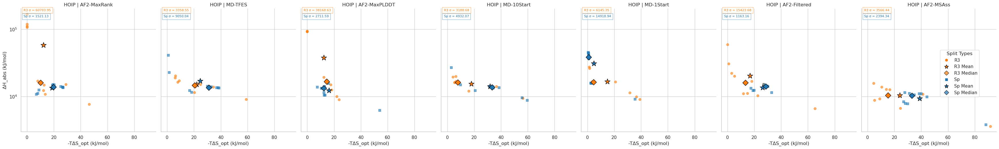

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Set up the data
free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"] != "prior"]
free_energy_df = free_energy_df[free_energy_df["analysis"] == "BV"]
free_energy_df = free_energy_df[free_energy_df["split_type"].isin(["R3", "Sp"])]

# Define consistent styles for split types
split_styles = {
    'R3': {'marker': 'o', 'color': '#ff7f0e'},  # Orange
    'Sp': {'marker': 's', 'color': '#1f77b4'}   # Blue
}

# Create the FacetGrid
g = sns.FacetGrid(free_energy_df, 
                  row="protein", 
                  col="ensemble", 
                  height=5, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-avg_TdS_opt_kj"], 
                  subset["delta_H_abs"],
                  marker=style['marker'],
                  color=style['color'],
                  label=split_type,
                  alpha=0.6)

# Function to calculate and annotate mean, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            mean_x = subset["-avg_TdS_opt_kj"].mean()
            mean_y = subset["delta_H_abs"].mean()
            median_x = subset["-avg_TdS_opt_kj"].median()
            median_y = subset["delta_H_abs"].median()
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-avg_TdS_opt_kj"], subset["delta_H_abs"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot mean with darker version of split type color
            ax.scatter(mean_x, mean_y, 
                      marker='*', 
                      s=200,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_type} Mean',
                      zorder=5)
            
            # Plot median with lighter version of split type color
            ax.scatter(median_x, median_y, 
                      marker='D', 
                      s=100,
                      color=style['color'], 
                      edgecolor='black',
                      alpha=1,
                      label=f'{split_type} Median',
                      zorder=5)
            
            # Add std dev annotation in the corner
            ax.annotate(f'{split_type} σ = {mult_std:.2f}', 
                       xy=(0.02, 0.98 - (0.05 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=8,
                       color=style['color'],
                       bbox=dict(facecolor='white', edgecolor=style['color'], alpha=0.5))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")
g.set(yscale="log")
# g.set(xscale="log")

# Add axis labels
g.set_axis_labels("-TΔS_opt (kJ/mol)", "ΔH_abs (kJ/mol)")

# Adjust layout
plt.subplots_adjust(top=0.95)

# Add a custom legend
handles = []
labels = []
for split_type, style in split_styles.items():
    # Add scatter plot points
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            label=split_type))
    # Add mean markers
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            markersize=10,
                            label=f'{split_type} Mean'))
    # Add median markers
    handles.append(plt.Line2D([0], [0], 
                            marker='D',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            alpha=0.7,
                            markersize=8,
                            label=f'{split_type} Median'))
    labels.extend([split_type, f'{split_type} Mean', f'{split_type} Median'])

g.fig.legend(handles, labels, 
            loc='center right', 
            bbox_to_anchor=(0.98, 0.5),
            title="Split Types")

plt.show()

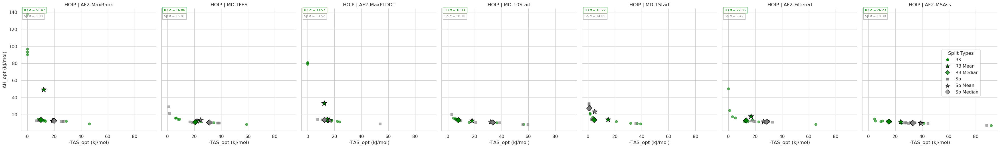

In [70]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Set up the data
free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"] != "prior"]
free_energy_df = free_energy_df[free_energy_df["analysis"] == "BV"]
free_energy_df = free_energy_df[free_energy_df["split_type"].isin(["R3", "Sp"])]

# Define consistent styles for split types
split_styles = {
    'R3': {'marker': 'o', 'color': 'Green'},  # Orange
    'Sp': {'marker': 's', 'color': 'Grey'}   # Blue
}

# Create the FacetGrid
g = sns.FacetGrid(free_energy_df, 
                  row="protein", 
                  col="ensemble", 
                  height=5, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-avg_TdS_opt_kj"], 
                  subset["avg_H_opt_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  label=split_type,
                  alpha=0.6)

# Function to calculate and annotate mean, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            mean_x = subset["-avg_TdS_opt_kj"].mean()
            mean_y = subset["avg_H_opt_kj"].mean()
            median_x = subset["-avg_TdS_opt_kj"].median()
            median_y = subset["avg_H_opt_kj"].median()
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-avg_TdS_opt_kj"], subset["avg_H_opt_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot mean with darker version of split type color
            ax.scatter(mean_x, mean_y, 
                      marker='*', 
                      s=200,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_type} Mean',
                      zorder=5)
            
            # Plot median with lighter version of split type color
            ax.scatter(median_x, median_y, 
                      marker='D', 
                      s=100,
                      color=style['color'], 
                      edgecolor='black',
                      alpha=1,
                      label=f'{split_type} Median',
                      zorder=5)
            
            # Add std dev annotation in the corner
            ax.annotate(f'{split_type} σ = {mult_std:.2f}', 
                       xy=(0.02, 0.98 - (0.05 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=8,
                       color=style['color'],
                       bbox=dict(facecolor='white', edgecolor=style['color'], alpha=0.5))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")
# g.set(yscale="log")
# g.set(xscale="log")

# Add axis labels
g.set_axis_labels("-TΔS_opt (kJ/mol)", "ΔH_opt (kJ/mol)")

# Adjust layout
plt.subplots_adjust(top=0.95)

# Add a custom legend
handles = []
labels = []
for split_type, style in split_styles.items():
    # Add scatter plot points
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            label=split_type))
    # Add mean markers
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            markersize=10,
                            label=f'{split_type} Mean'))
    # Add median markers
    handles.append(plt.Line2D([0], [0], 
                            marker='D',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            alpha=0.7,
                            markersize=8,
                            label=f'{split_type} Median'))
    labels.extend([split_type, f'{split_type} Mean', f'{split_type} Median'])

g.fig.legend(handles, labels, 
            loc='center right', 
            bbox_to_anchor=(0.98, 0.5),
            title="Split Types")

plt.show()

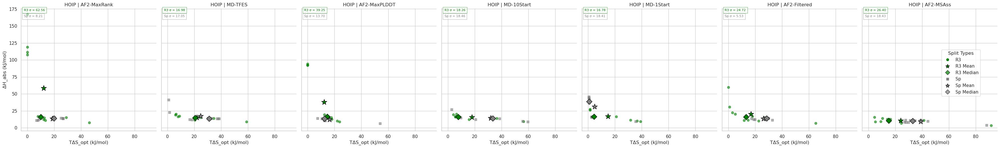

In [71]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Set up the data
free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"] != "prior"]
free_energy_df = free_energy_df[free_energy_df["analysis"] == "BV"]
free_energy_df = free_energy_df[free_energy_df["split_type"].isin(["R3", "Sp"])]

# Define consistent styles for split types
split_styles = {
    'R3': {'marker': 'o', 'color': 'Green'},  # Orange
    'Sp': {'marker': 's', 'color': 'Grey'}   # Blue
}

# Create the FacetGrid
g = sns.FacetGrid(free_energy_df, 
                  row="protein", 
                  col="ensemble", 
                  height=5, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-avg_TdS_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  label=split_type,
                  alpha=0.6)

# Function to calculate and annotate mean, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            mean_x = subset["-avg_TdS_opt_kj"].mean()
            mean_y = subset["delta_H_abs_kj"].mean()
            median_x = subset["-avg_TdS_opt_kj"].median()
            median_y = subset["delta_H_abs_kj"].median()
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-avg_TdS_opt_kj"], subset["delta_H_abs_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot mean with darker version of split type color
            ax.scatter(mean_x, mean_y, 
                      marker='*', 
                      s=200,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_type} Mean',
                      zorder=5)
            
            # Plot median with lighter version of split type color
            ax.scatter(median_x, median_y, 
                      marker='D', 
                      s=100,
                      color=style['color'], 
                      edgecolor='black',
                      alpha=1,
                      label=f'{split_type} Median',
                      zorder=5)
            
            # Add std dev annotation in the corner
            ax.annotate(f'{split_type} σ = {mult_std:.2f}', 
                       xy=(0.02, 0.98 - (0.05 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=8,
                       color=style['color'],
                       bbox=dict(facecolor='white', edgecolor=style['color'], alpha=0.5))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")
# g.set(yscale="log")

# Add axis labels
g.set_axis_labels("TΔS_opt (kJ/mol)", "ΔH_abs (kJ/mol)")

# Adjust layout
plt.subplots_adjust(top=0.95)

# Add a custom legend
handles = []
labels = []
for split_type, style in split_styles.items():
    # Add scatter plot points
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            label=split_type))
    # Add mean markers
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            markersize=10,
                            label=f'{split_type} Mean'))
    # Add median markers
    handles.append(plt.Line2D([0], [0], 
                            marker='D',
                            color=style['color'],
                            markeredgecolor='black',
                            linestyle='None',
                            alpha=0.7,
                            markersize=8,
                            label=f'{split_type} Median'))
    labels.extend([split_type, f'{split_type} Mean', f'{split_type} Median'])

g.fig.legend(handles, labels, 
            loc='center right', 
            bbox_to_anchor=(0.98, 0.5),
            title="Split Types")

plt.show()

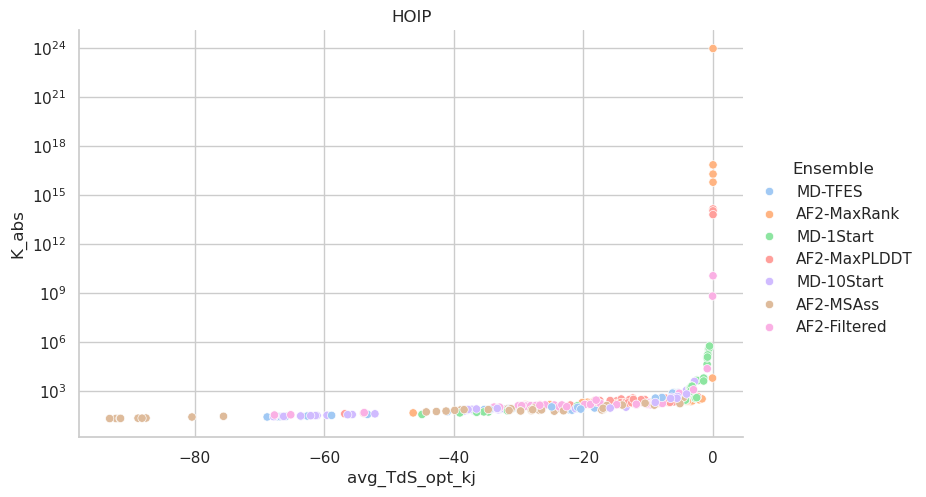

In [72]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("pastel", n_colors=len(_free_energy_df["ensemble"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", height=5, aspect=1.5, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_TdS_opt_kj", y="K_abs", hue="ensemble", palette=palette)#
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
# g.set_xlabels("Split Type")
# g.set_ylabels("K_abs")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
g.add_legend(title="Ensemble")
g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

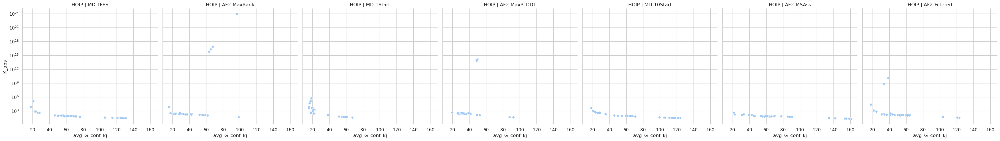

In [73]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("pastel", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=5, aspect=1, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_G_conf_kj", y="K_abs", hue="ensemble", palette=palette)#
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
# g.set_xlabels("Split Type")
# g.set_ylabels("K_abs")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more values (4) than needed (1), which may not be intended.
  func(*plot_args, **plot_kwargs)
/home/alexi/anaconda3/envs/HDXER_ENV/lib/python3.8/site-packages/seaborn/axisgrid.py:854: UserWarning: The palette list has more

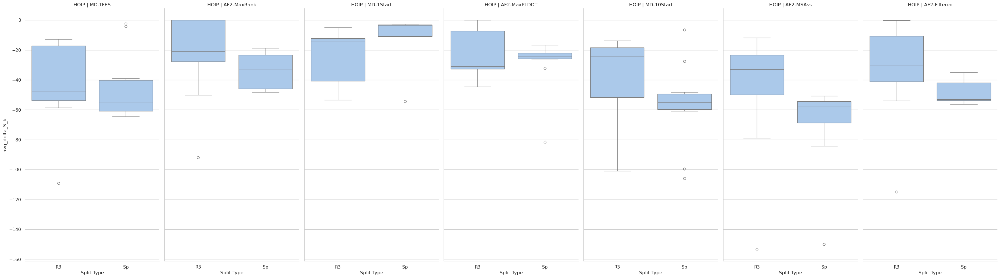

In [74]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = ensemble_pmf_df[ensemble_pmf_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV"]  # Fix: Compare "energy_difference" with 0
# _free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("pastel", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=10, aspect=0.5, sharey='row', sharex='row')#, row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="avg_TdS_conf_kj", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("avg_delta_S_k")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
# g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

In [75]:
pmf_df.analysis.unique()

array(['noBV', 'BV'], dtype=object)

In [76]:

# print analysis ==BV_bench and dataset == test
pmf_df[(pmf_df["analysis"] == "BV_bench") & (pmf_df["dataset"] == "test")]

,Residues,LogPf,calc_name,name,system,analysis,split_type,protein,name_name,dataset,...,S_conf_kj,G_opt_kj,G_conf_kj,TdS_opt_kj,TdS_conf_kj,method,fit,ensemble,split_name,replicate


In [77]:

def calc_energy(features: pd.DataFrame, BV_constants: pd.DataFrame, weights: pd.DataFrame) -> pd.DataFrame:
    """
    Calculate the energy of the system from the dataframes provided.
    Features contains the sum of the contacts/hbonds for each system,
    these are multiplied by the BV Bc and Bh constants respectively.
    Weights are simply added to the dataframe aligned by calc_name.
    sum_contacts, sum_hbonds, Bc, Bh, weights are arrays of the same length.
    Features are aligned based on "system" as there are multiple replicates designated by calc_name in BV_constants and weights.
    Returns a dataframe with the energy for each system and calc_name.
    """
    # merge BV_constants and weights on calc_name
    # select weights and calc_name columns 
    weights = weights[["calc_name", "weights"]]

    merged = pd.concat([BV_constants, weights], axis=1, join="inner")
    print(merged.columns)
    print(merged.system.value_counts())

    systems = features.system.unique()
    # iterate through the systems
    features = features[['system', 'sum_contacts', 'sum_hbonds']]

    data_frames = []

    for system in systems:
        print(system)
        system_features = features[features["system"] == system]

        # get the sum_contacts and sum_hbonds
        sum_contacts = system_features["sum_contacts"].to_list()
        sum_hbonds = system_features["sum_hbonds"].to_list()

        system_merged = merged[merged["system"] == system]
        print(sum_contacts)
        # add the sum_contacts and sum_hbonds to the system_merged
        system_merged["sum_contacts"] = sum_contacts*len(system_merged)
        system_merged["sum_hbonds"] = sum_hbonds*len(system_merged)

        # calculate the energy
        system_merged["energy"] = system_merged["Bc"]*system_merged["sum_contacts"] + system_merged["Bh"]*system_merged["sum_hbonds"]

        # multiply each element in the weights array by the energy and sum

        system_merged["weighted_energy"] = system_merged["weights"]*system_merged["energy"]

        system_merged["mean_energy"] = system_merged["weighted_energy"].apply(lambda x: np.sum(x))

        data_frames.append(system_merged)


    merged = pd.concat(data_frames)
 
    # remove duplicate columns
    merged = merged.loc[:,~merged.columns.duplicated()]

    return merged




energy_df = calc_energy(features, BV_constants, weights)


Index(['Bc', 'Bh', 'calc_name', 'name', 'system', 'analysis', 'split_type',
       'protein', 'name_name', 'dataset', 'class', 'bench', 'calc_name',
       'weights'],
      dtype='object')
system
HOIP_MD_TFES_noBV_bench_r_naive_random            11
HOIP_MD_10Start_noBV_bench_Sp_res_neighbours      11
HOIP_high_rank_BV_bench_Sp_res_neighbours         11
HOIP_MD_TFES_BV_bench_Sp_res_neighbours           11
HOIP_MD_1Start_BV_bench_r_naive_random            11
HOIP_MD_TFES_BV_bench_s_naive_sequential          11
HOIP_max_plddt_BV_bench_R3_k_sequence             11
HOIP_MD_10Start_BV_bench_r_naive_random           11
HOIP_MD_10Start_BV_bench_Sp_res_neighbours        11
HOIP_high_rank_BV_bench_s_naive_sequential        11
HOIP_high_rank_BV_bench_r_naive_random            11
HOIP_max_plddt_BV_bench_r_naive_random            11
HOIP_MD_10Start_BV_bench_s_naive_sequential       11
HOIP_AF2_MSAss_BV_bench_s_naive_sequential        11
HOIP_MD_1Start_BV_bench_Sp_res_neighbours         11
HOIP_max

/tmp/ipykernel_2064812/1829492649.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  system_merged["sum_contacts"] = sum_contacts*len(system_merged)
/tmp/ipykernel_2064812/1829492649.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  system_merged["sum_hbonds"] = sum_hbonds*len(system_merged)
/tmp/ipykernel_2064812/1829492649.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

ValueError: operands could not be broadcast together with shapes (1310,) (1001,) 

In [78]:
energy_df

NameError: name 'energy_df' is not defined

In [79]:



energy_df["protein"] = energy_df["name"].apply(lambda x: x.split("_")[0])
# log_PFs["method"] = log_PFs["name"].apply(lambda x: x.split("_")[3])
energy_df["replicate"] = energy_df["calc_name"].apply(lambda x: x.split("_")[-1])

energy_df["method"] = energy_df["name"].apply(lambda x: x.split("_")[2])

# if 400 add shaw to the front
energy_df["ensemble"] = energy_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)

# if top or bottom in name add "500" to the end
energy_df["ensemble"] = energy_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)

# if dirty, clean or conf in name add af_ to the front
energy_df["ensemble"] = energy_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)

energy_df["replicate"] = energy_df["calc_name"].apply(lambda x: x.split("_")[-1])

NameError: name 'energy_df' is not defined

In [80]:
import numpy as np
from scipy.constants import Boltzmann

def calc_absolute_entropy(energy_df: pd.DataFrame, key="weights", R=8.31):
    """
    Calculates the absolute entropy for the energy dataframe provided.
    The key is the column in the energy_df that contains the weights.
    The entropy is calculated for each array in the weights column.
    
    Parameters:
    energy_df (pd.DataFrame): DataFrame containing the weights
    key (str): Column name for the weights
    T (float): Temperature in Kelvin
    
    Returns:
    pd.DataFrame: Original dataframe with added entropy columns
    """
    
    def entropy(p):
        # Avoid log(0) by adding a small constant
        return -np.sum(p * np.log(p + 1e-10))
    
    entropies = []
    for weights in energy_df[key]:
        # Convert weights to numpy array if it's not already
        weights = np.array(weights)
        
        # Normalize weights to sum to 1
        weights = weights / np.sum(weights)
        
        # Calculate entropy
        S = entropy(weights)
        entropies.append(S)
    
    # Add entropy as a new column to the dataframe
    energy_df['Entropy_nats'] = entropies
    
    # Convert entropy to J/K/mol
    energy_df['Entropy_JKmol'] = energy_df['Entropy_nats'] * R
    


    return energy_df

# Usage:
energy_df = calc_absolute_entropy(energy_df)

NameError: name 'energy_df' is not defined

In [81]:
def calc_energy_difference(energy_df: pd.DataFrame, dataset="prior", key="mean_energy", T=300, R=8.31):
    """
    Calculates the energy change upon reweighting from the prior
    """

    systems = energy_df.system.unique()


    dfs= []
    for system in systems:
        # print(system)
        system_df = energy_df[energy_df["system"] == system]
        prior = system_df[system_df["dataset"] == dataset]
        prior_energy = prior[key].values
        # print(prior_energy)
        system_df["signed_energy_difference"] = system_df[key].values - prior_energy
        # take absolute value
        system_df["energy_difference"] = system_df["signed_energy_difference"].apply(lambda x: np.abs(x))
        # print(system_df["energy_difference"])
        system_df["%_energy_difference"] = system_df["energy_difference"].apply(lambda x: 100*x/np.abs(prior_energy))

        # convert %_energy_difference from a list
        system_df["%_energy_difference"] = system_df["%_energy_difference"].apply(lambda x: x[0])



        system_df["ratio_energy_difference"] = system_df["%_energy_difference"].apply(lambda x: x/100+1)


        system_df["entropy_difference"] = system_df["Entropy_JKmol"].values - prior["Entropy_JKmol"].values

        system_df["signed_enthalpy"] = system_df["signed_energy_difference"] 

        print(system_df.entropy_difference.values)

        system_df["gibbs_free_energy"] = system_df["energy_difference"] - T*system_df["entropy_difference"]

        # convert to equilibrium constant
        system_df["equilibrium_constant"] = system_df["gibbs_free_energy"].apply(lambda x: np.exp(-x/(R*T)))


   
        dfs.append(system_df)

    energy_df = pd.concat(dfs)

    return energy_df

energy_df = calc_energy_difference(energy_df)

energy_df.columns

NameError: name 'energy_df' is not defined

In [82]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
# sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = energy_df[energy_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV_bench"]  # Fix: Compare "energy_difference" with 0
_free_energy_df = _free_energy_df[_free_energy_df["ensemble"] != "Shaw_small"]
palette = sns.color_palette("Set2", n_colors=len(_free_energy_df["split_type"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row', row_order=protein_names)#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="%_energy_difference", hue="ensemble", palette=palette, order=['R3', 'Sp'])
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
g.set_xlabels("Split Type")
g.set_ylabels("%_energy_difference")
# Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
# g.tight_layout()
# Add legend
# g.set(yscale="log")

plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
g.fig.suptitle('BPTI %Work vs Split Type by Protein')  # Set a super title for the grid

# g.add_legend(title="split type")
# Show the plot
plt.show()

NameError: name 'energy_df' is not defined

In [83]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_free_energy_df = energy_df[energy_df["dataset"]!="prior"]
_free_energy_df = _free_energy_df[_free_energy_df["analysis"] =="BV_bench"]  # Fix: Compare "energy_difference" with 0
palette = sns.color_palette("Set1", n_colors=len(energy_df["replicate"].unique()))
# Create the FacetGrid
g = sns.FacetGrid(_free_energy_df, row="protein", col="ensemble",height=5, aspect=1.5, sharey=False, sharex=False)#, row_order=protein_names, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="%_energy_difference", hue="split_type", palette="Set2")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("Ensemble", fontsize=14)
g.set_ylabels("%_energy_difference", fontsize=14)
# Rotate x-tick labels
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(yscale="log")
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'energy_df' is not defined

In [84]:
# merge MSE and energy dataframes
val_mse_df = mse_dfs[mse_dfs["Type"] == "Val"]

BV_val_mse_df = val_mse_df[val_mse_df["bench"] == "BV"]

# average "mse" for each "calc_name" and "replicate" by "time"
BV_val_mse_df = BV_val_mse_df.groupby(["name", "replicate", "protein", "split_type"])["mse"].mean().reset_index()

BV_val_mse_df



,name,replicate,protein,split_type,mse
0,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,1,HOIP,R3,0.040803
1,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,10,HOIP,R3,0.041588
2,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,2,HOIP,R3,0.062198
3,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,3,HOIP,R3,0.040758
4,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,4,HOIP,R3,0.045186
...,...,...,...,...,...
275,HOIP_max_plddt_BV_bench_s_naive_sequential,5,HOIP,s,0.026748
276,HOIP_max_plddt_BV_bench_s_naive_sequential,6,HOIP,s,0.043820
277,HOIP_max_plddt_BV_bench_s_naive_sequential,7,HOIP,s,0.041701
278,HOIP_max_plddt_BV_bench_s_naive_sequential,8,HOIP,s,0.028712


In [85]:

BV_energy_df = energy_df[energy_df["analysis"] == "BV_bench"]

BV_energy_df = BV_energy_df[BV_energy_df["dataset"]!= "prior"]
BV_energy_df


NameError: name 'energy_df' is not defined

In [86]:

BV_val_mse_df = BV_val_mse_df[["name", "replicate", "mse"]]


MSE_energy_df = pd.merge(BV_val_mse_df, BV_energy_df, on=["name", "replicate"], how="inner")


NameError: name 'BV_energy_df' is not defined

In [87]:
# MSE_energy_df

In [88]:

MSE_ensemble_pmf_df = pd.merge(BV_val_mse_df, ensemble_pmf_df, on=["name", "replicate", "protein", "split_type"], how="inner")

MSE_ensemble_pmf_df

KeyError: 'protein'

In [89]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_ensemble_pmf_df[MSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]
# _MSE_energy_df = MSE_ensemble_pmf_df
# _MSE_energy_df = _MSE_energy_df[_MSE_energy_df["ensemble"]!="small"]

# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",col="ensemble",height=5, aspect=1.5, sharey='row', sharex=False)#, row_order=protein_names, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="likelihood_opt", y="mse", hue="split_type", palette="Set2")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("likelihood", fontsize=14)
g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")

g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_ensemble_pmf_df' is not defined

In [90]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_ensemble_pmf_df[MSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]
# _MSE_energy_df = MSE_ensemble_pmf_df
# _MSE_energy_df = _MSE_energy_df[_MSE_energy_df["ensemble"]!="small"]

# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",col="ensemble",height=5, aspect=1.5, sharey='row', sharex=False)#, row_order=protein_names, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="likelihood_conf", y="mse", hue="split_type", palette="Set2")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("likelihood", fontsize=14)
g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")

g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_ensemble_pmf_df' is not defined

In [91]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_ensemble_pmf_df[MSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]
# _MSE_energy_df = MSE_ensemble_pmf_df
# _MSE_energy_df = _MSE_energy_df[_MSE_energy_df["ensemble"]!="small"]

# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",col="ensemble",height=5, aspect=1.5, sharey='row', sharex='row')#, row_order=protein_names, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_G_opt_kj", y="mse", hue="split_type", palette="Set2")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
# g.set_xlabels("likelihood", fontsize=14)
g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")

g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_ensemble_pmf_df' is not defined

In [92]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_ensemble_pmf_df[MSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]
# _MSE_energy_df = MSE_ensemble_pmf_df
# _MSE_energy_df = _MSE_energy_df[_MSE_energy_df["ensemble"]!="small"]

# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",col="ensemble",height=5, aspect=1.5, sharey='row', sharex=False)#, row_order=protein_names, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_G_conf_kj", y="mse", hue="split_type", palette="Set2")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
# g.set_xlabels("likelihood", fontsize=14)
g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")

g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_ensemble_pmf_df' is not defined

In [93]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_ensemble_pmf_df[MSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]
# _MSE_energy_df = MSE_ensemble_pmf_df
# _MSE_energy_df = _MSE_energy_df[_MSE_energy_df["ensemble"]!="small"]

# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",col="ensemble",height=5, aspect=1.5, sharey='row', sharex='row')#, row_order=protein_names, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_G_conf_kj", y="Q_abs", hue="split_type", palette="Set2")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
# g.set_xlabels("likelihood", fontsize=14)
# g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")

g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_ensemble_pmf_df' is not defined

In [94]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_energy_df[MSE_energy_df["split_type"].isin([ "R3", "Sp"])]
# _MSE_energy_df = MSE_energy_df
_MSE_energy_df = _MSE_energy_df[_MSE_energy_df["ensemble"]!="small"]

# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",col="ensemble",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["BPTI","HOIP","BRD4"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="%_energy_difference", y="mse", hue="split_type", palette="Set2")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("%_energy_difference", fontsize=14)
g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
g.set(xscale="log")

g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_energy_df' is not defined

In [95]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_energy_df[MSE_energy_df["split_type"].isin([ "R3", "Sp"])]

# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",col="ensemble",height=5, aspect=1.5, sharey=True, sharex=True, row_order=["BPTI"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="%_energy_difference", y="mse", hue="split_type", palette="Set2")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("%_energy_difference", fontsize=14)
g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")

g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_energy_df' is not defined

In [96]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_energy_df[MSE_energy_df["split_type"].isin([ "R3"])]

# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",col="ensemble",height=5, aspect=1.5, sharey=True, sharex=True, row_order=["BPTI"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="%_energy_difference", y="mse", hue="replicate", style="split_type", palette="tab10")#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("%_energy_difference", fontsize=14)
g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
g.set(xscale="log")

g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_energy_df' is not defined

In [97]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = MSE_energy_df[MSE_energy_df["split_type"].isin(["R3","Sp"])]
# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["BPTI"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="%_energy_difference", y="mse", hue="ensemble", palette="Set1", style="split_type",alpha=0.7)#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("%_energy_difference", fontsize=14)
g.set_ylabels("MSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")
g.set(ylim=(0, 0.5))
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'MSE_energy_df' is not defined

In [98]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["split_type"].isin(["R3","Sp"])]
# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["BPTI"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="gibbs_free_energy", y="dMSE", hue="ensemble", palette="Set1", style="split_type",alpha=0.7)#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("gibbs_free_energy J/Mol", fontsize=14)
g.set_ylabels("dMSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")
# g.set(ylim=(0, 0.5))
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

NameError: name 'dMSE_energy_df' is not defined

In [99]:
# pkl_list["merge_df"]

In [100]:
features = pkl_list["features"]
BV_constants = pkl_list["BV_constants"]
weights = pkl_list["weights"]

def calc_energy(features: pd.DataFrame, BV_constants: pd.DataFrame, weights: pd.DataFrame, R=8.31, T=300) -> pd.DataFrame:
    """
    Calculate the energy of the system from the dataframes provided.
    Features contains the sum of the contacts/hbonds for each system,
    these are multiplied by the BV Bc and Bh constants respectively.
    Weights are simply added to the dataframe aligned by calc_name.
    sum_contacts, sum_hbonds, Bc, Bh, weights are arrays of the same length.
    Features are aligned based on "system" as there are multiple replicates designated by calc_name in BV_constants and weights.
    Returns a dataframe with the energy for each system and calc_name.
    """
    # merge BV_constants and weights on calc_name
    # select weights and calc_name columns 
    weights = weights[["calc_name", "weights"]]

    merged = pd.concat([BV_constants, weights], axis=1, join="inner")
    print(merged.columns)
    print(merged.system.value_counts())

    systems = features.system.unique()
    # iterate through the systems
    features = features[['system', 'sum_contacts', 'sum_hbonds']]

    data_frames = []

    for system in systems:
        print(system)
        system_features = features[features["system"] == system]

        # get the sum_contacts and sum_hbonds
        sum_contacts = system_features["sum_contacts"].to_list()
        sum_hbonds = system_features["sum_hbonds"].to_list()

        system_merged = merged[merged["system"] == system]

        # add the sum_contacts and sum_hbonds to the system_merged
        system_merged["sum_contacts"] = sum_contacts*len(system_merged)
        system_merged["sum_hbonds"] = sum_hbonds*len(system_merged)

        # calculate the energy
        system_merged["energy"] = (system_merged["Bc"]*system_merged["sum_contacts"] + system_merged["Bh"]*system_merged["sum_hbonds"])*R*T

        # multiply each element in the weights array by the energy and sum

        system_merged["weighted_energy"] = system_merged["weights"]*system_merged["energy"]

        system_merged["mean_energy"] = system_merged["weighted_energy"].apply(lambda x: np.sum(x))

        data_frames.append(system_merged)


    merged = pd.concat(data_frames)
 
    # remove duplicate columns
    merged = merged.loc[:,~merged.columns.duplicated()]

    return merged




energy_df = calc_energy(features, BV_constants, weights)



energy_df["protein"] = energy_df["name"].apply(lambda x: x.split("_")[0])
# log_PFs["method"] = log_PFs["name"].apply(lambda x: x.split("_")[3])
energy_df["replicate"] = energy_df["calc_name"].apply(lambda x: x.split("_")[-1])

energy_df["method"] = energy_df["name"].apply(lambda x: x.split("_")[2])

# if 400 add shaw to the front
energy_df["ensemble"] = energy_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)

# if top or bottom in name add "500" to the end
energy_df["ensemble"] = energy_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)

# if dirty, clean or conf in name add af_ to the front
energy_df["ensemble"] = energy_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)

# if Good or Bad in name add MD to the front
energy_df["ensemble"] = energy_df["ensemble"].apply(lambda x: "MD_" + x if "Good" in x or "Bad" in x else x)


energy_df["replicate"] = energy_df["calc_name"].apply(lambda x: x.split("_")[-1])

Index(['Bc', 'Bh', 'calc_name', 'name', 'system', 'analysis', 'split_type',
       'protein', 'name_name', 'dataset', 'class', 'bench', 'calc_name',
       'weights'],
      dtype='object')
system
HOIP_MD_TFES_noBV_bench_r_naive_random            11
HOIP_MD_10Start_noBV_bench_Sp_res_neighbours      11
HOIP_high_rank_BV_bench_Sp_res_neighbours         11
HOIP_MD_TFES_BV_bench_Sp_res_neighbours           11
HOIP_MD_1Start_BV_bench_r_naive_random            11
HOIP_MD_TFES_BV_bench_s_naive_sequential          11
HOIP_max_plddt_BV_bench_R3_k_sequence             11
HOIP_MD_10Start_BV_bench_r_naive_random           11
HOIP_MD_10Start_BV_bench_Sp_res_neighbours        11
HOIP_high_rank_BV_bench_s_naive_sequential        11
HOIP_high_rank_BV_bench_r_naive_random            11
HOIP_max_plddt_BV_bench_r_naive_random            11
HOIP_MD_10Start_BV_bench_s_naive_sequential       11
HOIP_AF2_MSAss_BV_bench_s_naive_sequential        11
HOIP_MD_1Start_BV_bench_Sp_res_neighbours         11
HOIP_max

/tmp/ipykernel_2064812/2466290440.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  system_merged["sum_contacts"] = sum_contacts*len(system_merged)
/tmp/ipykernel_2064812/2466290440.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  system_merged["sum_hbonds"] = sum_hbonds*len(system_merged)
/tmp/ipykernel_2064812/2466290440.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

ValueError: operands could not be broadcast together with shapes (1310,) (1001,) 

In [101]:
import numpy as np
from scipy.constants import Boltzmann

def calc_absolute_entropy(energy_df: pd.DataFrame, key="weights", R=8.31):
    """
    Calculates the absolute entropy for the energy dataframe provided.
    The key is the column in the energy_df that contains the weights.
    The entropy is calculated for each array in the weights column.
    
    Parameters:
    energy_df (pd.DataFrame): DataFrame containing the weights
    key (str): Column name for the weights
    T (float): Temperature in Kelvin
    
    Returns:
    pd.DataFrame: Original dataframe with added entropy columns
    """
    
    def entropy(p):
        # Avoid log(0) by adding a small constant
        return -np.sum(p * np.log(p + 1e-10))
    
    entropies = []
    for weights in energy_df[key]:
        # Convert weights to numpy array if it's not already
        weights = np.array(weights)
        
        # Normalize weights to sum to 1
        weights = weights / np.sum(weights)
        
        # Calculate entropy
        S = entropy(weights)
        entropies.append(S)
    
    # Add entropy as a new column to the dataframe
    energy_df['Entropy_nats'] = entropies
    
    # Convert entropy to J/K/mol
    energy_df['Entropy_JKmol'] = energy_df['Entropy_nats'] * R
    


    return energy_df

# Usage:
energy_df = calc_absolute_entropy(energy_df)

NameError: name 'energy_df' is not defined

In [102]:
def calc_energy_difference(energy_df: pd.DataFrame, dataset="prior", key="mean_energy", T=300, R=8.31):
    """
    Calculates the energy change upon reweighting from the prior
    """

    systems = energy_df.system.unique()


    dfs= []
    for system in systems:
        # print(system)
        system_df = energy_df[energy_df["system"] == system]
        prior = system_df[system_df["dataset"] == dataset]
        prior_energy = prior[key].values
        # print(prior_energy)
        system_df["signed_energy_difference"] = system_df[key].values - prior_energy
        # take absolute value
        system_df["energy_difference"] = system_df["signed_energy_difference"].apply(lambda x: np.abs(x))
        # print(system_df["energy_difference"])
        system_df["%_energy_difference"] = system_df["energy_difference"].apply(lambda x: 100*x/np.abs(prior_energy))

        # convert %_energy_difference from a list
        system_df["%_energy_difference"] = system_df["%_energy_difference"].apply(lambda x: x[0])



        system_df["ratio_energy_difference"] = system_df["%_energy_difference"].apply(lambda x: x/100+1)


        system_df["entropy_difference"] = system_df["Entropy_JKmol"].values - prior["Entropy_JKmol"].values

        system_df["signed_enthalpy"] = system_df["signed_energy_difference"] 

        print(system_df.entropy_difference.values)

        system_df["gibbs_free_energy"] = system_df["energy_difference"] - T*system_df["entropy_difference"]

        # convert to equilibrium constant
        system_df["equilibrium_constant"] = system_df["gibbs_free_energy"].apply(lambda x: np.exp(-x/(R*T)))


   
        dfs.append(system_df)

    energy_df = pd.concat(dfs)

    return energy_df

energy_df = calc_energy_difference(energy_df)

energy_df.columns

NameError: name 'energy_df' is not defined

In [103]:
merge_df = pkl_list["merge_df"]

merge_df["replicate"] = merge_df["calc_name"].apply(lambda x: x.split("_")[-1])
merge_df.dataset.value_counts()

dataset
prior           58800
train           25916
val             25588
Experimental     5880
Name: count, dtype: int64

In [104]:
# def calc_MSE_difference(merge_df:pd.DataFrame, key='mse', prior_dataset='prior', val_dataset='val'):
#     print("\n=== Starting MSE Difference Calculation ===")
#     print(f"Input DataFrame shape: {merge_df.shape}")
#     print(f"Datasets present: {merge_df.dataset.value_counts()}\n")
    
#     prior_df = merge_df[merge_df["dataset"]==prior_dataset]
#     val_df = merge_df[merge_df["dataset"]==val_dataset]
    
#     print(f"Prior dataset shape: {prior_df.shape}")
#     print(f"Validation dataset shape: {val_df.shape}\n")

#     systems = prior_df["system"].unique()
#     print(f"Systems to process: {systems}\n")

#     dMSE_df = pd.DataFrame()
#     dMSE_percentage_df = pd.DataFrame()
#     mean_dMSE_df = pd.DataFrame()
#     mean_dMSE_percentage_df = pd.DataFrame()

#     columns = val_df.columns.tolist()
#     times = [col for col in columns if col != str(col)]
#     string_columns = [col for col in columns if col not in times]
#     columns_to_remove = ["peptide"]
#     final_string_columns = [col for col in string_columns if col not in columns_to_remove]

#     print(f"Time columns: {times}")
#     print(f"String columns: {string_columns}")
#     print(f"Final string columns: {final_string_columns}\n")

#     for system in systems:
#         print(f"\n=== Processing System: {system} ===")
        
#         system_prior_df = prior_df[prior_df["system"]==system]
#         system_df = val_df[val_df["system"]==system]
        
#         print(f"System prior shape: {system_prior_df.shape}")
#         print(f"System validation shape: {system_df.shape}")

#         system_times = [time for time in times if not np.isnan(system_df[time].values).all()]
#         print(f"Valid times for system: {system_times}")

#         system_replicates = system_df["replicate"].unique()
#         print(f"Replicates to process: {system_replicates}\n")

#         for rep in system_replicates:
#             print(f"\n--- Processing Replicate: {rep} ---")
            
#             system_calc_df = system_df[system_df["replicate"]==rep]
#             system_prior_calc_df = system_prior_df[system_prior_df["replicate"]==rep]
            
#             print(f"Replicate calc shape: {system_calc_df.shape}")
#             print(f"Replicate prior shape: {system_prior_calc_df.shape}")

#             val_peptides = system_calc_df["peptide"].unique()
#             system_prior_calc_df = system_prior_calc_df[system_prior_calc_df["peptide"].isin(val_peptides)]
            
#             print("\nPeptide counts after filtering:")
#             print("Prior dataset:")
#             print(system_prior_calc_df.peptide.value_counts())
#             print("\nValidation dataset:")
#             print(system_calc_df.peptide.value_counts())

#             df_to_add = system_calc_df.copy()
#             df_percentage_to_add = system_calc_df.copy()

#             for time in system_times:
#                 print(f"\nProcessing time: {time}")
#                 print(f"Validation values: {system_calc_df[time].values}")
#                 print(f"Prior values: {system_prior_calc_df[time].values}")
                
#                 df_to_add[time] = system_calc_df[time].values - system_prior_calc_df[time].values
#                 df_percentage_to_add[time] = 100*(system_calc_df[time].values - system_prior_calc_df[time].values)/system_prior_calc_df[time].values
                
#                 print(f"Difference values: {df_to_add[time].values}")
#                 print(f"Percentage difference values: {df_percentage_to_add[time].values}")

#             dMSE_df = pd.concat([dMSE_df, df_to_add])
#             dMSE_percentage_df = pd.concat([dMSE_percentage_df, df_percentage_to_add])

#             print("\nCalculating means...")
#             mean_dMSE = df_to_add.groupby("calc_name")[system_times].mean().values
#             mean_dMSE = pd.DataFrame(mean_dMSE, columns=system_times)

#             for col in string_columns:
#                 mean_dMSE[col] = df_to_add[col].values[0]

#             print("\nMean dMSE before melting:")
#             print(mean_dMSE)

#             mean_dMSE = pd.melt(mean_dMSE, id_vars=final_string_columns, value_vars=system_times, var_name="time", value_name="dMSE")

#             print("\nMean dMSE after melting:")
#             print(mean_dMSE)

#             mean_dMSE_df = pd.concat([mean_dMSE_df, mean_dMSE])

#             mean_dMSE_percentage = df_percentage_to_add.groupby("calc_name")[system_times].mean().values
#             mean_dMSE_percentage = pd.DataFrame(mean_dMSE_percentage, columns=system_times)

#             for col in string_columns:
#                 mean_dMSE_percentage[col] = df_to_add[col].values[0]

#             print("\nMean percentage dMSE:")
#             print(mean_dMSE_percentage)

#             mean_dMSE_percentage = pd.melt(mean_dMSE_percentage, id_vars=final_string_columns, value_vars=system_times, var_name="time", value_name="dMSE%")
#             mean_dMSE_percentage_df = pd.concat([mean_dMSE_percentage_df, mean_dMSE_percentage])

#     print("\n=== Final DataFrame Shapes ===")
#     print(f"dMSE_df: {dMSE_df.shape}")
#     print(f"mean_dMSE_df: {mean_dMSE_df.shape}")
#     print(f"dMSE_percentage_df: {dMSE_percentage_df.shape}")
#     print(f"mean_dMSE_percentage_df: {mean_dMSE_percentage_df.shape}")
#     return dMSE_df, mean_dMSE_df, dMSE_percentage_df, mean_dMSE_percentage_df

# dMSE_df, mean_dMSE_df, dMSE_percentage_df, mean_dMSE_percentage_df = calc_MSE_difference(merge_df, key='mse', prior_dataset='prior')

In [105]:

def calc_MSE_difference(merge_df:pd.DataFrame, key='mse', prior_dataset='prior', val_dataset='val', exp_dataset="Experimental"):

    # extract only the values that contain the prior dataset
    prior_df = merge_df[merge_df["dataset"]==prior_dataset]

    val_df = merge_df[merge_df["dataset"]==val_dataset]

    exp_df = merge_df[merge_df["dataset"]==exp_dataset]

    systems = prior_df["system"].unique()

    print(len(systems))
    # iterate through the systems

    # create a new dataframe to store the differences
    dMSE_df = pd.DataFrame()

    mean_dMSE_df = pd.DataFrame()

    columns = val_df.columns.tolist()
    print(columns)
    # find all columns that are numbers
    times = [col for col in columns if col != str(col)]

    string_columns = [col for col in columns if col not in times]

    columns_to_remove = ["peptide"]

    final_string_columns = [col for col in string_columns if col not in columns_to_remove]

    # print(times)
    # break


    for system in systems:


        system_prior_df = prior_df[prior_df["system"]==system]
        system_df = val_df[val_df["system"]==system]
        system_exp_df = exp_df[exp_df["system"]==system]
        # print(system_exp_df)

        # break
    # break
        # for each system remove the times that are NaN values to find the valid times for the system
        system_times = [time for time in times if not np.isnan(system_df[time].values).all()]
        print(system_times)

        system_replicates = system_df["replicate"].unique()
        print(system_replicates)
        # break

        for rep in system_replicates:

            system_calc_df = system_df[system_df["replicate"]==rep]
            system_prior_calc_df = system_prior_df[system_prior_df["replicate"]==rep]

            val_peptides = system_calc_df["peptide"].unique()

            system_prior_calc_df = system_prior_calc_df[system_prior_calc_df["peptide"].isin(val_peptides)]

            # system_exp_calc_df = system_exp_df[system_exp_df["replicate"]==rep]

            system_exp_calc_df = system_exp_df[system_exp_df["peptide"].isin(val_peptides)]

            # print(system_exp_calc_df)




            print("system_prior_calc_df")
            print(system_prior_calc_df.peptide.value_counts())
            print("system_calc_df")
            print(system_calc_df.peptide.value_counts())


            df_to_add = system_calc_df.copy()

            for time in system_times:
                print(time)
                print(system_calc_df[time].values)
                print(system_prior_calc_df[time].values)
                # break
                experimental_values = system_exp_calc_df[time].values
                df_to_add[time] = np.abs(system_calc_df[time].values-experimental_values)**2 - np.abs(system_prior_calc_df[time].values-experimental_values)**2

                print(df_to_add[time].values)
                # break


            dMSE_df = pd.concat([dMSE_df, df_to_add])


            # average the dMSE values for each peptide from df_to_add for each system_time
            mean_dMSE = df_to_add.groupby("calc_name")[system_times].mean().values

            mean_dMSE = pd.DataFrame(mean_dMSE, columns=system_times)

            # add the string columns to the mean_dMSE
            for col in string_columns:
                mean_dMSE[col] = df_to_add[col].values[0]

            print(mean_dMSE)

            # pivot mean_dMSE so that the system_time columns are under Time and the value is the dMSE
            mean_dMSE = pd.melt(mean_dMSE, id_vars=final_string_columns, value_vars=system_times, var_name="time", value_name="dMSE")

            print(mean_dMSE)


            mean_dMSE_df = pd.concat([mean_dMSE_df, mean_dMSE])



        #     break
        # break

    column_order = times + string_columns
    # dMSE_df = dMSE_df[column_order]
    # mean_dMSE_df = mean_dMSE_df[column_order]


    return dMSE_df, mean_dMSE_df

dMSE_df, mean_dMSE_df = calc_MSE_difference(merge_df, key='mse', prior_dataset='prior')

56
[0.5, 5.0, 'peptide', 'calc_name', 'ResStr', 'ResEnd', 'path', 'name', 'system', 'analysis', 'split_type', 'protein', 'name_name', 'dataset', 'class', 'bench', 'replicate']
[0.5, 5.0]
['1' '2' '3' '4' '5' '6' '7' '8' '9' '10']
system_prior_calc_df
peptide
2      1
4      1
56     1
59     1
62     1
63     1
64     1
66     1
68     1
76     1
79     1
80     1
81     1
82     1
83     1
84     1
85     1
86     1
88     1
94     1
97     1
98     1
99     1
54     1
53     1
52     1
23     1
5      1
9      1
10     1
11     1
16     1
17     1
19     1
20     1
22     1
24     1
50     1
29     1
31     1
33     1
36     1
38     1
41     1
42     1
45     1
47     1
100    1
Name: count, dtype: int64
system_calc_df
peptide
2      1
4      1
56     1
59     1
62     1
63     1
64     1
66     1
68     1
76     1
79     1
80     1
81     1
82     1
83     1
84     1
85     1
86     1
88     1
94     1
97     1
98     1
99     1
54     1
53     1
52     1
23     1
5      1
9      1

In [106]:
mean_dMSE_df.analysis.value_counts()

analysis
noBV_bench    560
BV_bench      560
Name: count, dtype: int64

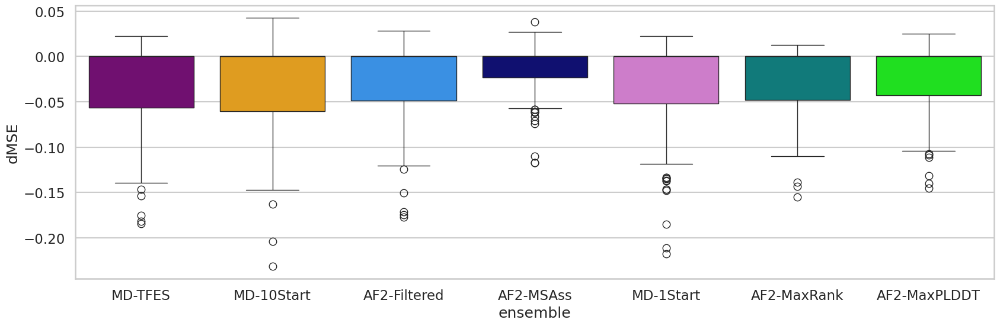

In [107]:

mean_dMSE_df = transform_naming(mean_dMSE_df)


fit_mean_dMSE_df = mean_dMSE_df[mean_dMSE_df["analysis"]=="BV"]

mean_fit_mean_dMSE_df = fit_mean_dMSE_df.groupby(["name", "replicate", "protein", "split_type"])["dMSE"].mean().reset_index()

dMSE_df = transform_naming(dMSE_df)



dMSE_df["ensemble"].unique()

methord_order = ["RW"]
fig, ax = plt.subplots(1, 1, figsize=(20, 6))

# fit_val_df = mean_dMSE_df[mean_dMSE_df["fit"] == "bench"]


sns.boxplot(data=mean_dMSE_df, x="ensemble", y="dMSE", hue="ensemble", ax=ax, palette=full_dataset_colours)
 
# ax.set_yscale("log")

plt.show()


In [108]:



RW_mean_fit_mean_dMSE_df = mean_fit_mean_dMSE_df[["name", "replicate", "dMSE"]]




dMSE_ensemble_pmf_df = pd.merge(RW_mean_fit_mean_dMSE_df, ensemble_pmf_df, on=["name", "replicate"], how="inner")

dMSE_ensemble_pmf_df.ensemble.unique()

array(['AF2-Filtered', 'AF2-MSAss', 'MD-10Start', 'MD-1Start', 'MD-TFES',
       'AF2-MaxRank', 'AF2-MaxPLDDT'], dtype=object)

In [109]:

data_frames = []

for csv in csvs:
    data_frames.append(pd.read_csv(csv))

df = pd.concat(data_frames)
df.head()


mse_df = df.dropna(subset=["mse"])

fit_val_dfval_df = mse_df[mse_df["Type"] == "Val"]


In [110]:
# val_df.ensemble.unique()

['TFES' '10Start' 'Cleaned' 'MSAss' '1Start' 'rank' 'plddt']


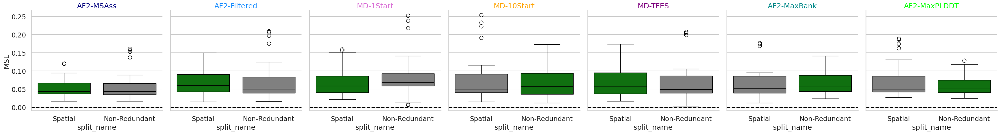

In [111]:
mse_df = df.dropna(subset=["mse"])
val_df = mse_df[mse_df["Type"] == "Val"]

val_df = transform_naming(val_df)
print(val_df["method"].unique())
fit_val_df = val_df

import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
sns.set_style("whitegrid")
# # # Create a custom palette
# _dataset_order = ["af_dirty", "af_clean", "MD_Good", "MD_Bad"]#, "af_conftop", "af_confbottom", "af_conf0.0", "af_conf0.1", "af_conf0.2", "af_conf0.3", "af_conf0.4", "af_conf0.5", "af_conf0.6", "af_conf0.7", "af_conf0.8", "af_conf0.9"]
# _dataset_order = ["MD_Bad", "af_clean"]
_dMSE_energy_df = fit_val_df[fit_val_df["split_type"].isin([ "R3", "Sp"])]

# # include only the _dataset_order
# _dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["ensemble"].isin(_dataset_order)]
import seaborn as sns
import matplotlib.pyplot as plt

# Set style
sns.set_style("whitegrid")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="ensemble", height=5, aspect=1, 
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=full_dataset_colours.keys())

# Map the boxplot with split_type colors
g.map_dataframe(sns.boxplot, x="split_name", y="mse", hue="split_type", 
                palette=split_type_dataset_colours)

# Customize the plot with colored titles
def set_colored_titles(fig):
    for ax, title in zip(fig.axes.flat, full_dataset_colours.keys()):
        # Get the color for this dataset from full_dataset_colours
        color = full_dataset_colours[title]
        # Set the title with the corresponding color
        ax.set_title(title, color=color)
        
# Apply colored titles
set_colored_titles(g)

# Set labels
g.set_ylabels("MSE")

# Add horizontal line at y=0
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')

plt.show()

['TFES' '10Start' 'Cleaned' 'MSAss' '1Start' 'rank' 'plddt']


/tmp/ipykernel_2064812/2015285198.py:54: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="center")


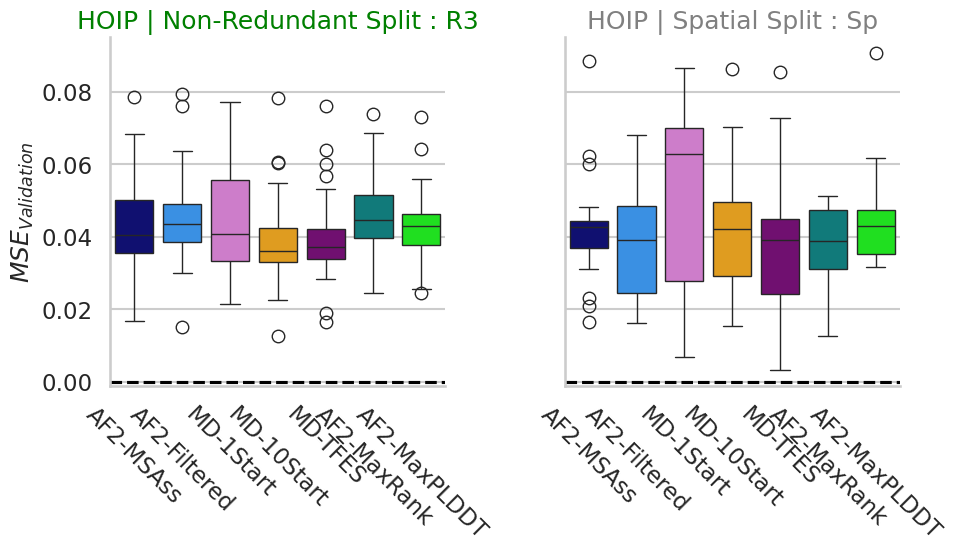

In [112]:
mse_df = df.dropna(subset=["mse"])
val_df = mse_df[mse_df["Type"] == "Val"]

val_df = transform_naming(val_df)
print(val_df["method"].unique())
fit_val_df = val_df[val_df["analysis"]=="BV"]

import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
sns.set_style("whitegrid")
# # # Create a custom palette
# _dataset_order = ["af_dirty", "af_clean", "MD_Good", "MD_Bad"]#, "af_conftop", "af_confbottom", "af_conf0.0", "af_conf0.1", "af_conf0.2", "af_conf0.3", "af_conf0.4", "af_conf0.5", "af_conf0.6", "af_conf0.7", "af_conf0.8", "af_conf0.9"]
# _dataset_order = ["MD_Bad", "af_clean"]
_dMSE_energy_df = fit_val_df[fit_val_df["split_type"].isin([ "R3", "Sp"])]

# # include only the _dataset_order
# _dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["ensemble"].isin(_dataset_order)]
import seaborn as sns
import matplotlib.pyplot as plt

# Set style
sns.set_style("whitegrid")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="split_type", height=5, aspect=1, 
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot with split_type colors
g.map_dataframe(sns.boxplot, x="ensemble", y="mse", hue="ensemble", 
                palette=full_dataset_colours, order=full_dataset_colours.keys())

# Customize the plot with colored titles
def set_colored_titles(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset from full_dataset_colours
        color = split_type_dataset_colours[title]
        # Set the title with the corresponding color
        ax.set_title("HOIP | "+split_name_mapping[title]+" Split : "+title, color=color)
        
# Apply colored titles
set_colored_titles(g)

# Set labels
g.set_ylabels("$MSE_{Validation}$")

# Add horizontal line at y=0
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')

# rotate x-tick labels
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="center")

# removw x-labels

g.set_xlabels("")

plt.show()

['TFES' '10Start' 'Cleaned' 'MSAss' '1Start' 'rank' 'plddt']


/tmp/ipykernel_2064812/2347497735.py:56: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="left")


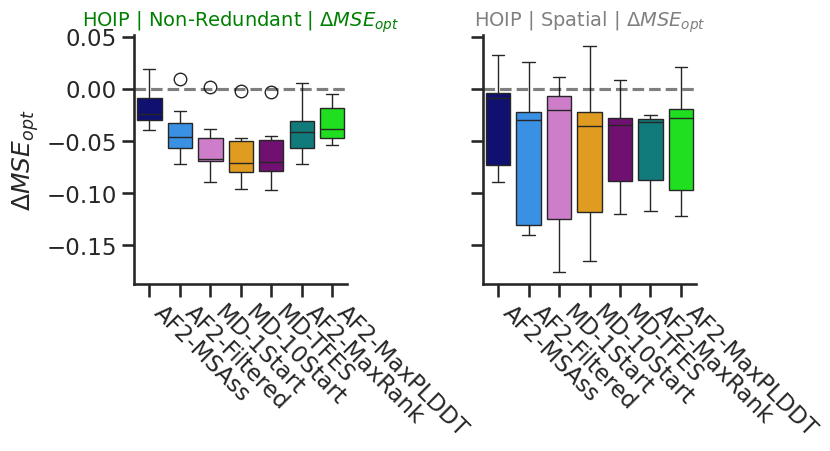

In [113]:
mse_df = df.dropna(subset=["mse"])
val_df = mse_df[mse_df["Type"] == "Val"]

val_df = transform_naming(val_df)
print(val_df["method"].unique())
fit_val_df = val_df

import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
sns.set_style("ticks")
# # # Create a custom palette
# _dataset_order = ["af_dirty", "af_clean", "MD_Good", "MD_Bad"]#, "af_conftop", "af_confbottom", "af_conf0.0", "af_conf0.1", "af_conf0.2", "af_conf0.3", "af_conf0.4", "af_conf0.5", "af_conf0.6", "af_conf0.7", "af_conf0.8", "af_conf0.9"]
# _dataset_order = ["MD_Bad", "af_clean"]
_dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]

# include only the _dataset_order
# _dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["ensemble"].isin(full_dataset_order)]
# # include only the _dataset_order
_dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["analysis"]=="BV"]
import seaborn as sns
import matplotlib.pyplot as plt

# Set style
# sns.set_style("whitegrid")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="split_type", height=4, aspect=1, 
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot with split_type colors
g.map_dataframe(sns.boxplot, x="ensemble", y="dMSE", hue="ensemble", 
                palette=full_dataset_colours, order=full_dataset_colours.keys())

# Customize the plot with colored titles
def set_colored_titles(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset from full_dataset_colours
        color = split_type_dataset_colours[title]
        # Set the title with the corresponding color
        ax.set_title("HOIP | "+split_name_mapping[title]+" | "+"$\Delta MSE_{opt}$", color=color, fontsize=14)
        
# Apply colored titles
set_colored_titles(g)

# Set labels
g.set_ylabels("$\Delta MSE_{opt}$")

# Add horizontal line at y=0
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)

# rotate x-tick labels
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="left")

# removw x-labels

g.set_xlabels("")

plt.show()

/tmp/ipykernel_2064812/3829421383.py:82: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="left")
/tmp/ipykernel_2064812/3829421383.py:82: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="left")


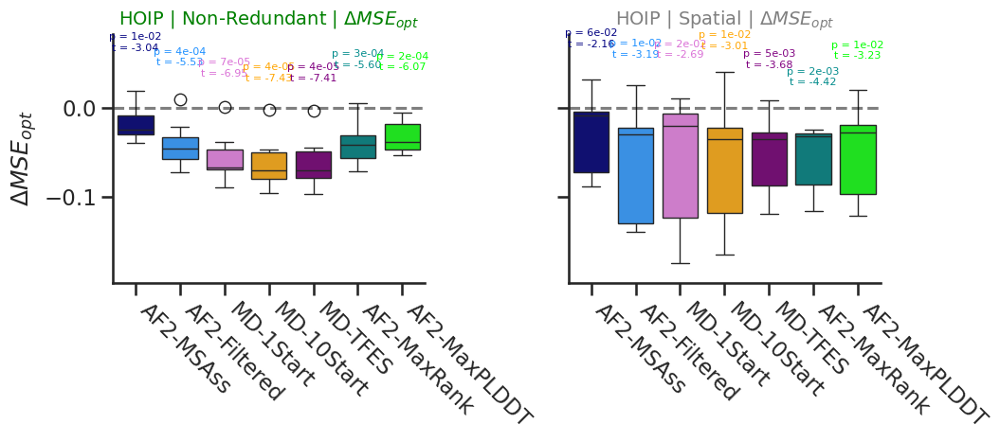

In [114]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np

def perform_two_tailed_ttest(data, ensemble):
    """
    Perform two-tailed t-test against 0 for a given ensemble.
    """
    group = data[data['ensemble'] == ensemble]['dMSE'].dropna()
    if len(group) > 0:
        t_stat, p_val = stats.ttest_1samp(group, 0)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test for {ensemble}")
        return float('nan'), float('nan')

# Set style
sns.set_style("ticks")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="split_type", height=5, aspect=1.1,
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot
def draw_boxplot(data, **kwargs):
    sns.boxplot(data=data, x="ensemble", y="dMSE", hue="ensemble",
                palette=full_dataset_colours, order=full_dataset_colours.keys())

g.map_dataframe(draw_boxplot)

# Customize the plot with colored titles and add t-test annotations
def set_colored_titles_and_annotations(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset
        color = split_type_dataset_colours[title]
        
        # Set the title with the corresponding color
        ax.set_title("HOIP | "+split_name_mapping[title]+" | "+"$\Delta MSE_{opt}$", 
                    color=color, fontsize=14)
        
        # Get the data for this subplot
        split_data = _dMSE_energy_df[_dMSE_energy_df['split_type'] == title]
        
        # Calculate y-axis limits for annotation positioning
        y_max = split_data['dMSE'].max()
        y_min = split_data['dMSE'].min()
        y_range = y_max - y_min
        
        # Add t-test annotations for each ensemble
        for idx, ensemble in enumerate(full_dataset_colours.keys()):
            t_stat, p_val = perform_two_tailed_ttest(split_data, ensemble)
            
            # Format p-value with appropriate scientific notation
            # if p_val < 0.001:
            #     p_text = f'p < 0.001'
            # else:
            
            p_text = f'p = {p_val:.0e}'
                
            # Get the box plot data for this ensemble
            box_data = split_data[split_data['ensemble'] == ensemble]['dMSE']
            q3 = box_data.quantile(0.75)
            iqr = box_data.quantile(0.75) - box_data.quantile(0.25)
            whisker = q3 + 0.15 * iqr
            # max_height = max(whisker, box_data.max())
            max_height = box_data.quantile(0.95)
            # Position annotation a fixed distance above the box
            padding = 0.05   # Adjust this value to change spacing
            y_pos = max_height + padding
            ax.text(idx, y_pos, f'{p_text}\nt = {t_stat:.2f}',
                   ha='center', va='bottom', fontsize=8,
                   color=full_dataset_colours[ensemble])
        
        # Adjust y-axis limits to accommodate annotations
        ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.2 * y_range)
        
        # Add horizontal line at y=0
        ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
        
        # Rotate x-tick labels
        ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="left")
        
        # Remove x-label
        ax.set_xlabel("")

# Apply customizations
set_colored_titles_and_annotations(g)

# Set y-label
g.set_ylabels("$\Delta MSE_{opt}$")

plt.tight_layout()
plt.show()

/tmp/ipykernel_2064812/3992346345.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(tick_labels, rotation=-60, ha="left", fontsize=16)
/tmp/ipykernel_2064812/3992346345.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(tick_labels, rotation=-60, ha="left", fontsize=16)


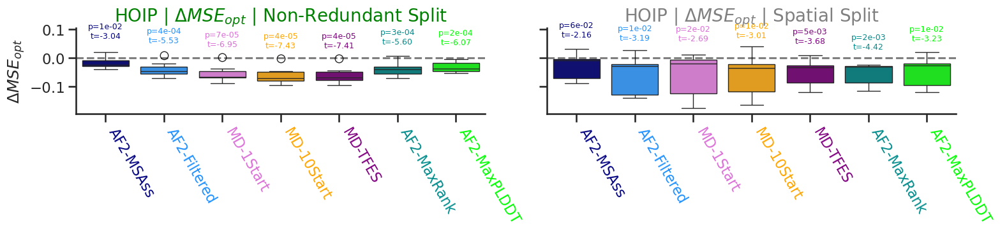

In [115]:
# Set style
sns.set_style("ticks")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="split_type", height=4, aspect=2,
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot
def draw_boxplot(data, **kwargs):
    sns.boxplot(data=data, x="ensemble", y="dMSE", hue="ensemble",
                palette=full_dataset_colours, order=full_dataset_colours.keys())

g.map_dataframe(draw_boxplot)

# Customize the plot with colored titles and add t-test annotations
def set_colored_titles_and_annotations(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset
        color = split_type_dataset_colours[title]
        
        # Set the title with the corresponding color
        ax.set_title("HOIP | "+"$\Delta MSE_{opt}$ | "+split_name_mapping[title]+ " Split",
                    color=color, fontsize=20)
        
        # Get the data for this subplot
        split_data = _dMSE_energy_df[_dMSE_energy_df['split_type'] == title]
        
        # Calculate y-axis limits for annotation positioning
        y_max = split_data['dMSE'].max()
        y_min = split_data['dMSE'].min()
        y_range = y_max - y_min
        
        # Add t-test annotations for each ensemble
        for idx, ensemble in enumerate(full_dataset_colours.keys()):
            t_stat, p_val = perform_two_tailed_ttest(split_data, ensemble)
            
            p_text = f'p={p_val:.0e}'
                
            # Get the box plot data for this ensemble
            box_data = split_data[split_data['ensemble'] == ensemble]['dMSE']
            q3 = box_data.quantile(0.75)
            iqr = box_data.quantile(0.75) - box_data.quantile(0.25)
            whisker = q3 + 0.15 * iqr
            max_height = box_data.quantile(0.95)
            padding = 0.05
            y_pos = max_height + padding
            ax.text(idx, y_pos, f'{p_text}\nt={t_stat:.2f}',
                   ha='center', va='bottom', fontsize=9,
                   color=full_dataset_colours[ensemble])
        
        # Adjust y-axis limits to accommodate annotations
        ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.3 * y_range)
        
        # Add horizontal line at y=0
        ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
        
        # Rotate x-tick labels and set colors to match bars
        tick_labels = ax.get_xticklabels()
        ax.set_xticklabels(tick_labels, rotation=-60, ha="left", fontsize=16)
        
        # Color each tick label to match its corresponding bar
        for idx, (tick_label, ensemble) in enumerate(zip(tick_labels, full_dataset_colours.keys())):
            tick_label.set_color(full_dataset_colours[ensemble])
        
        # Remove x-label
        ax.set_xlabel("")

# Apply customizations
set_colored_titles_and_annotations(g)

# Set y-label
g.set_ylabels("$\Delta MSE_{opt}$")

plt.tight_layout()
plt.show()


/tmp/ipykernel_2064812/303435572.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(tick_labels, rotation=-0, ha="center", fontsize=16)
/tmp/ipykernel_2064812/303435572.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(tick_labels, rotation=-0, ha="center", fontsize=16)


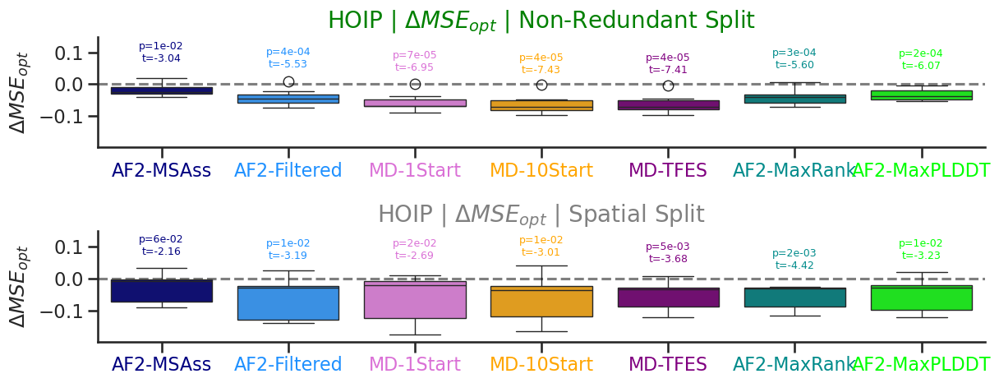

In [116]:
# Set style
sns.set_style("ticks")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, col="split_type", height=2.5, aspect=5,col_wrap=1,
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot
def draw_boxplot(data, **kwargs):
    sns.boxplot(data=data, x="ensemble", y="dMSE", hue="ensemble",
                palette=full_dataset_colours, order=full_dataset_colours.keys())

g.map_dataframe(draw_boxplot)

# Customize the plot with colored titles and add t-test annotations
def set_colored_titles_and_annotations(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset
        color = split_type_dataset_colours[title]
        
        # Set the title with the corresponding color
        ax.set_title("HOIP | "+"$\Delta MSE_{opt}$ | "+split_name_mapping[title]+ " Split",
                    color=color, fontsize=20)
        
        # Get the data for this subplot
        split_data = _dMSE_energy_df[_dMSE_energy_df['split_type'] == title]
        
        # Calculate y-axis limits for annotation positioning
        y_max = split_data['dMSE'].max()
        y_min = split_data['dMSE'].min()
        y_range = y_max - y_min
        
        # Add t-test annotations for each ensemble
        for idx, ensemble in enumerate(full_dataset_colours.keys()):
            t_stat, p_val = perform_two_tailed_ttest(split_data, ensemble)
            
            p_text = f'p={p_val:.0e}'
                
            # Get the box plot data for this ensemble
            box_data = split_data[split_data['ensemble'] == ensemble]['dMSE']
            q3 = box_data.quantile(0.75)
            iqr = box_data.quantile(0.75) - box_data.quantile(0.25)
            whisker = q3 + 0.15 * iqr
            max_height = box_data.quantile(0.95)
            padding = 0.05
            y_pos = max_height + padding
            ax.text(idx, y_pos, f'{p_text}\nt={t_stat:.2f}',
                   ha='center', va='bottom', fontsize=9,
                   color=full_dataset_colours[ensemble])
        
        # Adjust y-axis limits to accommodate annotations
        ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.5 * y_range)
        
        # Add horizontal line at y=0
        ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
        
        # Rotate x-tick labels and set colors to match bars
        tick_labels = ax.get_xticklabels()
        ax.set_xticklabels(tick_labels, rotation=-0, ha="center", fontsize=16)
        
        # Color each tick label to match its corresponding bar
        for idx, (tick_label, ensemble) in enumerate(zip(tick_labels, full_dataset_colours.keys())):
            tick_label.set_color(full_dataset_colours[ensemble])
        
        # Remove x-label
        ax.set_xlabel("")

# Apply customizations
set_colored_titles_and_annotations(g)

# Set y-label
g.set_ylabels("$\Delta MSE_{opt}$")

plt.tight_layout()
plt.show()


/tmp/ipykernel_2064812/2097574024.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(tick_labels, rotation=-20, ha="center", fontsize=16)
/tmp/ipykernel_2064812/2097574024.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(tick_labels, rotation=-20, ha="center", fontsize=16)


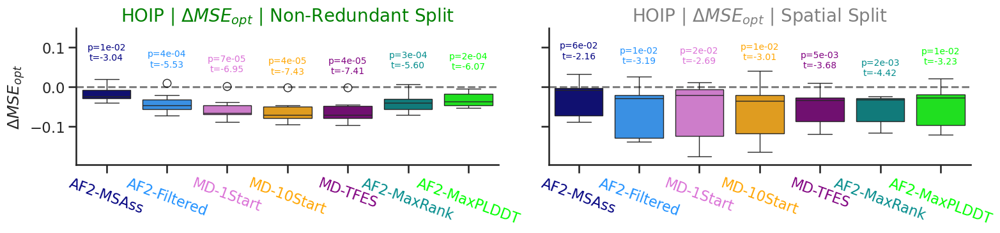

In [117]:
# Set style
sns.set_style("ticks")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, col="split_type", height=4, aspect=2,col_wrap=2,
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot
def draw_boxplot(data, **kwargs):
    sns.boxplot(data=data, x="ensemble", y="dMSE", hue="ensemble",
                palette=full_dataset_colours, order=full_dataset_colours.keys())

g.map_dataframe(draw_boxplot)

# Customize the plot with colored titles and add t-test annotations
def set_colored_titles_and_annotations(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset
        color = split_type_dataset_colours[title]
        
        # Set the title with the corresponding color
        ax.set_title("HOIP | "+"$\Delta MSE_{opt}$ | "+split_name_mapping[title]+ " Split",
                    color=color, fontsize=20)
        
        # Get the data for this subplot
        split_data = _dMSE_energy_df[_dMSE_energy_df['split_type'] == title]
        
        # Calculate y-axis limits for annotation positioning
        y_max = split_data['dMSE'].max()
        y_min = split_data['dMSE'].min()
        y_range = y_max - y_min
        
        # Add t-test annotations for each ensemble
        for idx, ensemble in enumerate(full_dataset_colours.keys()):
            t_stat, p_val = perform_two_tailed_ttest(split_data, ensemble)
            
            p_text = f'p={p_val:.0e}'
                
            # Get the box plot data for this ensemble
            box_data = split_data[split_data['ensemble'] == ensemble]['dMSE']
            q3 = box_data.quantile(0.75)
            iqr = box_data.quantile(0.75) - box_data.quantile(0.25)
            whisker = q3 + 0.15 * iqr
            max_height = box_data.quantile(0.95)
            padding = 0.05
            y_pos = max_height + padding
            ax.text(idx, y_pos, f'{p_text}\nt={t_stat:.2f}',
                   ha='center', va='bottom', fontsize=10,
                   color=full_dataset_colours[ensemble])
        
        # Adjust y-axis limits to accommodate annotations
        ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.5 * y_range)
        
        # Add horizontal line at y=0
        ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
        
        # Rotate x-tick labels and set colors to match bars
        tick_labels = ax.get_xticklabels()
        ax.set_xticklabels(tick_labels, rotation=-20, ha="center", fontsize=16)
        
        # Color each tick label to match its corresponding bar
        for idx, (tick_label, ensemble) in enumerate(zip(tick_labels, full_dataset_colours.keys())):
            tick_label.set_color(full_dataset_colours[ensemble])
        
        # Remove x-label
        ax.set_xlabel("")

# Apply customizations
set_colored_titles_and_annotations(g)

# Set y-label
g.set_ylabels("$\Delta MSE_{opt}$")

plt.tight_layout()
plt.show()


Ensemble: AF2-MSAss, split: R3, p-value: 0.014032605930601573
Ensemble: AF2-Filtered, split: R3, p-value: 0.0003657317016129904
Ensemble: MD-1Start, split: R3, p-value: 6.716375903239555e-05
Ensemble: MD-10Start, split: R3, p-value: 3.9812473047728895e-05
Ensemble: MD-TFES, split: R3, p-value: 4.0726340939848005e-05
Ensemble: AF2-MaxRank, split: R3, p-value: 0.0003350838794454036
Ensemble: AF2-MaxPLDDT, split: R3, p-value: 0.00018486322368394128
Ensemble: AF2-MSAss, split: Sp, p-value: 0.058853073262679356
Ensemble: AF2-Filtered, split: Sp, p-value: 0.010919052441410974
Ensemble: MD-1Start, split: Sp, p-value: 0.024748641623113937
Ensemble: MD-10Start, split: Sp, p-value: 0.014667895331966921
Ensemble: MD-TFES, split: Sp, p-value: 0.005080149195778502
Ensemble: AF2-MaxRank, split: Sp, p-value: 0.0016765856919656722
Ensemble: AF2-MaxPLDDT, split: Sp, p-value: 0.010349505952932256


/tmp/ipykernel_2064812/2963922032.py:60: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(tick_labels, rotation=-10, ha="center", fontsize=10)
/tmp/ipykernel_2064812/2963922032.py:60: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(tick_labels, rotation=-10, ha="center", fontsize=10)


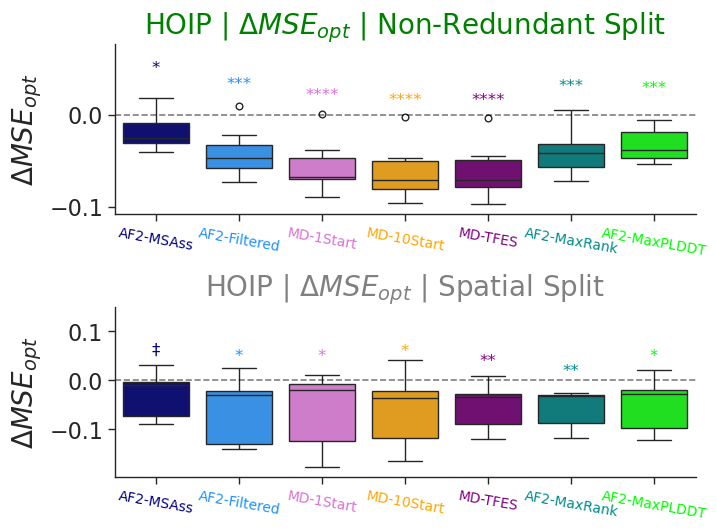

In [168]:
# Set style
sns.set_style("ticks")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, col="split_type", height=2.7, aspect=2.7,col_wrap=1,
                  sharey=False, sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot
def draw_boxplot(data, **kwargs):
    sns.boxplot(data=data, x="ensemble", y="dMSE", hue="ensemble",
                palette=full_dataset_colours, order=full_dataset_colours.keys())

g.map_dataframe(draw_boxplot)

# Customize the plot with colored titles and add t-test annotations
def set_colored_titles_and_annotations(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset
        color = split_type_dataset_colours[title]
        
        # Set the title with the corresponding color
        ax.set_title("HOIP | "+"$\Delta MSE_{opt}$ | "+split_name_mapping[title]+ " Split",
                    color=color, fontsize=20)
        
        # Get the data for this subplot
        split_data = _dMSE_energy_df[_dMSE_energy_df['split_type'] == title]
        
        # Calculate y-axis limits for annotation positioning
        y_max = split_data['dMSE'].max()
        y_min = split_data['dMSE'].min()
        y_range = y_max - y_min
        
        # Add t-test annotations for each ensemble
        for idx, ensemble in enumerate(full_dataset_colours.keys()):
            t_stat, p_val = perform_two_tailed_ttest(split_data, ensemble)
            
            p_text = f'p={p_val:.0e}'
            print(f"Ensemble: {ensemble}, split: {title}, p-value: {p_val}")
            stars = p_to_stars(p_val)
            # Get the box plot data for this ensemble
            box_data = split_data[split_data['ensemble'] == ensemble]['dMSE']
            q3 = box_data.quantile(0.75)
            iqr = box_data.quantile(0.75) - box_data.quantile(0.25)
            whisker = q3 + 0.15 * iqr
            max_height = box_data.quantile(0.95)
            padding = 0.03
            y_pos = max_height + padding
            ax.text(idx, y_pos, stars,
                   ha='center', va='bottom', fontsize=12,
                   color=full_dataset_colours[ensemble])
        
        # Adjust y-axis limits to accommodate annotations
        ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.5 * y_range)
        
        # Add horizontal line at y=0
        ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
        
        # Rotate x-tick labels and set colors to match bars
        tick_labels = ax.get_xticklabels()
        ax.set_xticklabels(tick_labels, rotation=-10, ha="center", fontsize=10)
        # ax.set_yticklabels(ax.get_ytickLafontsize=10)
        
        # Color each tick label to match its corresponding bar
        for idx, (tick_label, ensemble) in enumerate(zip(tick_labels, full_dataset_colours.keys())):
            tick_label.set_color(full_dataset_colours[ensemble])
        
        # Remove x-label
        ax.set_xlabel("")

# Apply customizations
set_colored_titles_and_annotations(g)

# Set y-label
g.set_ylabels("$\Delta MSE_{opt}$", fontsize=20)

plt.tight_layout()
plt.show()


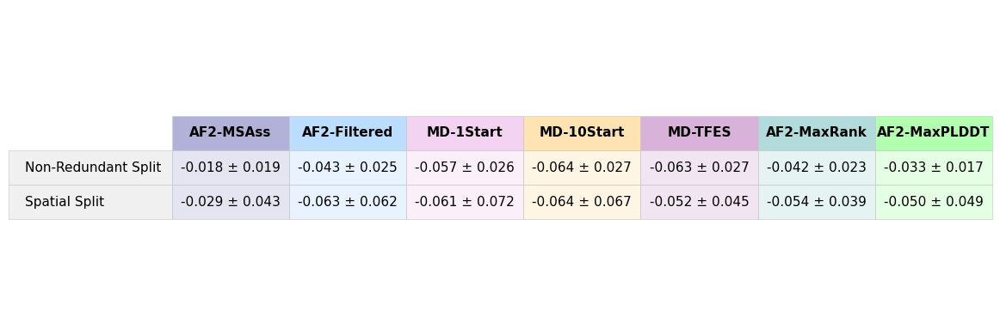

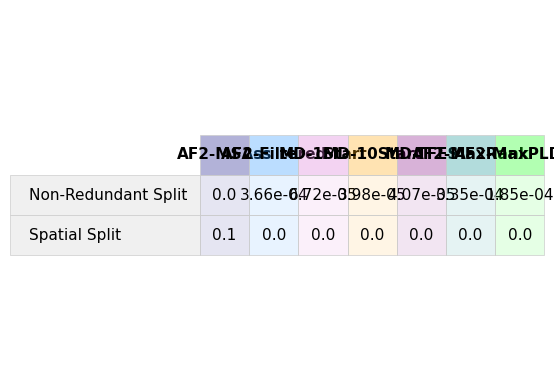

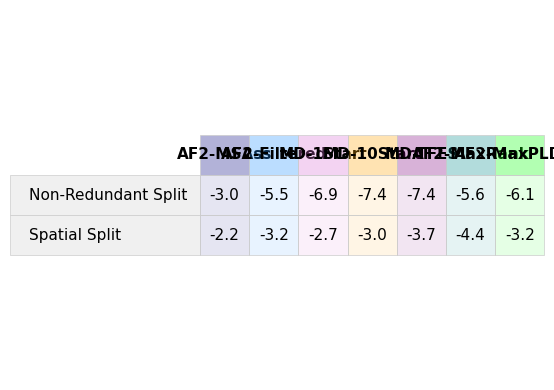

In [119]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib.colors import to_rgba
import seaborn as sns

# Set publication style
plt.style.use('default')
sns.set_palette("husl")

def create_publication_tables(dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
                            split_name_mapping, perform_two_tailed_ttest):
    """
    Create publication-quality tables for dMSE analysis
    """
    
    # Prepare data for tables
    split_types = ["R3", "Sp"]
    ensembles = list(full_dataset_colours.keys())
    
    # Initialize data structures
    mean_data = {}
    std_data = {}
    p_values = {}
    t_stats = {}
    
    # Calculate statistics for each combination
    for split_type in split_types:
        split_data = dMSE_energy_df[dMSE_energy_df['split_type'] == split_type]
        
        mean_data[split_type] = []
        std_data[split_type] = []
        p_values[split_type] = []
        t_stats[split_type] = []
        
        for ensemble in ensembles:
            ensemble_data = split_data[split_data['ensemble'] == ensemble]['dMSE']
            
            # Calculate mean and std
            mean_val = ensemble_data.mean()
            std_val = ensemble_data.std()
            
            mean_data[split_type].append(mean_val)
            std_data[split_type].append(std_val)
            
            # Perform t-test
            t_stat, p_val = perform_two_tailed_ttest(split_data, ensemble)
            p_values[split_type].append(p_val)
            t_stats[split_type].append(t_stat)
    
    # Create DataFrames
    mean_df = pd.DataFrame(mean_data, index=ensembles).T
    std_df = pd.DataFrame(std_data, index=ensembles).T
    p_df = pd.DataFrame(p_values, index=ensembles).T
    t_df = pd.DataFrame(t_stats, index=ensembles).T
    
    return mean_df, std_df, p_df, t_df

def create_colored_table(df, colors, title, figsize=(10, 3), value_format="{:.3f}", 
                        add_std=None, scientific_notation=False):
    """
    Create a publication-quality colored table
    """
    fig, ax = plt.subplots(figsize=figsize)
    ax.axis('tight')
    ax.axis('off')
    
    # Prepare table data
    if add_std is not None:
        # Combine mean ± std format
        table_data = []
        for i, row_name in enumerate(df.index):
            row_data = []
            for j, col_name in enumerate(df.columns):
                mean_val = df.iloc[i, j]
                std_val = add_std.iloc[i, j]
                if scientific_notation and abs(mean_val) < 0.001:
                    formatted_val = f"{mean_val:.2e} ± {std_val:.2e}"
                else:
                    formatted_val = f"{mean_val:.3f} ± {std_val:.3f}"
                row_data.append(formatted_val)
            table_data.append(row_data)
    else:
        # Format values
        table_data = []
        for i, row_name in enumerate(df.index):
            row_data = []
            for j, col_name in enumerate(df.columns):
                val = df.iloc[i, j]
                if scientific_notation and abs(val) < 0.001:
                    formatted_val = f"{val:.2e}"
                else:
                    formatted_val = value_format.format(val)
                row_data.append(formatted_val)
            table_data.append(row_data)
    
    # Create table
    table = ax.table(cellText=table_data,
                    rowLabels=[f"{split_name_mapping.get(idx, idx)} Split" for idx in df.index],
                    colLabels=df.columns,
                    cellLoc='center',
                    loc='center')
    
    # Style the table
    table.auto_set_font_size(False)
    table.set_fontsize(11)
    table.scale(1.2, 2)
    
    # Color the columns by ensemble
    n_rows, n_cols = len(df.index), len(df.columns)
    
    # Header row colors
    for j, col_name in enumerate(df.columns):
        color = colors.get(col_name, '#ffffff')
        rgba_color = to_rgba(color, alpha=0.3)
        table[(0, j)].set_facecolor(rgba_color)
        table[(0, j)].set_text_props(weight='bold')
    
    # Data cell colors (lighter)
    for i in range(1, n_rows + 1):
        for j, col_name in enumerate(df.columns):
            color = colors.get(col_name, '#ffffff')
            rgba_color = to_rgba(color, alpha=0.1)
            table[(i, j)].set_facecolor(rgba_color)
    
    # Style all cells and add borders
    for key, cell in table.get_celld().items():
        cell.set_linewidth(0.5)
        cell.set_edgecolor('#cccccc')
        
        # Style row labels (they typically have negative column indices)
        if key[1] < 0:  # This is a row label
            cell.set_facecolor('#f0f0f0')
            if key[0] == 0:  # Header row
                cell.set_text_props(weight='bold')
    
    # plt.title(title, fontsize=14, weight='bold', pad=20)
    plt.tight_layout()
    
    return fig, ax

# Main function to create all tables
def generate_publication_tables(dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
                              split_name_mapping, perform_two_tailed_ttest):
    """
    Generate all publication tables
    """
    
    # Calculate statistics
    mean_df, std_df, p_df, t_df = create_publication_tables(
        dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
        split_name_mapping, perform_two_tailed_ttest
    )
    
    # Create main data table (mean ± std)
    fig1, ax1 = create_colored_table(
        mean_df, full_dataset_colours, 
        r'$\Delta MSE_{opt}$ (Mean ± Standard Deviation)',
        figsize=(12, 4),
        add_std=std_df
    )
    
    # Create p-values table
    fig2, ax2 = create_colored_table(
        p_df, full_dataset_colours, 
        'Statistical Significance (p-values)',
        figsize=(6, 4),
        value_format="{:.1f}",
        scientific_notation=True
    )
    
    # Create t-statistics table
    fig3, ax3 = create_colored_table(
        t_df, full_dataset_colours, 
        'Test Statistics (t-values)',
        figsize=(6, 4),
        value_format="{:.1f}"

    )
    
    return fig1, fig2, fig3

# Example usage:
# Assuming you have your data and functions defined:
fig_main, fig_p, fig_t = generate_publication_tables(
    _dMSE_energy_df, 
    full_dataset_colours, 
    split_type_dataset_colours, 
    split_name_mapping, 
    perform_two_tailed_ttest
)

# To save the figures:
# fig_main.savefig('dmse_main_table.png', dpi=300, bbox_inches='tight')
# fig_p.savefig('dmse_pvalues_table.png', dpi=300, bbox_inches='tight')
# fig_t.savefig('dmse_tstats_table.png', dpi=300, bbox_inches='tight')

# Alternative: Create a combined figure with all three tables
def create_combined_figure(dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
                          split_name_mapping, perform_two_tailed_ttest):
    """
    Create a combined figure with all three tables
    """
    # Calculate statistics
    mean_df, std_df, p_df, t_df = create_publication_tables(
        dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
        split_name_mapping, perform_two_tailed_ttest
    )
    
    fig = plt.figure(figsize=(16, 12))
    
    # Main table (larger)
    ax1 = plt.subplot(3, 1, 1)
    ax1.axis('tight')
    ax1.axis('off')
    
    # Prepare main table data (mean ± std)
    table_data = []
    for i, row_name in enumerate(mean_df.index):
        row_data = []
        for j, col_name in enumerate(mean_df.columns):
            mean_val = mean_df.iloc[i, j]
            std_val = std_df.iloc[i, j]
            formatted_val = f"{mean_val:.3f} ± {std_val:.3f}"
            row_data.append(formatted_val)
        table_data.append(row_data)
    
    table1 = ax1.table(cellText=table_data,
                      rowLabels=[f"{split_name_mapping.get(idx, idx)} Split" for idx in mean_df.index],
                      colLabels=mean_df.columns,
                      cellLoc='center',
                      loc='center')
    
    # Style main table
    table1.auto_set_font_size(False)
    table1.set_fontsize(12)
    table1.scale(1.3, 2.5)
    
    # Color main table
    for j, col_name in enumerate(mean_df.columns):
        color = full_dataset_colours.get(col_name, '#ffffff')
        rgba_color = to_rgba(color, alpha=0.3)
        table1[(0, j)].set_facecolor(rgba_color)
        table1[(0, j)].set_text_props(weight='bold')
        
        for i in range(1, len(mean_df.index) + 1):
            rgba_light = to_rgba(color, alpha=0.1)
            table1[(i, j)].set_facecolor(rgba_light)
    
    ax1.set_title(r'$\Delta MSE_{opt}$ (Mean ± Standard Deviation)', 
                  fontsize=16, weight='bold', pad=30)
    
    # P-values table
    ax2 = plt.subplot(3, 2, 3)
    ax2.axis('tight')
    ax2.axis('off')
    
    p_table_data = []
    for i, row_name in enumerate(p_df.index):
        row_data = []
        for j, col_name in enumerate(p_df.columns):
            val = p_df.iloc[i, j]
            if val < 0.001:
                formatted_val = f"{val:.2e}"
            else:
                formatted_val = f"{val:.3f}"
            row_data.append(formatted_val)
        p_table_data.append(row_data)
    
    table2 = ax2.table(cellText=p_table_data,
                      rowLabels=[f"{split_name_mapping.get(idx, idx)}" for idx in p_df.index],
                      colLabels=p_df.columns,
                      cellLoc='center',
                      loc='center')
    
    table2.auto_set_font_size(False)
    table2.set_fontsize(10)
    table2.scale(1.2, 2)
    
    ax2.set_title('p-values', fontsize=12, weight='bold', pad=20)
    
    # T-statistics table
    ax3 = plt.subplot(3, 2, 4)
    ax3.axis('tight')
    ax3.axis('off')
    
    t_table_data = []
    for i, row_name in enumerate(t_df.index):
        row_data = []
        for j, col_name in enumerate(t_df.columns):
            val = t_df.iloc[i, j]
            formatted_val = f"{val:.3f}"
            row_data.append(formatted_val)
        t_table_data.append(row_data)
    
    table3 = ax3.table(cellText=t_table_data,
                      rowLabels=[f"{split_name_mapping.get(idx, idx)}" for idx in t_df.index],
                      colLabels=t_df.columns,
                      cellLoc='center',
                      loc='center')
    
    table3.auto_set_font_size(False)
    table3.set_fontsize(10)
    table3.scale(1.2, 2)
    
    ax3.set_title('t-statistics', fontsize=12, weight='bold', pad=20)
    
    # Color p-values and t-stats tables
    for table in [table2, table3]:
        for j, col_name in enumerate(p_df.columns):
            color = full_dataset_colours.get(col_name, '#ffffff')
            rgba_color = to_rgba(color, alpha=0.2)
            table[(0, j)].set_facecolor(rgba_color)
            table[(0, j)].set_text_props(weight='bold')
            
            for i in range(1, len(p_df.index) + 1):
                rgba_light = to_rgba(color, alpha=0.05)
                table[(i, j)].set_facecolor(rgba_light)
    
    plt.tight_layout()
    return fig

# Usage for combined figure:
# combined_fig = create_combined_figure(
#     dMSE_energy_df, 
#     full_dataset_colours, 
#     split_type_dataset_colours, 
#     split_name_mapping, 
#     perform_two_tailed_ttest
# )
# combined_fig.savefig('dmse_combined_tables.png', dpi=300, bbox_inches='tight')

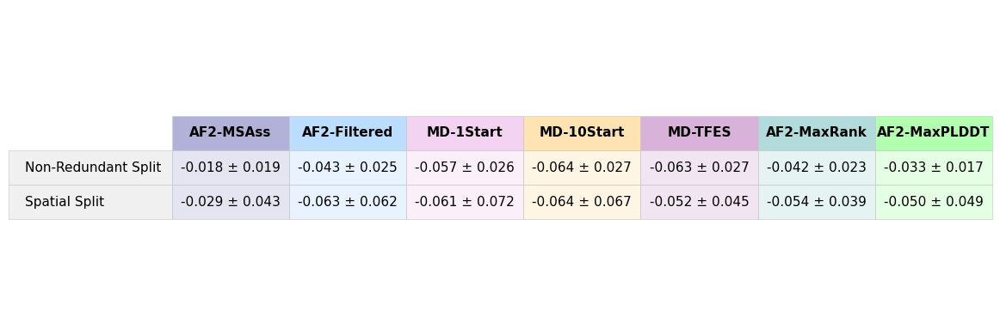

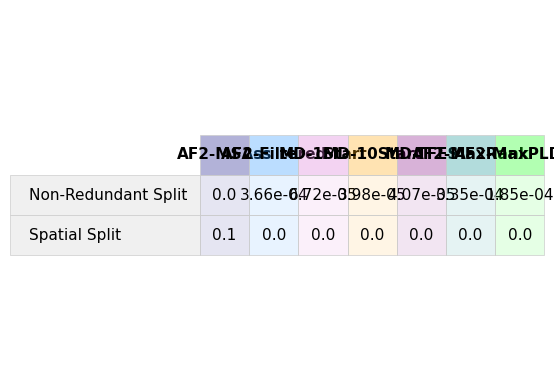

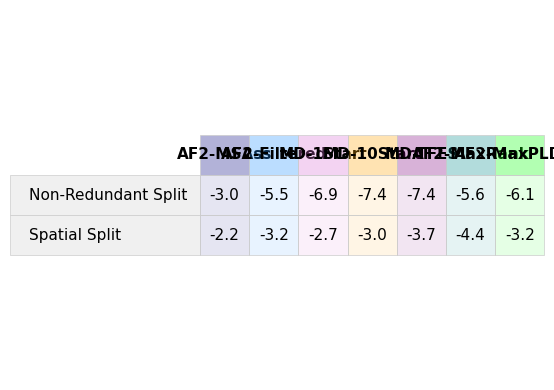

In [120]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib.colors import to_rgba
import seaborn as sns

# Set publication style
plt.style.use('default')
sns.set_palette("husl")

def create_publication_tables(dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
                            split_name_mapping, perform_two_tailed_ttest):
    """
    Create publication-quality tables for dMSE analysis
    """
    
    # Prepare data for tables
    split_types = ["R3", "Sp"]
    ensembles = list(full_dataset_colours.keys())
    
    # Initialize data structures
    mean_data = {}
    std_data = {}
    p_values = {}
    t_stats = {}
    
    # Calculate statistics for each combination
    for split_type in split_types:
        split_data = dMSE_energy_df[dMSE_energy_df['split_type'] == split_type]
        
        mean_data[split_type] = []
        std_data[split_type] = []
        p_values[split_type] = []
        t_stats[split_type] = []
        
        for ensemble in ensembles:
            ensemble_data = split_data[split_data['ensemble'] == ensemble]['dMSE']
            
            # Calculate mean and std
            mean_val = ensemble_data.mean()
            std_val = ensemble_data.std()
            
            mean_data[split_type].append(mean_val)
            std_data[split_type].append(std_val)
            
            # Perform t-test
            t_stat, p_val = perform_two_tailed_ttest(split_data, ensemble)
            p_values[split_type].append(p_val)
            t_stats[split_type].append(t_stat)
    
    # Create DataFrames
    mean_df = pd.DataFrame(mean_data, index=ensembles).T
    std_df = pd.DataFrame(std_data, index=ensembles).T
    p_df = pd.DataFrame(p_values, index=ensembles).T
    t_df = pd.DataFrame(t_stats, index=ensembles).T
    
    return mean_df, std_df, p_df, t_df

def create_colored_table(df, colors, title, figsize=(10, 3), value_format="{:.3f}", 
                        add_std=None, scientific_notation=False):
    """
    Create a publication-quality colored table
    """
    fig, ax = plt.subplots(figsize=figsize)
    ax.axis('tight')
    ax.axis('off')
    
    # Prepare table data
    if add_std is not None:
        # Combine mean ± std format
        table_data = []
        for i, row_name in enumerate(df.index):
            row_data = []
            for j, col_name in enumerate(df.columns):
                mean_val = df.iloc[i, j]
                std_val = add_std.iloc[i, j]
                if scientific_notation and abs(mean_val) < 0.001:
                    formatted_val = f"{mean_val:.2e} ± {std_val:.2e}"
                else:
                    formatted_val = f"{mean_val:.3f} ± {std_val:.3f}"
                row_data.append(formatted_val)
            table_data.append(row_data)
    else:
        # Format values
        table_data = []
        for i, row_name in enumerate(df.index):
            row_data = []
            for j, col_name in enumerate(df.columns):
                val = df.iloc[i, j]
                if scientific_notation and abs(val) < 0.001:
                    formatted_val = f"{val:.2e}"
                else:
                    formatted_val = value_format.format(val)
                row_data.append(formatted_val)
            table_data.append(row_data)
    
    # Create table
    table = ax.table(cellText=table_data,
                    rowLabels=[f"{split_name_mapping.get(idx, idx)} Split" for idx in df.index],
                    colLabels=df.columns,
                    cellLoc='center',
                    loc='center')
    
    # Style the table
    table.auto_set_font_size(False)
    table.set_fontsize(11)
    table.scale(1.2, 2)
    
    # Color the columns by ensemble
    n_rows, n_cols = len(df.index), len(df.columns)
    
    # Header row colors
    for j, col_name in enumerate(df.columns):
        color = colors.get(col_name, '#ffffff')
        rgba_color = to_rgba(color, alpha=0.3)
        table[(0, j)].set_facecolor(rgba_color)
        table[(0, j)].set_text_props(weight='bold')
    
    # Data cell colors (lighter)
    for i in range(1, n_rows + 1):
        for j, col_name in enumerate(df.columns):
            color = colors.get(col_name, '#ffffff')
            rgba_color = to_rgba(color, alpha=0.1)
            table[(i, j)].set_facecolor(rgba_color)
    
    # Style all cells and add borders
    for key, cell in table.get_celld().items():
        cell.set_linewidth(0.5)
        cell.set_edgecolor('#cccccc')
        
        # Style row labels (they typically have negative column indices)
        if key[1] < 0:  # This is a row label
            cell.set_facecolor('#f0f0f0')
            if key[0] == 0:  # Header row
                cell.set_text_props(weight='bold')
    
    # plt.title(title, fontsize=14, weight='bold', pad=20)
    plt.tight_layout()
    
    return fig, ax

# Main function to create all tables
def generate_publication_tables(dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
                              split_name_mapping, perform_two_tailed_ttest):
    """
    Generate all publication tables
    """
    
    # Calculate statistics
    mean_df, std_df, p_df, t_df = create_publication_tables(
        dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
        split_name_mapping, perform_two_tailed_ttest
    )
    
    # Create main data table (mean ± std)
    fig1, ax1 = create_colored_table(
        mean_df, full_dataset_colours, 
        r'$\Delta MSE_{opt}$ (Mean ± Standard Deviation)',
        figsize=(12, 4),
        add_std=std_df
    )
    
    # Create p-values table
    fig2, ax2 = create_colored_table(
        p_df, full_dataset_colours, 
        'Statistical Significance (p-values)',
        figsize=(6, 4),
        value_format="{:.1f}",
        scientific_notation=True
    )
    
    # Create t-statistics table
    fig3, ax3 = create_colored_table(
        t_df, full_dataset_colours, 
        'Test Statistics (t-values)',
        figsize=(6, 4),
        value_format="{:.1f}"

    )
    
    return fig1, fig2, fig3

# Example usage:
# Assuming you have your data and functions defined:
fig_main, fig_p, fig_t = generate_publication_tables(
    _dMSE_energy_df, 
    full_dataset_colours, 
    split_type_dataset_colours, 
    split_name_mapping, 
    perform_two_tailed_ttest
)

# To save the figures:
# fig_main.savefig('dmse_main_table.png', dpi=300, bbox_inches='tight')
# fig_p.savefig('dmse_pvalues_table.png', dpi=300, bbox_inches='tight')
# fig_t.savefig('dmse_tstats_table.png', dpi=300, bbox_inches='tight')

# Alternative: Create a combined figure with all three tables
def create_combined_figure(dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
                          split_name_mapping, perform_two_tailed_ttest):
    """
    Create a combined figure with all three tables
    """
    # Calculate statistics
    mean_df, std_df, p_df, t_df = create_publication_tables(
        dMSE_energy_df, full_dataset_colours, split_type_dataset_colours, 
        split_name_mapping, perform_two_tailed_ttest
    )
    
    fig = plt.figure(figsize=(16, 12))
    
    # Main table (larger)
    ax1 = plt.subplot(3, 1, 1)
    ax1.axis('tight')
    ax1.axis('off')
    
    # Prepare main table data (mean ± std)
    table_data = []
    for i, row_name in enumerate(mean_df.index):
        row_data = []
        for j, col_name in enumerate(mean_df.columns):
            mean_val = mean_df.iloc[i, j]
            std_val = std_df.iloc[i, j]
            formatted_val = f"{mean_val:.3f} ± {std_val:.3f}"
            row_data.append(formatted_val)
        table_data.append(row_data)
    
    table1 = ax1.table(cellText=table_data,
                      rowLabels=[f"{split_name_mapping.get(idx, idx)} Split" for idx in mean_df.index],
                      colLabels=mean_df.columns,
                      cellLoc='center',
                      loc='center')
    
    # Style main table
    table1.auto_set_font_size(False)
    table1.set_fontsize(12)
    table1.scale(1.3, 2.5)
    
    # Color main table
    for j, col_name in enumerate(mean_df.columns):
        color = full_dataset_colours.get(col_name, '#ffffff')
        rgba_color = to_rgba(color, alpha=0.3)
        table1[(0, j)].set_facecolor(rgba_color)
        table1[(0, j)].set_text_props(weight='bold')
        
        for i in range(1, len(mean_df.index) + 1):
            rgba_light = to_rgba(color, alpha=0.1)
            table1[(i, j)].set_facecolor(rgba_light)
    
    ax1.set_title(r'$\Delta MSE_{opt}$ (Mean ± Standard Deviation)', 
                  fontsize=16, weight='bold', pad=30)
    
    # P-values table
    ax2 = plt.subplot(3, 2, 3)
    ax2.axis('tight')
    ax2.axis('off')
    
    p_table_data = []
    for i, row_name in enumerate(p_df.index):
        row_data = []
        for j, col_name in enumerate(p_df.columns):
            val = p_df.iloc[i, j]
            if val < 0.001:
                formatted_val = f"{val:.2e}"
            else:
                formatted_val = f"{val:.3f}"
            row_data.append(formatted_val)
        p_table_data.append(row_data)
    
    table2 = ax2.table(cellText=p_table_data,
                      rowLabels=[f"{split_name_mapping.get(idx, idx)}" for idx in p_df.index],
                      colLabels=p_df.columns,
                      cellLoc='center',
                      loc='center')
    
    table2.auto_set_font_size(False)
    table2.set_fontsize(10)
    table2.scale(1.2, 2)
    
    ax2.set_title('p-values', fontsize=12, weight='bold', pad=20)
    
    # T-statistics table
    ax3 = plt.subplot(3, 2, 4)
    ax3.axis('tight')
    ax3.axis('off')
    
    t_table_data = []
    for i, row_name in enumerate(t_df.index):
        row_data = []
        for j, col_name in enumerate(t_df.columns):
            val = t_df.iloc[i, j]
            formatted_val = f"{val:.3f}"
            row_data.append(formatted_val)
        t_table_data.append(row_data)
    
    table3 = ax3.table(cellText=t_table_data,
                      rowLabels=[f"{split_name_mapping.get(idx, idx)}" for idx in t_df.index],
                      colLabels=t_df.columns,
                      cellLoc='center',
                      loc='center')
    
    table3.auto_set_font_size(False)
    table3.set_fontsize(10)
    table3.scale(1.2, 2)
    
    ax3.set_title('t-statistics', fontsize=12, weight='bold', pad=20)
    
    # Color p-values and t-stats tables
    for table in [table2, table3]:
        for j, col_name in enumerate(p_df.columns):
            color = full_dataset_colours.get(col_name, '#ffffff')
            rgba_color = to_rgba(color, alpha=0.2)
            table[(0, j)].set_facecolor(rgba_color)
            table[(0, j)].set_text_props(weight='bold')
            
            for i in range(1, len(p_df.index) + 1):
                rgba_light = to_rgba(color, alpha=0.05)
                table[(i, j)].set_facecolor(rgba_light)
    
    plt.tight_layout()
    return fig

# Usage for combined figure:
# combined_fig = create_combined_figure(
#     dMSE_energy_df, 
#     full_dataset_colours, 
#     split_type_dataset_colours, 
#     split_name_mapping, 
#     perform_two_tailed_ttest
# )
# combined_fig.savefig('dmse_combined_tables.png', dpi=300, bbox_inches='tight')

['TFES' '10Start' 'Cleaned' 'MSAss' '1Start' 'rank' 'plddt']


/tmp/ipykernel_2064812/855103211.py:56: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="center")


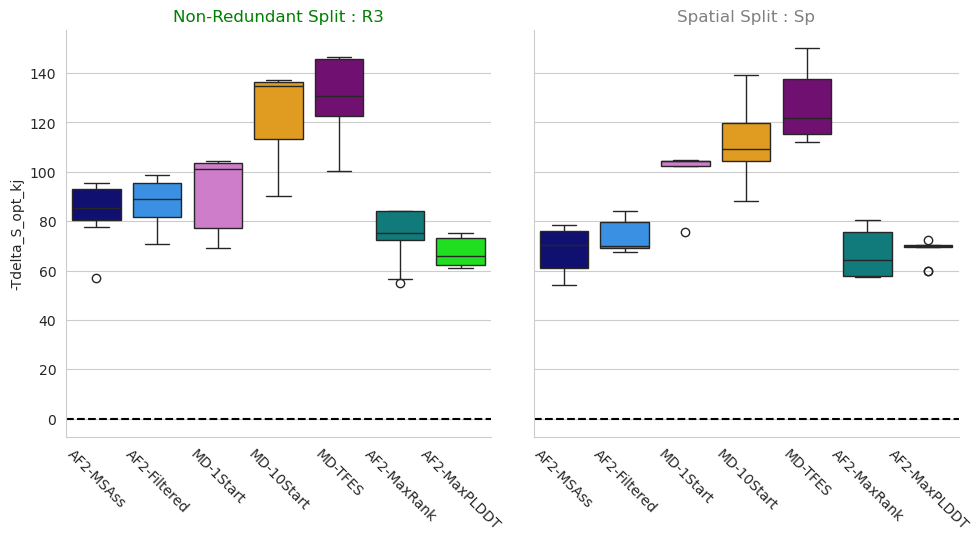

In [121]:
mse_df = df.dropna(subset=["mse"])
val_df = mse_df[mse_df["Type"] == "Val"]

val_df = transform_naming(val_df)
print(val_df["method"].unique())
fit_val_df = val_df

import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
sns.set_style("whitegrid")
# # # Create a custom palette
# _dataset_order = ["af_dirty", "af_clean", "MD_Good", "MD_Bad"]#, "af_conftop", "af_confbottom", "af_conf0.0", "af_conf0.1", "af_conf0.2", "af_conf0.3", "af_conf0.4", "af_conf0.5", "af_conf0.6", "af_conf0.7", "af_conf0.8", "af_conf0.9"]
# _dataset_order = ["MD_Bad", "af_clean"]
_dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]

# include only the _dataset_order
# _dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["ensemble"].isin(full_dataset_order)]
# # include only the _dataset_order
_dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["analysis"]=="BV"]
import seaborn as sns
import matplotlib.pyplot as plt

# Set style
sns.set_style("whitegrid")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="split_type", height=5, aspect=1, 
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot with split_type colors
g.map_dataframe(sns.boxplot, x="ensemble", y="-Tdelta_S_opt_kj", hue="ensemble", 
                palette=full_dataset_colours, order=full_dataset_colours.keys())

# Customize the plot with colored titles
def set_colored_titles(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset from full_dataset_colours
        color = split_type_dataset_colours[title]
        # Set the title with the corresponding color
        ax.set_title(split_name_mapping[title]+" Split : "+title, color=color)
        
# Apply colored titles
set_colored_titles(g)

# Set labels
g.set_ylabels("-Tdelta_S_opt_kj")

# Add horizontal line at y=0
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')

# rotate x-tick labels
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="center")

# removw x-labels

g.set_xlabels("")

plt.show()

In [122]:
dMSE_ensemble_pmf_df

,name,replicate,dMSE,dataset,system,system_name,calc_name,avg_H_opt,avg_H_opt_kj,avg_S_opt,...,likelihood_opt,likelihood_conf,quasi_likelihood,protein,method,fit,ensemble,split_type,split_name,analysis
0,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,1,-0.051038,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_1,test_HOIP_AF2_Cleaned_1,25062.249847,25.062250,-2.970819,...,0.961291,0.935729,0.962498,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
1,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,10,-0.021098,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_10,test_HOIP_AF2_Cleaned_10,14012.893928,14.012894,-60.139091,...,0.966809,0.945254,0.968007,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
2,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,2,-0.059236,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_2,test_HOIP_AF2_Cleaned_2,8861.141229,8.861141,-217.266310,...,0.972162,0.960045,0.971636,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
3,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,3,-0.028710,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_3,test_HOIP_AF2_Cleaned_3,12231.977548,12.231978,-89.114859,...,0.971117,0.954332,0.972943,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
4,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,4,-0.048437,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_4,test_HOIP_AF2_Cleaned_4,17668.427603,17.668428,-10.049734,...,0.961879,0.938022,0.963247,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275,HOIP_max_plddt_BV_bench_s_naive_sequential,5,-0.070948,test,HOIP_max_plddt_BV_bench_s_naive_sequential,HOIP_max_plddt_BV_bench_s_naive_sequential_5,test_HOIP_max_plddt_5,13064.561935,13.064562,-29.341115,...,0.971399,0.951764,0.971537,HOIP,plddt,BV,AF2-MaxPLDDT,s,Sequence,BV
276,HOIP_max_plddt_BV_bench_s_naive_sequential,6,-0.013799,test,HOIP_max_plddt_BV_bench_s_naive_sequential,HOIP_max_plddt_BV_bench_s_naive_sequential_6,test_HOIP_max_plddt_6,14092.725270,14.092725,-42.016572,...,0.972112,0.953452,0.972108,HOIP,plddt,BV,AF2-MaxPLDDT,s,Sequence,BV
277,HOIP_max_plddt_BV_bench_s_naive_sequential,7,-0.023478,test,HOIP_max_plddt_BV_bench_s_naive_sequential,HOIP_max_plddt_BV_bench_s_naive_sequential_7,test_HOIP_max_plddt_7,14570.048062,14.570048,-26.724029,...,0.971170,0.950942,0.971442,HOIP,plddt,BV,AF2-MaxPLDDT,s,Sequence,BV
278,HOIP_max_plddt_BV_bench_s_naive_sequential,8,-0.072405,test,HOIP_max_plddt_BV_bench_s_naive_sequential,HOIP_max_plddt_BV_bench_s_naive_sequential_8,test_HOIP_max_plddt_8,13223.007237,13.223007,-22.175363,...,0.971146,0.951361,0.971248,HOIP,plddt,BV,AF2-MaxPLDDT,s,Sequence,BV


['TFES' '10Start' 'Cleaned' 'MSAss' '1Start' 'rank' 'plddt']


/tmp/ipykernel_2064812/3499336675.py:56: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="center")


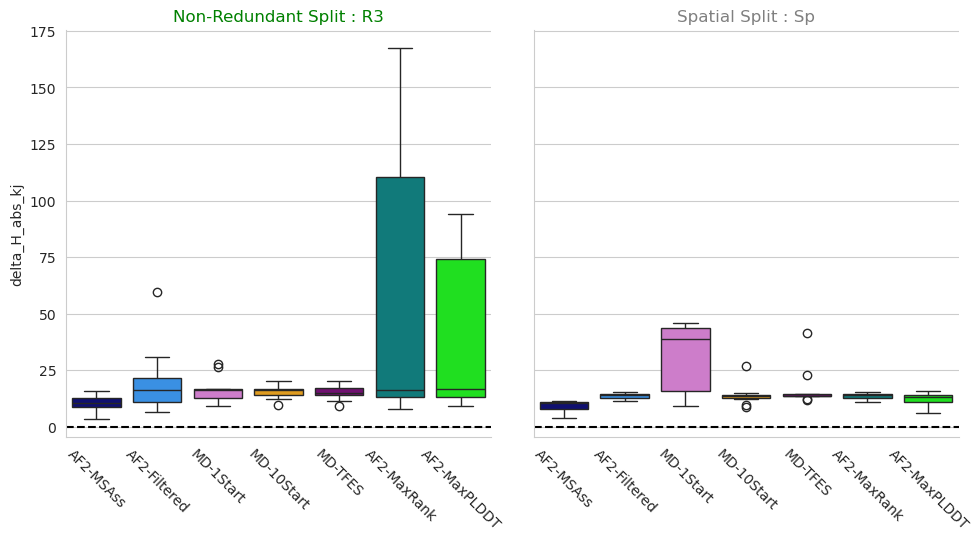

In [123]:
mse_df = df.dropna(subset=["mse"])
val_df = mse_df[mse_df["Type"] == "Val"]

val_df = transform_naming(val_df)
print(val_df["method"].unique())
fit_val_df = val_df

import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")?
sns.set_style("whitegrid")
# # # Create a custom palette
# _dataset_order = ["af_dirty", "af_clean", "MD_Good", "MD_Bad"]#, "af_conftop", "af_confbottom", "af_conf0.0", "af_conf0.1", "af_conf0.2", "af_conf0.3", "af_conf0.4", "af_conf0.5", "af_conf0.6", "af_conf0.7", "af_conf0.8", "af_conf0.9"]
# _dataset_order = ["MD_Bad", "af_clean"]
_dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]

# include only the _dataset_order
# _dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["ensemble"].isin(full_dataset_order)]
# # include only the _dataset_order
_dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["analysis"]=="BV"]
import seaborn as sns
import matplotlib.pyplot as plt

# Set style
sns.set_style("whitegrid")

# Create the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="split_type", height=5, aspect=1, 
                  sharey='row', sharex='row', row_order=["HOIP"], col_order=["R3", "Sp"])

# Map the boxplot with split_type colors
g.map_dataframe(sns.boxplot, x="ensemble", y="delta_H_abs_kj", hue="ensemble", 
                palette=full_dataset_colours, order=full_dataset_colours.keys())

# Customize the plot with colored titles
def set_colored_titles(fig):
    for ax, title in zip(fig.axes.flat, ["R3", "Sp"]):
        # Get the color for this dataset from full_dataset_colours
        color = split_type_dataset_colours[title]
        # Set the title with the corresponding color
        ax.set_title(split_name_mapping[title]+" Split : "+title, color=color)
        
# Apply colored titles
set_colored_titles(g)

# Set labels
g.set_ylabels("delta_H_abs_kj")

# Add horizontal line at y=0
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')

# rotate x-tick labels
for ax in g.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha="center")

# removw x-labels

g.set_xlabels("")

plt.show()

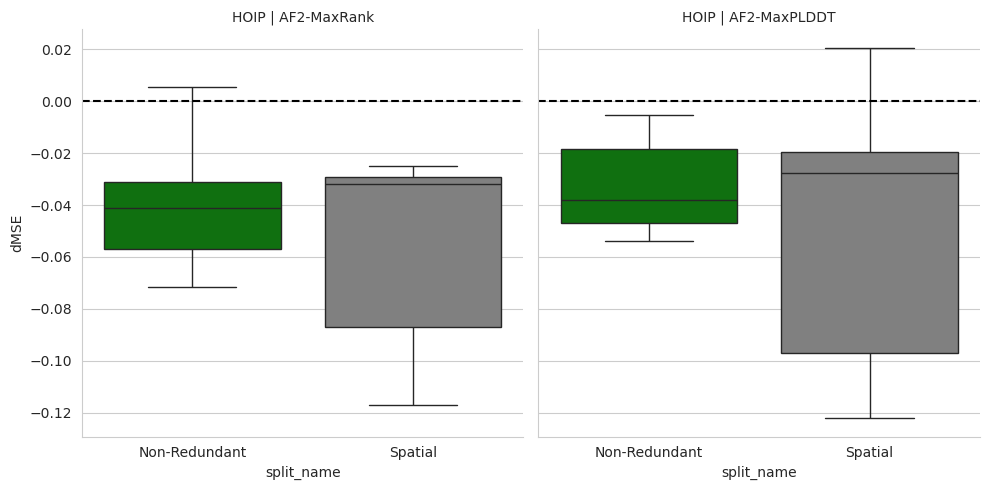

In [124]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
# sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette
_dataset_order = ["af_dirty", "af_clean", "MD_Good", "MD_Bad"]#, "af_conftop", "af_confbottom", "af_conf0.0", "af_conf0.1", "af_conf0.2", "af_conf0.3", "af_conf0.4", "af_conf0.5", "af_conf0.6", "af_conf0.7", "af_conf0.8", "af_conf0.9"]
# _dataset_order = ["af_dirty", "af_clean", "1Start", "10Start", "TFES"]
_dataset_order = ["af_clean", "1Start"]

_dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin([ "R3", "Sp"])]

# include only the _dataset_order
_dMSE_energy_df = _dMSE_energy_df[_dMSE_energy_df["analysis"]=="BV"]

# Create the FacetGrid
# Map the boxplot to the FacetGrid
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="ensemble", height=5, aspect=1, sharey='row', sharex='row', row_order=["HOIP"], col_order=full_dataset_order)
g.map_dataframe(sns.boxplot, x="split_name", y="dMSE", hue="split_type", palette={"R3": "green", "Sp": "grey"})
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}")#, fontsize=16, fontweight="bold")
# g.set_xlabels("energy_difference", fontsize=14)
g.set_ylabels("dMSE")#, fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
# g.tight_layout()
# Add legend
# g.set(yscale="log")

# Add a line at y = 0
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')

# g.add_legend(title="split type")#, fontsize=12)
# Show the plot
# g.set(ylim=(-3, 0))
plt.show()

In [125]:
dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["ensemble"].isin(full_dataset_order)]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["analysis"]=="BV"]



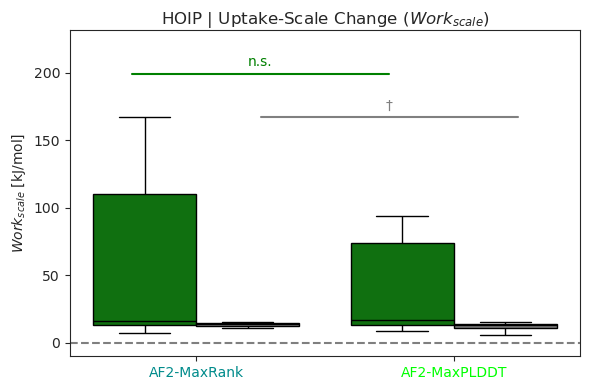

In [126]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")
y_metric = "delta_H_abs_kj"

def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6, 4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}", pad=0)

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.2
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max + (idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    stars = p_to_stars(p_val)
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height + 0.02 * y_range,
            stars,
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.4 * y_range)
# set log scale

plt.tight_layout()
plt.show()

In [127]:
_dMSE_energy_df

,name,replicate,dMSE,dataset,system,system_name,calc_name,avg_H_opt,avg_H_opt_kj,avg_S_opt,...,likelihood_opt,likelihood_conf,quasi_likelihood,protein,method,fit,ensemble,split_type,split_name,analysis
0,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,1,-0.051038,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_1,test_HOIP_AF2_Cleaned_1,25062.249847,25.062250,-2.970819,...,0.961291,0.935729,0.962498,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
1,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,10,-0.021098,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_10,test_HOIP_AF2_Cleaned_10,14012.893928,14.012894,-60.139091,...,0.966809,0.945254,0.968007,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
2,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,2,-0.059236,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_2,test_HOIP_AF2_Cleaned_2,8861.141229,8.861141,-217.266310,...,0.972162,0.960045,0.971636,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
3,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,3,-0.028710,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_3,test_HOIP_AF2_Cleaned_3,12231.977548,12.231978,-89.114859,...,0.971117,0.954332,0.972943,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
4,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,4,-0.048437,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_4,test_HOIP_AF2_Cleaned_4,17668.427603,17.668428,-10.049734,...,0.961879,0.938022,0.963247,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255,HOIP_max_plddt_BV_bench_Sp_res_neighbours,5,-0.107642,test,HOIP_max_plddt_BV_bench_Sp_res_neighbours,HOIP_max_plddt_BV_bench_Sp_res_neighbours_5,test_HOIP_max_plddt_5,13032.835064,13.032835,-43.919944,...,0.972128,0.953627,0.972075,HOIP,plddt,BV,AF2-MaxPLDDT,Sp,Spatial,BV
256,HOIP_max_plddt_BV_bench_Sp_res_neighbours,6,-0.116212,test,HOIP_max_plddt_BV_bench_Sp_res_neighbours,HOIP_max_plddt_BV_bench_Sp_res_neighbours_6,test_HOIP_max_plddt_6,13078.954611,13.078955,-41.833801,...,0.972082,0.953262,0.972017,HOIP,plddt,BV,AF2-MaxPLDDT,Sp,Spatial,BV
257,HOIP_max_plddt_BV_bench_Sp_res_neighbours,7,-0.065129,test,HOIP_max_plddt_BV_bench_Sp_res_neighbours,HOIP_max_plddt_BV_bench_Sp_res_neighbours_7,test_HOIP_max_plddt_7,9440.963386,9.440963,-179.751008,...,0.976389,0.961816,0.975434,HOIP,plddt,BV,AF2-MaxPLDDT,Sp,Spatial,BV
258,HOIP_max_plddt_BV_bench_Sp_res_neighbours,8,0.020527,test,HOIP_max_plddt_BV_bench_Sp_res_neighbours,HOIP_max_plddt_BV_bench_Sp_res_neighbours_8,test_HOIP_max_plddt_8,13867.270449,13.867270,-52.919446,...,0.975513,0.956653,0.976632,HOIP,plddt,BV,AF2-MaxPLDDT,Sp,Spatial,BV


Metric: mse, Split: Sp, p-val: 0.5298312621972174
Metric: mse, Split: R3, p-val: 0.26728076528526384
Metric: dMSE, Ensemble: AF2-MaxRank, Split: Non-Redundant, p-val: 0.0003350838794454036
Metric: dMSE, Ensemble: AF2-MaxRank, Split: Spatial, p-val: 0.0016765856919656722
Metric: dMSE, Ensemble: AF2-MaxPLDDT, Split: Non-Redundant, p-val: 0.00018486322368394128
Metric: dMSE, Ensemble: AF2-MaxPLDDT, Split: Spatial, p-val: 0.010349505952932256
Metric: delta_H_opt_kj, Split: Sp, p-val: 0.24009625175921395
Metric: delta_H_opt_kj, Split: R3, p-val: 0.3971963781770833
Metric: -Tdelta_S_opt_kj, Split: Sp, p-val: 0.5913567583920663
Metric: -Tdelta_S_opt_kj, Split: R3, p-val: 0.09226562143962837


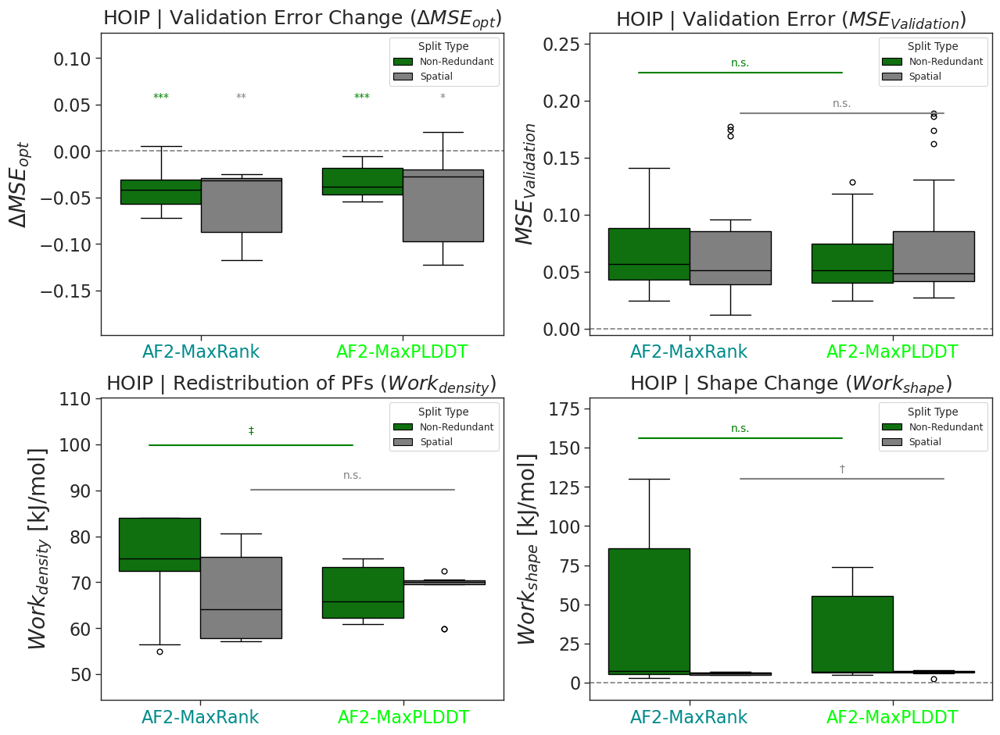

In [164]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")

def perform_ttest(data, ensemble1, ensemble2, split_type, y_metric):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) &
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) &
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

def perform_one_sample_ttest(data, ensemble, split, y_metric):
    """
    Perform one-sample t-test against 0 for a given ensemble and split.
    """
    group = data[(data['ensemble'] == ensemble) &
                 (data['split_name'] == split)][y_metric].dropna()
    
    if len(group) > 0:
        t_stat, p_val = stats.ttest_1samp(group, 0)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split} split for {ensemble}")
        print(f"Group size: {len(group)}")
        return float('nan'), float('nan')


# Create the main figure with 2x2 subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
# fig.suptitle("BPTI Analysis - Four Metrics Comparison", fontsize=16, y=0.98)

# Define metrics and data sources for each subplot
metrics_info = [
    {"metric": "mse", "data": "fit_val_df", "row": 0, "col": 1},
    {"metric": "dMSE", "data": "_dMSE_energy_df", "row": 0, "col": 0},
    {"metric": "delta_H_opt_kj", "data": "_dMSE_energy_df", "row": 1, "col": 1},
    {"metric": "-Tdelta_S_opt_kj", "data": "_dMSE_energy_df", "row": 1, "col": 0}
]

# Plot each metric
for ydx, info in enumerate(metrics_info):
    y_metric = info["metric"]
    ax = axes[info["row"], info["col"]]
    
    # Select appropriate data source
    if info["data"] == "fit_val_df":
        data = fit_val_df
        # Filter data for first plot
        data = data[data["split_type"].isin(["R3", "Sp"])]
        data = data[data["ensemble"].isin(full_dataset_order)]
    else:
        data = _dMSE_energy_df
    
    # Create box plot
    sns.boxplot(data=data,
                x='ensemble',
                y=y_metric,
                hue='split_name',
                order=ensemble_order,
                hue_order=split_name_dataset_order,
                ax=ax,
                palette=split_name_dataset_colours)
    
    # Get plot limits
    y_max = data[y_metric].max()
    y_min = data[y_metric].min()
    y_range = y_max - y_min
    
    # Add title using metric_name_mapping
    metric_title = metric_name_mapping.get(y_metric, y_metric)
    ax.set_title(f"HOIP | {metric_title}")
    
    # Handle different annotation styles based on metric
    if y_metric == "dMSE":
        # One-sample t-tests for dMSE
        n_ensembles = len(ensemble_order)
        hue_offset = 0.2
        
        for ensemble in ensemble_order:
            for split in split_name_dataset_order:
                ensemble_idx = ensemble_order.index(ensemble)
                split_idx = split_name_dataset_order.index(split)
                x_pos = ensemble_idx + (-hue_offset if split_idx == 0 else hue_offset)
                
                t_stat, p_val = perform_one_sample_ttest(data, ensemble, split, y_metric)
                stars = p_to_stars(p_val)
                y_pos = y_max + 0.05 * y_range
                print(f"Metric: {y_metric}, Ensemble: {ensemble}, Split: {split}, p-val: {p_val}")

                ax.text(x_pos, y_pos, stars,
                       ha='center', va='bottom', fontsize=10,
                       color=split_name_dataset_colours[split])
    else:
        # Two-sample t-tests for other metrics
        box_positions = {'Sp': 0.25, 'R3': -0.25}
        split_order = ["Sp", "R3"]
        spacing_factor = 0.2
        
        for idx, split in enumerate(split_order):
            if info["data"] == "fit_val_df":
                t_stat, p_val = perform_ttest(data, ensemble_order[0], ensemble_order[1], split, y_metric)
            else:
                # For dMSE_energy_df, need to map split names properly
                split_type_map = {'Sp': 'Sp', 'R3': 'R3'}  # Adjust as needed
                t_stat, p_val = perform_ttest(data, ensemble_order[0], ensemble_order[1], 
                                            split_type_map.get(split, split), y_metric)
            if ydx == 3:
                # For Tdelta_S_opt_kj, we need to adjust the base height calculation
                base_height = (y_max + (idx * 0.1) * y_range) - 60
            else:
                base_height = y_max + (idx * spacing_factor) * y_range
            
            # Add significance bar
            ax.plot([box_positions[split], 1 + box_positions[split]],
                   [base_height, base_height], '-',
                   color=split_type_dataset_colours[split], linewidth=1.5)
            
            stars = p_to_stars(p_val)
            print(f"Metric: {y_metric}, Split: {split}, p-val: {p_val}")
            ax.text(0.5 + box_positions[split], base_height + 0.02 * y_range, stars,
                   ha='center', va='bottom', fontsize=10,
                   color=split_type_dataset_colours[split])
            
    ax.legend(title='Split Type', loc='upper right',)
    
    # Customize each subplot
    ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
    ax.set_ylabel(metric_axis_mapping.get(y_metric, y_metric))
    ax.set_xlabel('')
    
    # Set x-tick labels with colors
    ax.set_xticks(range(len(ensemble_order)))
    labels = ax.set_xticklabels(ensemble_order)
    for idx, label in enumerate(labels):
        label.set_color(full_dataset_colours[ensemble_order[idx]])
    
    # Remove individual legends (we'll add a shared one)
    # if ax.get_legend():
    #     ax.get_legend().remove()
    
    # Adjust y-axis limits
    if y_metric == "dMSE":
        ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.2 * y_range)
    if ydx == 3:
        # For deltaS metrics, adjust limits to avoid overlap with significance bars
        ax.set_ylim(y_min - 0.1 * y_range, y_max-40)
    else:
        ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.4 * y_range)


# Create a shared legend
handles, labels = axes[0, 0].get_legend_handles_labels()
# fig.legend(handles, labels, title='Split Type', loc='center right', 
#            bbox_to_anchor=(0.55, 0.48), fontsize=10)

# Adjust layout
plt.tight_layout(rect=[0, 0, 0.92, 0.95])
plt.show()

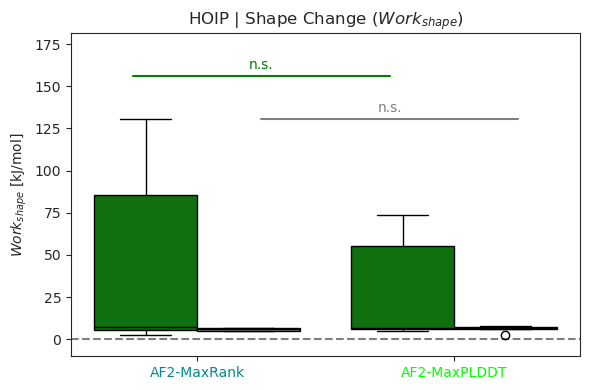

In [129]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")

y_metric = "delta_H_opt_kj"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6, 4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}")

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.2
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max + (idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    stars = p_to_stars(p_val)

    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height + 0.02 * y_range,
            stars,
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.4 * y_range)


plt.tight_layout()
plt.show()

/tmp/ipykernel_2064812/335753227.py:110: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()


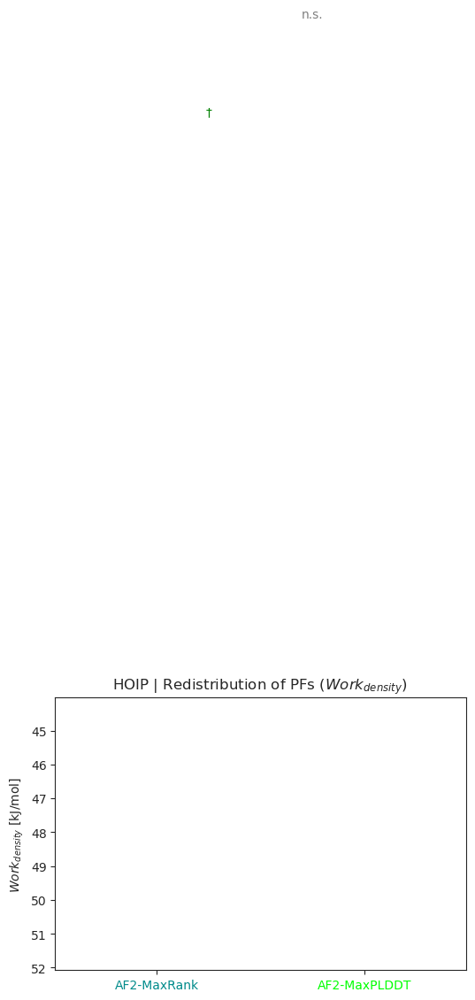

In [130]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")

y_metric = "-Tdelta_S_opt_kj"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6, 4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}")

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.1
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max + (idx * spacing_factor) * y_range -60
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    stars = p_to_stars(p_val)

    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height + 0.0 * y_range,
            stars,
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
# ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max - 40)


plt.tight_layout()
plt.show()

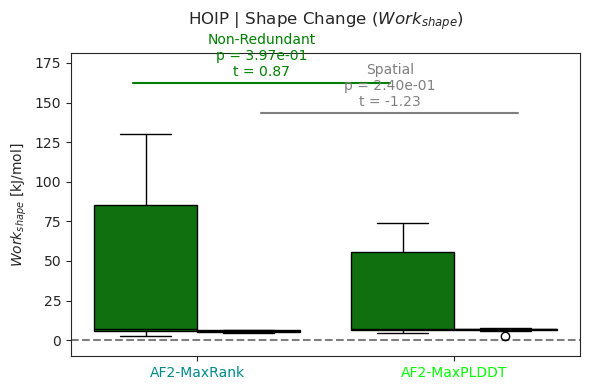

In [131]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")

y_metric = "delta_H_opt_kj"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6, 4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}", pad=20)

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.15
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max + (0.1 + idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height + 0.02 * y_range,
            f'{split_name_mapping[split]}\np = {p_val:.2e}\nt = {t_stat:.2f}',
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.4 * y_range)
# ax.set(yscale="log")
plt.tight_layout()
plt.show()


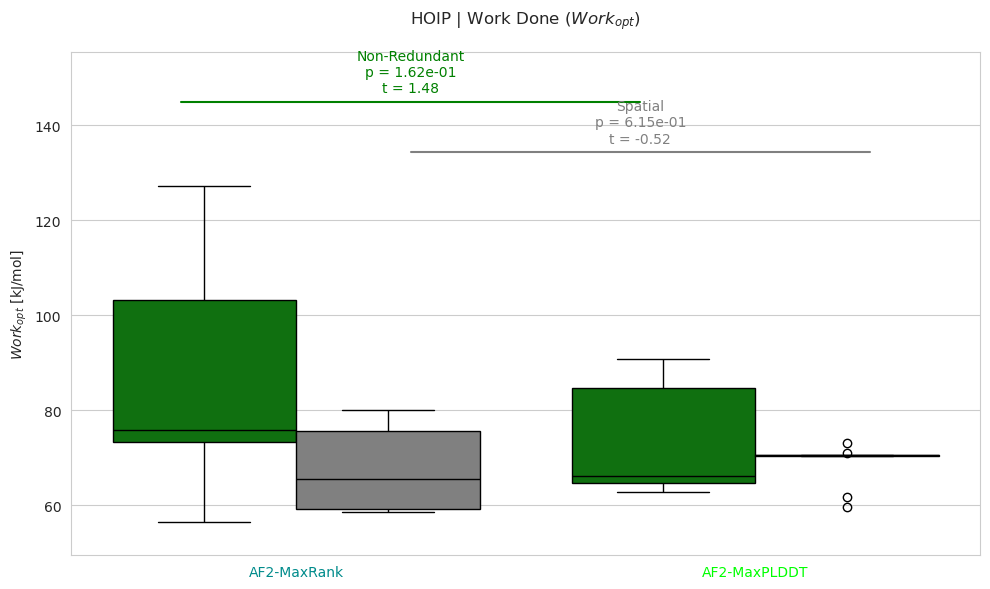

In [132]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("whitegrid")

y_metric = "delta_G_opt_kj"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(10, 6))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}", pad=20)

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.15
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max + (0.1 + idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height + 0.02 * y_range,
            f'{split_name_mapping[split]}\np = {p_val:.2e}\nt = {t_stat:.2f}',
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.4 * y_range)

plt.tight_layout()
plt.show()


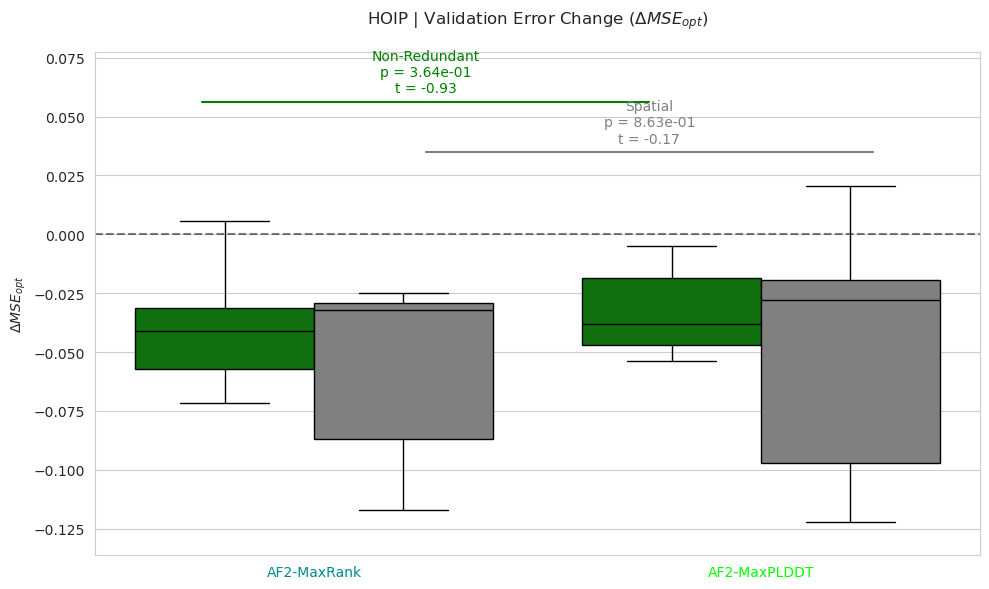

In [133]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("whitegrid")

y_metric = "dMSE"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(10, 6))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}", pad=20)

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.15
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max + (0.1 + idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height + 0.02 * y_range,
            f'{split_name_mapping[split]}\np = {p_val:.2e}\nt = {t_stat:.2f}',
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.4 * y_range)

plt.tight_layout()
plt.show()


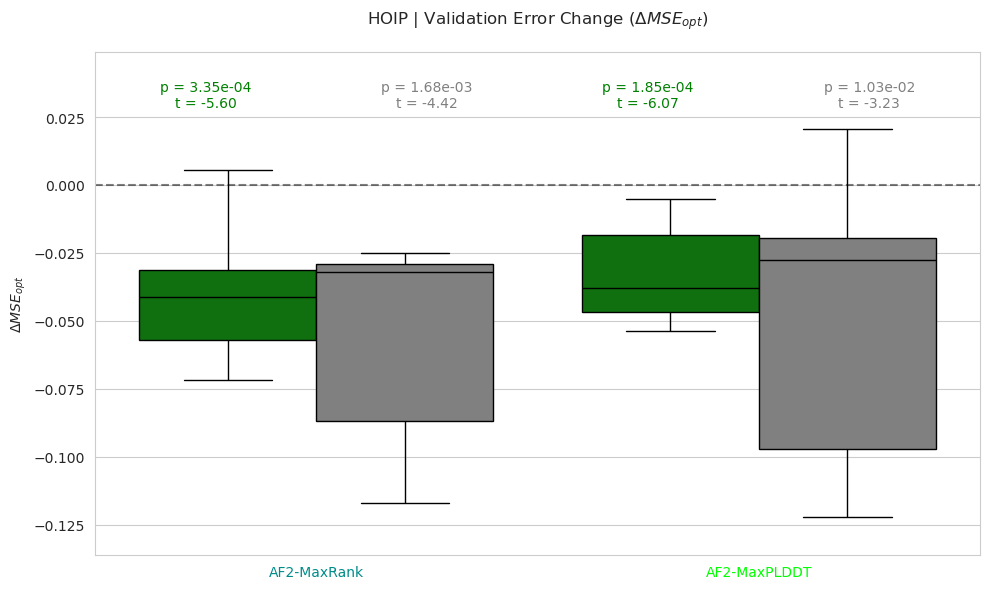

In [134]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("whitegrid")
y_metric = "dMSE"

def perform_one_sample_ttest(data, ensemble, split_type):
    """
    Perform one-sample t-test against 0 for a given ensemble and split type.
    """
    group = data[(data['ensemble'] == ensemble) & 
                 (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group) > 0:
        t_stat, p_val = stats.ttest_1samp(group, 0)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type for {ensemble}")
        print(f"Group size: {len(group)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(10, 6))

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df,
            x='ensemble',
            y=y_metric,
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax,
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}", pad=20)

# Calculate box positions for each ensemble and split type - corrected order
box_positions = {
    (ensemble_order[0], 'R3'): -0.25,  # First (leftmost) box
    (ensemble_order[0], 'Sp'): 0.25,   # Second box
    (ensemble_order[1], 'R3'): 0.75,   # Third box
    (ensemble_order[1], 'Sp'): 1.25    # Fourth (rightmost) box
}



# When adding annotations, maintain the same order:
for ensemble in ensemble_order:
    for split in ['R3', 'Sp']:  # Changed order to R3 first, then Sp
        t_stat, p_val = perform_one_sample_ttest(dMSE_energy_df, ensemble, split)
        
        # Calculate position for annotation
        x_pos = box_positions[(ensemble, split)]
        y_pos = y_max + 0.05 * y_range
        
        # Add text annotation
        ax.text(x_pos, y_pos,
                f'p = {p_val:.2e}\nt = {t_stat:.2f}',
                ha='center',
                va='bottom',
                fontsize=10,
                color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.2 * y_range)

plt.tight_layout()
plt.show()

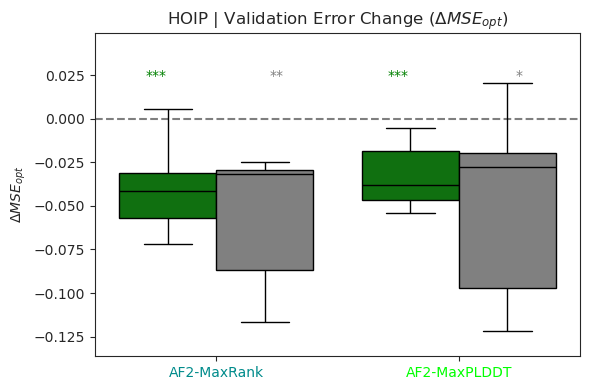

In [135]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")
y_metric = "dMSE"

def perform_one_sample_ttest(data, ensemble, split_type):
    """
    Perform one-sample t-test against 0 for a given ensemble and split type.
    """
    group = data[(data['ensemble'] == ensemble) & 
                 (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group) > 0:
        t_stat, p_val = stats.ttest_1samp(group, 0)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type for {ensemble}")
        print(f"Group size: {len(group)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6, 4))

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df,
            x='ensemble',
            y=y_metric,
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax,
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}")


# Calculate box positions for each ensemble and split type - corrected order
box_positions = {
    (ensemble_order[0], 'R3'): -0.25,  # First (leftmost) box
    (ensemble_order[0], 'Sp'): 0.25,   # Second box
    (ensemble_order[1], 'R3'): 0.75,   # Third box
    (ensemble_order[1], 'Sp'): 1.25    # Fourth (rightmost) box
}



# When adding annotations, maintain the same order:
for ensemble in ensemble_order:
    for split in ['R3', 'Sp']:  # Changed order to R3 first, then Sp
        t_stat, p_val = perform_one_sample_ttest(dMSE_energy_df, ensemble, split)
        
        # Calculate position for annotation
        x_pos = box_positions[(ensemble, split)]
        y_pos = y_max 
        stars = p_to_stars(p_val)

        # Add text annotation
        ax.text(x_pos, y_pos,
                stars,
                ha='center',
                va='bottom',
                fontsize=10,
                color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.2 * y_range)

plt.tight_layout()
plt.show()

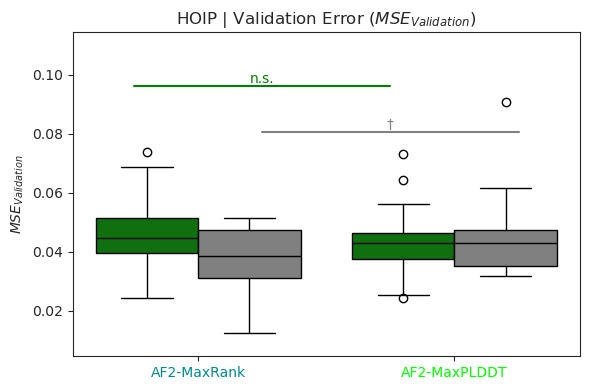

In [136]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")

y_metric = "mse"
_fit_val_df = fit_val_df[fit_val_df["split_type"].isin(["R3", "Sp"])]
_fit_val_df = _fit_val_df[_fit_val_df["ensemble"].isin(full_dataset_order)]
_fit_val_df = _fit_val_df[_fit_val_df["analysis"]=="BV"]

def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6,4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=_fit_val_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = _fit_val_df[y_metric].max()
y_min = _fit_val_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}")
# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.2
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(_fit_val_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max*0.8 + (0.1 + idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    stars = p_to_stars(p_val)
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height,
            stars,
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.3 * y_range)

plt.tight_layout()
plt.show()


ValueError: Could not interpret value `-Tdelta_S_opt_kj` for `y`. An entry with this name does not appear in `data`.

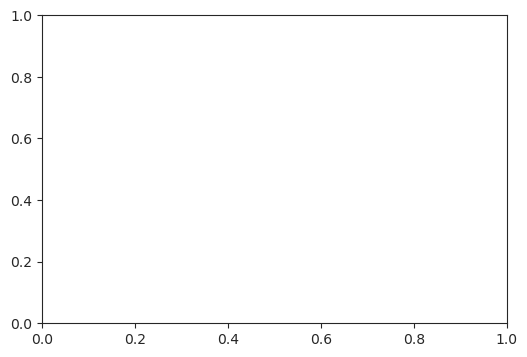

In [137]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")

y_metric = "-Tdelta_S_opt_kj"
_fit_val_df = fit_val_df[fit_val_df["split_type"].isin(["R3", "Sp"])]
_fit_val_df = _fit_val_df[_fit_val_df["ensemble"].isin(full_dataset_order)]
_fit_val_df = _fit_val_df[_fit_val_df["analysis"]=="BV"]

def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6,4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=_fit_val_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = _fit_val_df[y_metric].max()
y_min = _fit_val_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}")
# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.2
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(_fit_val_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max*0.8 + (0.1 + idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    stars = p_to_stars(p_val)
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height,
            stars,
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.3 * y_range)

plt.tight_layout()
plt.show()


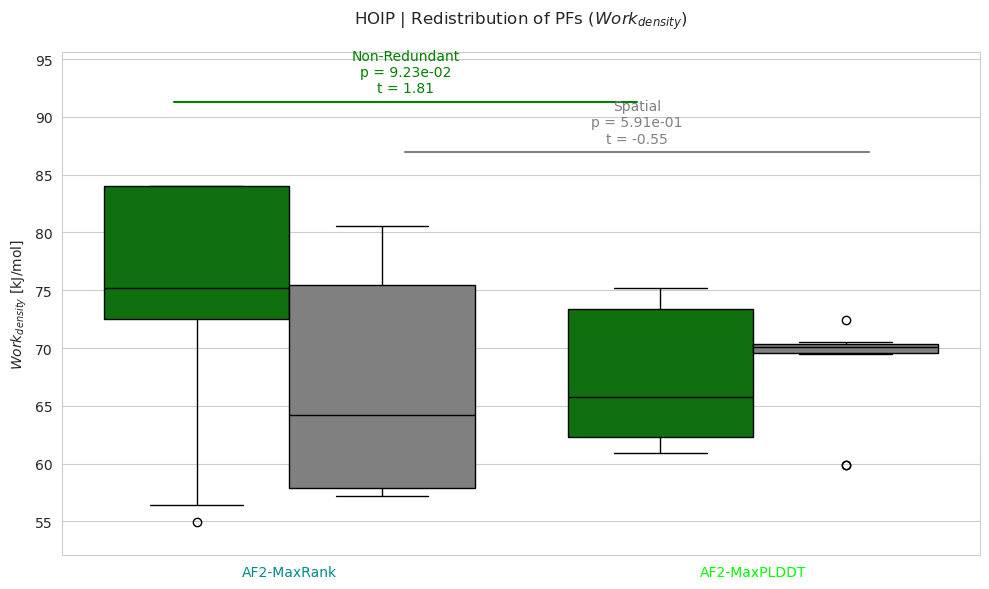

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("whitegrid")

y_metric = "-Tdelta_S_opt_kj"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(10, 6))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}", pad=20)

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.15
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max + (0.1 + idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height + 0.02 * y_range,
            f'{split_name_mapping[split]}\np = {p_val:.2e}\nt = {t_stat:.2f}',
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.4 * y_range)

plt.tight_layout()
plt.show()


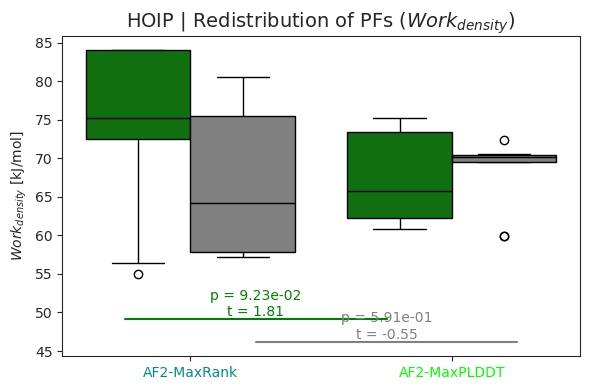

In [138]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")

y_metric = "-Tdelta_S_opt_kj"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6, 4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}", fontsize=14)

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.1
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max*0.55 + (idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height,
            f'p = {p_val:.2e}\nt = {t_stat:.2f}',
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
# ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
# ax.set_ylim(y_min - 0.1 * y_range, y_max*0.7 )


plt.tight_layout()
plt.show()

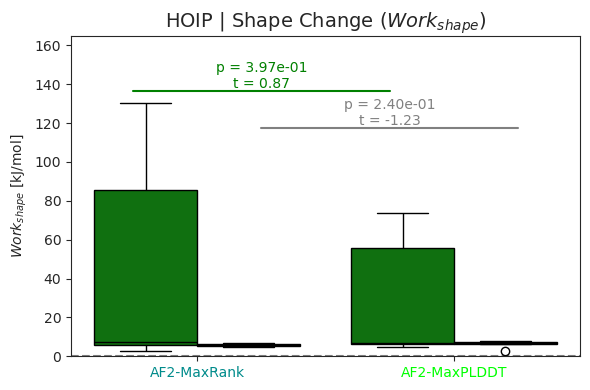

In [139]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

# Set style
sns.set_style("ticks")

y_metric = "delta_H_opt_kj"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6, 4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name}", fontsize=14)

# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.15
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max*0.9 + (idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height,
            f'p = {p_val:.2e}\nt = {t_stat:.2f}',
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(0 , 165)


plt.tight_layout()
plt.show()

In [140]:
dMSE_energy_df.columns

Index(['name', 'replicate', 'dMSE', 'dataset', 'system', 'system_name',
       'calc_name', 'avg_H_opt', 'avg_H_opt_kj', 'avg_S_opt', 'avg_S_opt_k',
       'avg_TdS_opt', 'avg_TdS_opt_kj', '-avg_TdS_opt_kj', 'avg_G_opt',
       'avg_G_opt_kj', 'avg_G_quasi', 'avg_G_quasi_kj', 'avg_H_conf',
       'avg_H_conf_kj', 'avg_S_conf', 'avg_S_conf_k', 'avg_TdS_conf',
       'avg_TdS_conf_kj', 'avg_G_conf', 'avg_G_conf_kj', 'avg_H_interaction',
       'avg_H_interaction_kj', 'avg_beta_star', 'avg_delta_avg_logPF',
       'delta_PFi', 'delta_H_abs', 'delta_H_abs_kj', 'delta_H_opt',
       'delta_H_opt_kj', 'delta_S_opt', 'delta_S_opt_kj', 'Tdelta_S_opt',
       'Tdelta_S_opt_kj', '-Tdelta_S_opt_kj', 'delta_G_opt', 'delta_G_opt_kj',
       'delta_G_conf', 'delta_G_conf_kj', 'delta_G_quasi', 'delta_G_quasi_kj',
       'K_abs', 'Q_abs', 'Z_opt', 'likelihood_opt', 'likelihood_conf',
       'quasi_likelihood', 'protein', 'method', 'fit', 'ensemble',
       'split_type', 'split_name', 'analysis'],
    

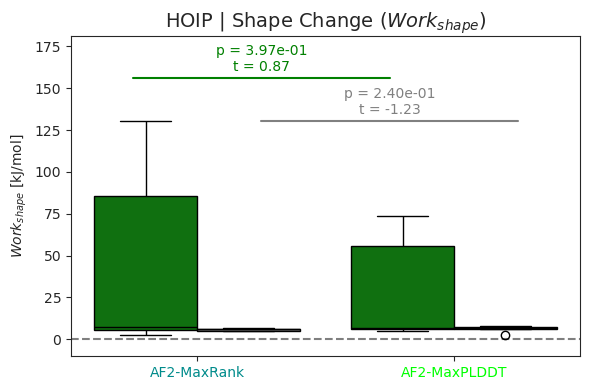

In [141]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd



y_metric = "delta_H_opt_kj"


def perform_ttest(data, ensemble1, ensemble2, split_type):
    """
    Perform t-test between two ensembles for a given split type, properly handling NaN values.
    """
    group1 = data[(data['ensemble'] == ensemble1) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    group2 = data[(data['ensemble'] == ensemble2) & 
                  (data['split_type'] == split_type)][y_metric].dropna()
    
    if len(group1) > 0 and len(group2) > 0:
        t_stat, p_val = stats.ttest_ind(group1, group2, equal_var=False)
        return t_stat, p_val
    else:
        print(f"Warning: Insufficient data for t-test in {split_type} split type")
        print(f"Group 1 size: {len(group1)}, Group 2 size: {len(group2)}")
        return float('nan'), float('nan')

# Create figure
fig, ax = plt.subplots(figsize=(6, 4))

# Ensure consistent ordering by setting order parameters
ensemble_order = full_dataset_order
split_order = ["Sp", "R3"]

# Create box plot with explicit ordering
sns.boxplot(data=dMSE_energy_df, 
            x='ensemble', 
            y=y_metric, 
            hue='split_name',
            order=ensemble_order,
            hue_order=split_name_dataset_order,
            ax=ax, 
            palette=split_name_dataset_colours)

# Get the plot limits for positioning annotations
y_max = dMSE_energy_df[y_metric].max()
y_min = dMSE_energy_df[y_metric].min()
y_range = y_max - y_min

# Calculate box positions
box_positions = {
    'Sp': 0.25,
    'R3': -0.25
}

# Add title
metric_name = metric_name_mapping.get(y_metric, 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
# plt.title(f"{protein_name} | {metric_name}", fontsize=20, pad=20)
plt.title(f"{protein_name} | {metric_name}", fontsize=14)
# Perform t-tests and add statistical annotations for each split type
spacing_factor = 0.2
for idx, split in enumerate(split_order):  # Use split_order to ensure consistent ordering
    t_stat, p_val = perform_ttest(dMSE_energy_df, ensemble_order[0], ensemble_order[1], split)
    
    # Calculate vertical positions for annotations
    base_height = y_max + ( idx * spacing_factor) * y_range
    
    # Add bar with adjusted horizontal position
    ax.plot([box_positions[split], 1 + box_positions[split]], 
            [base_height, base_height],
            '-',
            color=split_type_dataset_colours[split],
            linewidth=1.5)
    stars = p_to_stars(p_val)
    # Add text with adjusted horizontal position
    ax.text(0.5 + box_positions[split],
            base_height + 0.02 * y_range,
            f'p = {p_val:.2e}\nt = {t_stat:.2f}',
            ha='center',
            va='bottom',
            fontsize=10,
            color=split_type_dataset_colours[split])

# Customize plot
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
ax.set_ylabel(metric_axis_mapping.get(y_metric, 'Unknown Metric'))
ax.set_xlabel('')

# Set x-tick labels with colors using the specified order
ax.set_xticks(range(len(ensemble_order)))
labels = ax.set_xticklabels(ensemble_order)
for idx, label in enumerate(labels):
    label.set_color(full_dataset_colours[ensemble_order[idx]])

# Customize legend
legend = ax.get_legend()
legend.set_title('Split Type')
for text in legend.get_texts():
    text.set_color(split_name_dataset_colours[text.get_text()])
ax.get_legend().remove()

# Adjust y-axis limits to accommodate annotations
ax.set_ylim(y_min - 0.1 * y_range, y_max + 0.4 * y_range)

plt.tight_layout()
plt.show()


<Figure size 450x400 with 0 Axes>

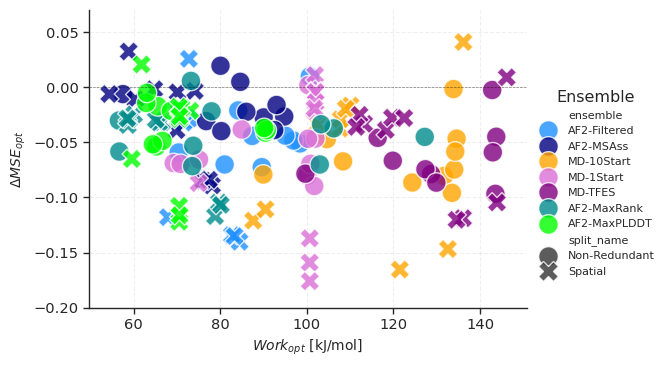

In [142]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set publication-ready style
plt.style.use('default')
sns.set_style("ticks")
sns.set_context("paper", font_scale=1.2)

# Filter the dataframe
dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["ensemble"].isin(full_dataset_colours)]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["analysis"]=="BV"]
# Create figure with specific size
fig = plt.figure(figsize=(4.5, 4))  # Standard single-column width

# Create the FacetGrid
g = sns.FacetGrid(
    dMSE_energy_df,
    row="protein",
    height=4,
    aspect=1.4,
    sharey=False,
    sharex=False,
    row_order=["HOIP"]
)

# Map the scatterplot with publication-ready formatting
g.map_dataframe(
    sns.scatterplot,
    x="delta_G_opt_kj",
    y="dMSE",
    hue="ensemble",
    style="split_name",
    palette=full_dataset_colours,
    alpha=0.8,
    s=200,  # Consistent marker size
    markers={"Non-Redundant": "o", "Spatial": "X"},  # Clear marker styles
    linewidth=1
)

# Customize the plot
g.set_titles("")  # Remove title as it's redundant for single panel
g.set_xlabels(metric_axis_mapping["delta_G_opt_kj"], fontsize=10)
g.set_ylabels(metric_axis_mapping["dMSE"], fontsize=10)

# Add horizontal line at y=0
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--', linewidth=0.5, alpha=0.5)
    ax.spines['top'].set_visible(False)  # Remove top border
    ax.spines['right'].set_visible(False)  # Remove right border
    ax.tick_params(direction='out', length=4, width=1)
    ax.grid(True, linestyle='--', alpha=0.3)

# # Set axis limits and ticks
g.set(ylim=(-0.2, 0.07))
# g.set(xlim=(-0.5, 5.5))

# Customize legend
g.add_legend(
    title="Ensemble",
    fontsize=8,
    title_fontsize=9,
    # bbox_to_anchor=(1.05, 1),
    # loc='lower left',
    frameon=False,
)

# Adjust layout
# plt.tight_layout()

# # Save the figure
# plt.savefig('BPTI_optimization.pdf', dpi=300, bbox_inches='tight')
# plt.savefig('BPTI_optimization.png', dpi=300, bbox_inches='tight')

plt.show()

In [143]:
break

SyntaxError: 'break' outside loop (668683560.py, line 1)

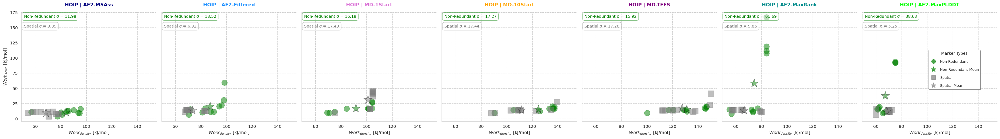

In [144]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Set up the data
# Filter data for specific split types
_ensemble_pmf_df = ensemble_pmf_df[ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]

# Filter for dataset order and use the new naming system
_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["ensemble"].isin(full_dataset_colours)]

# Force the order of the datasets using new naming
_ensemble_pmf_df["ensemble"] = pd.Categorical(_ensemble_pmf_df["ensemble"], 
                                            categories=full_dataset_colours, 
                                            ordered=True)

_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["analysis"]=="BV"]

# Define consistent styles for split types using new color scheme
split_styles = {
    'R3': {'marker': 'o', 'color': split_type_dataset_colours['R3']},
    'Sp': {'marker': 's', 'color': split_type_dataset_colours['Sp']}
}

# Set figure style
# plt.style.use('white')
sns.set_style("whitegrid", {'grid.linestyle': '--'})

# Create the FacetGrid
g = sns.FacetGrid(_ensemble_pmf_df, 
                  row="protein", 
                  col="ensemble", 
                  height=5, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-Tdelta_S_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  s=200,
                  label=split_name_mapping[split_type],
                  alpha=0.5)

# Function to calculate and annotate mean, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            mean_x = subset["-Tdelta_S_opt_kj"].mean()
            mean_y = subset["delta_H_abs_kj"].mean()
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-Tdelta_S_opt_kj"], subset["delta_H_abs_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot mean with darker version of split type color
            ax.scatter(mean_x, mean_y, 
                      marker='*', 
                      s=500,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Mean',
                      alpha=0.5,
                      zorder=5)
            
            # Add std dev annotation with refined styling
            ax.annotate(f'{split_name_mapping[split_type]} σ = {mult_std:.2f}',
                       xy=(0.02, 0.95 - (0.09 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=10,
                       color=style['color'],
                       bbox=dict(facecolor='white',
                                edgecolor=style['color'],
                                alpha=0.5,
                                boxstyle='round,pad=0.5'))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Custom function to set colored titles with refined styling
def set_colored_titles(figure):
    for ax in figure.axes:
        title = ax.get_title()
        if title:
            parts = title.split(" | ")
            if len(parts) == 2:
                protein, ensemble = parts
                new_title = f"{protein} | "
                ax.set_title(new_title + ensemble, 
                           color=full_dataset_colours[ensemble],
                           pad=15,
                           fontsize=12,
                           fontweight='bold')

# Set and style titles
g.set_titles(row_template="{row_name}", col_template="{col_name}")
set_colored_titles(g.fig)

# Add styled axis labels
g.set_axis_labels(metric_axis_mapping["-Tdelta_S_opt_kj"], 
                 metric_axis_mapping["delta_H_abs_kj"],
                 fontsize=11)

# Create refined legend elements
handles = []
labels = []

for split_type, style in split_styles.items():
    # Data points with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.7,
                            label=split_name_mapping[split_type]))
    # Mean markers with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            linestyle='None',
                            markersize=14,
                            alpha=0.7,
                            label=f'{split_name_mapping[split_type]} Mean'))
    labels.extend([split_name_mapping[split_type], 
                  f'{split_name_mapping[split_type]} Mean'])

# Add refined legend
g.fig.legend(handles, labels, 
            loc='center right',
            bbox_to_anchor=(0.98, 0.5),
            title="Marker Types",
            title_fontsize=10,
            fontsize=9,
            frameon=True,
            edgecolor='gray',
            fancybox=True,
            shadow=True,
            # borderpad=1,
            labelspacing=1.2)

# Final layout adjustments
plt.tight_layout()
# g.fig.subplots_adjust(right=0.85)  # Make room for legend

plt.show()

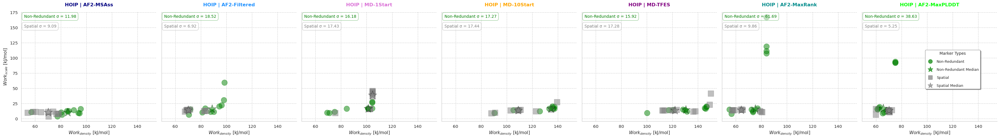

In [145]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Set up the data
# Filter data for specific split types
_ensemble_pmf_df = ensemble_pmf_df[ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]

# Filter for dataset order and use the new naming system
_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["ensemble"].isin(full_dataset_colours)]

# Force the order of the datasets using new naming
_ensemble_pmf_df["ensemble"] = pd.Categorical(_ensemble_pmf_df["ensemble"], 
                                            categories=full_dataset_colours, 
                                            ordered=True)

_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["analysis"]=="BV"]

# Define consistent styles for split types using new color scheme
split_styles = {
    'R3': {'marker': 'o', 'color': split_type_dataset_colours['R3']},
    'Sp': {'marker': 's', 'color': split_type_dataset_colours['Sp']}
}

# Set figure style
# plt.style.use('white')
sns.set_style("whitegrid", {'grid.linestyle': '--'})

# Create the FacetGrid
g = sns.FacetGrid(_ensemble_pmf_df, 
                  row="protein", 
                  col="ensemble", 
                  height=5, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-Tdelta_S_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  s=200,
                  label=split_name_mapping[split_type],
                  alpha=0.5)
# Function to calculate and annotate median, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            median_x = subset["-Tdelta_S_opt_kj"].median()
            median_y = subset["delta_H_abs_kj"].median()
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-Tdelta_S_opt_kj"], subset["delta_H_abs_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot median with darker version of split type color
            ax.scatter(median_x, median_y, 
                      marker='*', 
                      s=500,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Median',
                      alpha=0.5,
                      zorder=5)
            
            # Add std dev annotation with refined styling
            ax.annotate(f'{split_name_mapping[split_type]} σ = {mult_std:.2f}',
                       xy=(0.02, 0.95 - (0.09 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=10,
                       color=style['color'],
                       bbox=dict(facecolor='white',
                                edgecolor=style['color'],
                                alpha=0.5,
                                boxstyle='round,pad=0.5'))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Custom function to set colored titles with refined styling
def set_colored_titles(figure):
    for ax in figure.axes:
        title = ax.get_title()
        if title:
            parts = title.split(" | ")
            if len(parts) == 2:
                protein, ensemble = parts
                new_title = f"{protein} | "
                ax.set_title(new_title + ensemble, 
                           color=full_dataset_colours[ensemble],
                           pad=15,
                           fontsize=12,
                           fontweight='bold')

# Set and style titles
g.set_titles(row_template="{row_name}", col_template="{col_name}")
set_colored_titles(g.fig)

# Add styled axis labels
g.set_axis_labels(metric_axis_mapping["-Tdelta_S_opt_kj"], 
                 metric_axis_mapping["delta_H_abs_kj"],
                 fontsize=11)

# Create refined legend elements
handles = []
labels = []

for split_type, style in split_styles.items():
    # Data points with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.7,
                            label=split_name_mapping[split_type]))
    # Median markers with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            linestyle='None',
                            markersize=14,
                            alpha=0.7,
                            label=f'{split_name_mapping[split_type]} Median'))
    labels.extend([split_name_mapping[split_type], 
                  f'{split_name_mapping[split_type]} Median'])
# Add refined legend
g.fig.legend(handles, labels, 
            loc='center right',
            bbox_to_anchor=(0.98, 0.5),
            title="Marker Types",
            title_fontsize=10,
            fontsize=9,
            frameon=True,
            edgecolor='gray',
            fancybox=True,
            shadow=True,
            # borderpad=1,
            labelspacing=1.2)

# Final layout adjustments
plt.tight_layout()
# g.fig.subplots_adjust(right=0.85)  # Make room for legend

plt.show()

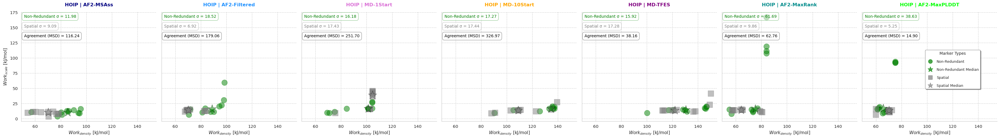

In [146]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Set up the data
# Filter data for specific split types
_ensemble_pmf_df = ensemble_pmf_df[ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]

# Filter for dataset order and use the new naming system
_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["ensemble"].isin(full_dataset_colours)]

# Force the order of the datasets using new naming
_ensemble_pmf_df["ensemble"] = pd.Categorical(_ensemble_pmf_df["ensemble"], 
                                            categories=full_dataset_colours, 
                                            ordered=True)

_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["analysis"]=="BV"]

# Define consistent styles for split types using new color scheme
split_styles = {
    'R3': {'marker': 'o', 'color': split_type_dataset_colours['R3']},
    'Sp': {'marker': 's', 'color': split_type_dataset_colours['Sp']}
}

# Set figure style
# plt.style.use('white')
sns.set_style("whitegrid", {'grid.linestyle': '--'})

# Create the FacetGrid
g = sns.FacetGrid(_ensemble_pmf_df, 
                  row="protein", 
                  col="ensemble", 
                  height=5, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-Tdelta_S_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  s=200,
                  label=split_name_mapping[split_type],
                  alpha=0.5)
# Function to calculate and annotate median, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    medians = {}  # Store medians for MSD calculation
    
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            median_x = subset["-Tdelta_S_opt_kj"].median()
            median_y = subset["delta_H_abs_kj"].median()
            medians[split_type] = np.array([median_x, median_y])
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-Tdelta_S_opt_kj"], subset["delta_H_abs_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot median with darker version of split type color
            ax.scatter(median_x, median_y, 
                      marker='*', 
                      s=500,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Median',
                      alpha=0.5,
                      zorder=5)
            
            # Add std dev annotation with refined styling
            ax.annotate(f'{split_name_mapping[split_type]} σ = {mult_std:.2f}',
                       xy=(0.02, 0.95 - (0.09 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=10,
                       color=style['color'],
                       bbox=dict(facecolor='white',
                                edgecolor=style['color'],
                                alpha=0.5,
                                boxstyle='round,pad=0.5'))
    
    # Calculate and annotate MSD between medians if we have both split types
    if len(medians) == 2:
        msd = np.mean((medians['R3'] - medians['Sp'])**2)
        ax.annotate(f'Agreement (MSD) = {msd:.2f}',
                   xy=(0.02, 0.77),  # Position below the other annotations
                   xycoords='axes fraction',
                   fontsize=10,
                   color='black',
                   bbox=dict(facecolor='white',
                            edgecolor='black',
                            alpha=0.5,
                            boxstyle='round,pad=0.5'))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Custom function to set colored titles with refined styling
def set_colored_titles(figure):
    for ax in figure.axes:
        title = ax.get_title()
        if title:
            parts = title.split(" | ")
            if len(parts) == 2:
                protein, ensemble = parts
                new_title = f"{protein} | "
                ax.set_title(new_title + ensemble, 
                           color=full_dataset_colours[ensemble],
                           pad=15,
                           fontsize=12,
                           fontweight='bold')

# Set and style titles
g.set_titles(row_template="{row_name}", col_template="{col_name}")
set_colored_titles(g.fig)

# Add styled axis labels
g.set_axis_labels(metric_axis_mapping["-Tdelta_S_opt_kj"], 
                 metric_axis_mapping["delta_H_abs_kj"],
                 fontsize=11)

# Create refined legend elements
handles = []
labels = []

for split_type, style in split_styles.items():
    # Data points with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.7,
                            label=split_name_mapping[split_type]))
    # Median markers with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            linestyle='None',
                            markersize=14,
                            alpha=0.7,
                            label=f'{split_name_mapping[split_type]} Median'))
    labels.extend([split_name_mapping[split_type], 
                  f'{split_name_mapping[split_type]} Median'])
# Add refined legend
g.fig.legend(handles, labels, 
            loc='center right',
            bbox_to_anchor=(0.98, 0.5),
            title="Marker Types",
            title_fontsize=10,
            fontsize=9,
            frameon=True,
            edgecolor='gray',
            fancybox=True,
            shadow=True,
            # borderpad=1,
            labelspacing=1.2)

# Final layout adjustments
plt.tight_layout()
# g.fig.subplots_adjust(right=0.85)  # Make room for legend

plt.show()

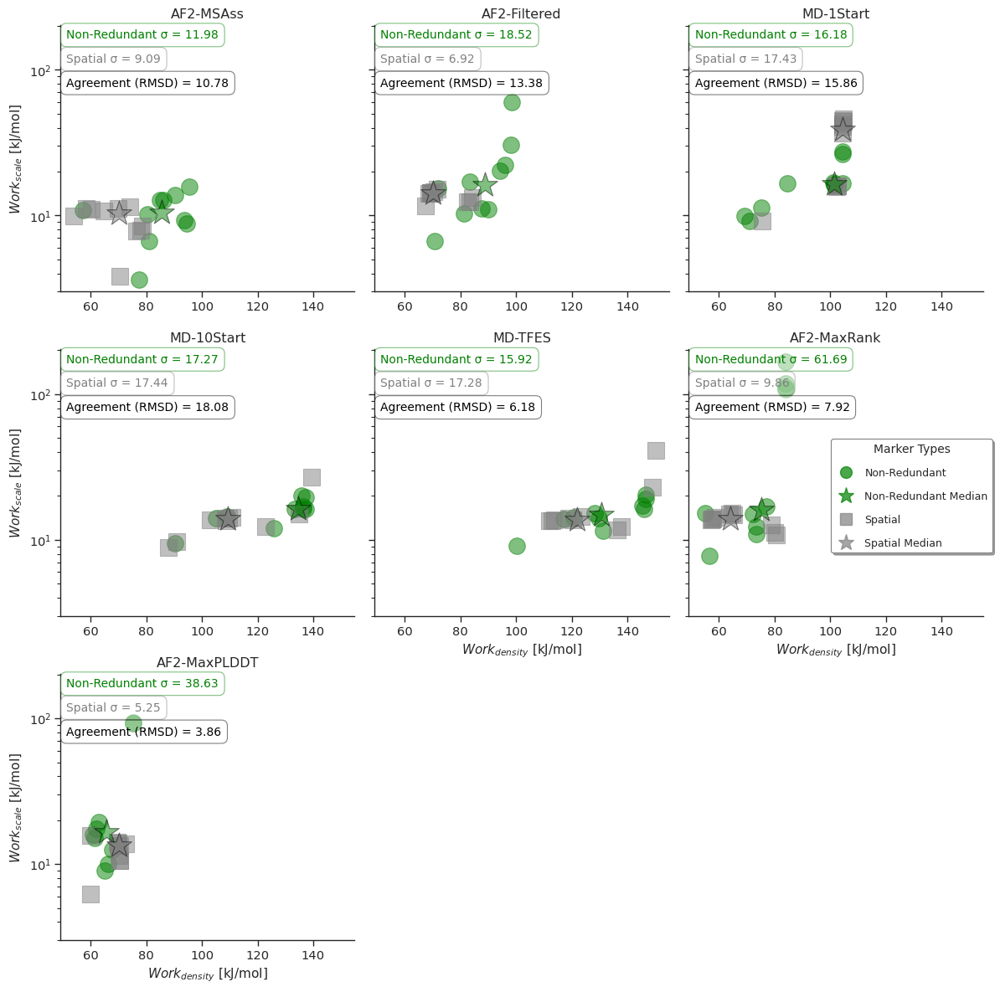

In [147]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Set up the data
# Filter data for specific split types
_ensemble_pmf_df = ensemble_pmf_df[ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]

# Filter for dataset order and use the new naming system
_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["ensemble"].isin(full_dataset_colours)]

# Force the order of the datasets using new naming
_ensemble_pmf_df["ensemble"] = pd.Categorical(_ensemble_pmf_df["ensemble"], 
                                            categories=full_dataset_colours, 
                                            ordered=True)

_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["analysis"]=="BV"]

# Define consistent styles for split types using new color scheme
split_styles = {
    'R3': {'marker': 'o', 'color': split_type_dataset_colours['R3']},
    'Sp': {'marker': 's', 'color': split_type_dataset_colours['Sp']}
}

# Set figure style
# plt.style.use('white')
sns.set_style("ticks")
# Create the FacetGrid
g = sns.FacetGrid(_ensemble_pmf_df, 
                #   row="protein", 
                    col="ensemble",
                    col_wrap=3,
                  height=4, 
                  aspect=1, 
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-Tdelta_S_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  s=200,
                  label=split_name_mapping[split_type],
                  alpha=0.5)
# Function to calculate and annotate median, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    medians = {}  # Store medians for MSD calculation
    
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            median_x = subset["-Tdelta_S_opt_kj"].median()
            median_y = subset["delta_H_abs_kj"].median()
            medians[split_type] = np.array([median_x, median_y])
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-Tdelta_S_opt_kj"], subset["delta_H_abs_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot median with darker version of split type color
            ax.scatter(median_x, median_y, 
                      marker='*', 
                      s=500,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Median',
                      alpha=0.5,
                      zorder=5)
            
            # Add std dev annotation with refined styling
            ax.annotate(f'{split_name_mapping[split_type]} σ = {mult_std:.2f}',
                       xy=(0.02, 0.95 - (0.09 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=10,
                       color=style['color'],
                       bbox=dict(facecolor='white',
                                edgecolor=style['color'],
                                alpha=0.5,
                                boxstyle='round,pad=0.5'))
    
    # Calculate and annotate MSD between medians if we have both split types
    if len(medians) == 2:
        msd = np.mean((medians['R3'] - medians['Sp'])**2)**0.5
        ax.annotate(f'Agreement (RMSD) = {msd:.2f}',
                   xy=(0.02, 0.77),  # Position below the other annotations
                   xycoords='axes fraction',
                   fontsize=10,
                   color='black',
                   bbox=dict(facecolor='white',
                            edgecolor='black',
                            alpha=0.5,
                            boxstyle='round,pad=0.5'))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Custom function to set colored titles with refined styling
def set_colored_titles(figure):
    for ax in figure.axes:
        title = ax.get_title()
        if title:
            parts = title.split(" | ")
            if len(parts) == 2:
                protein, ensemble = parts
                new_title = f"{protein} | "
                ax.set_title(new_title + ensemble, 
                           color=full_dataset_colours[ensemble],
                           pad=15,
                           fontsize=14,
                           fontweight='bold')

# Set and style titles
g.set_titles(row_template="{row_name}", col_template="{col_name}")
set_colored_titles(g.fig)

# Add styled axis labels
g.set_axis_labels(metric_axis_mapping["-Tdelta_S_opt_kj"], 
                 metric_axis_mapping["delta_H_abs_kj"],
                 fontsize=11)

# Create refined legend elements
handles = []
labels = []

for split_type, style in split_styles.items():
    # Data points with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.7,
                            label=split_name_mapping[split_type]))
    # Median markers with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            linestyle='None',
                            markersize=14,
                            alpha=0.7,
                            label=f'{split_name_mapping[split_type]} Median'))
    labels.extend([split_name_mapping[split_type], 
                  f'{split_name_mapping[split_type]} Median'])
# Add refined legend
g.fig.legend(handles, labels, 
            loc='center right',
            bbox_to_anchor=(1, 0.5),
            title="Marker Types",
            title_fontsize=10,
            fontsize=9,
            frameon=True,
            edgecolor='gray',
            fancybox=True,
            shadow=True,
            # borderpad=1,
            labelspacing=1.2)

# Final layout adjustments
plt.tight_layout()
# g.fig.subplots_adjust(right=0.85)  # Make room for legend
g.set(yscale="log")

plt.show()

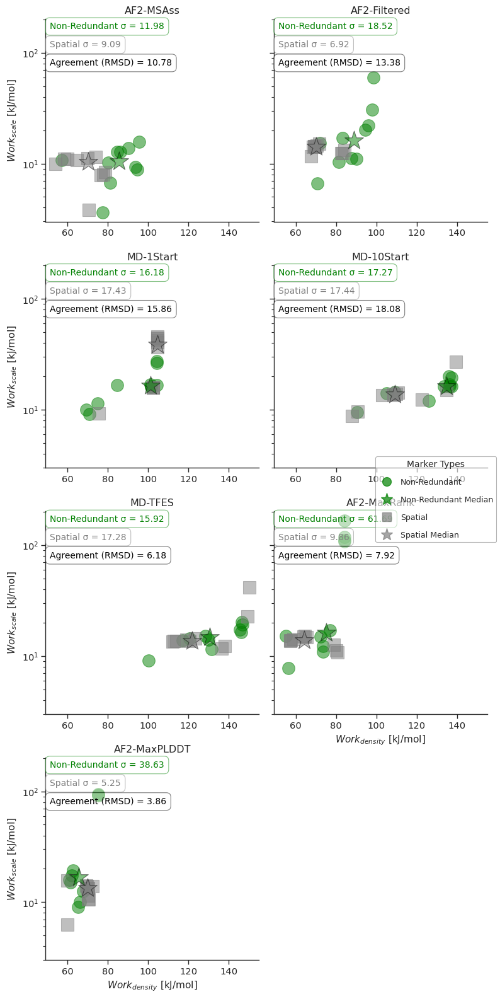

In [148]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Set up the data
# Filter data for specific split types
_ensemble_pmf_df = ensemble_pmf_df[ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]

# Filter for dataset order and use the new naming system
_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["ensemble"].isin(full_dataset_colours)]

# Force the order of the datasets using new naming
_ensemble_pmf_df["ensemble"] = pd.Categorical(_ensemble_pmf_df["ensemble"], 
                                            categories=full_dataset_colours, 
                                            ordered=True)

_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["analysis"]=="BV"]

# Define consistent styles for split types using new color scheme
split_styles = {
    'R3': {'marker': 'o', 'color': split_type_dataset_colours['R3']},
    'Sp': {'marker': 's', 'color': split_type_dataset_colours['Sp']}
}

# Set figure style
# plt.style.use('white')
sns.set_style("ticks")
# Create the FacetGrid
g = sns.FacetGrid(_ensemble_pmf_df, 
                #   row="protein", 
                  col="ensemble", 
                  height=4, 
                  aspect=1, 
                  col_wrap=2,
                  sharey='row', 
                  sharex='row')

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-Tdelta_S_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  s=200,
                  label=split_name_mapping[split_type],
                  alpha=0.5)
# Function to calculate and annotate median, median, and std dev with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    medians = {}  # Store medians for MSD calculation
    
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            median_x = subset["-Tdelta_S_opt_kj"].median()
            median_y = subset["delta_H_abs_kj"].median()
            medians[split_type] = np.array([median_x, median_y])
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-Tdelta_S_opt_kj"], subset["delta_H_abs_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot median with darker version of split type color
            ax.scatter(median_x, median_y, 
                      marker='*', 
                      s=500,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Median',
                      alpha=0.5,
                      zorder=5)
            
            # Add std dev annotation with refined styling
            ax.annotate(f'{split_name_mapping[split_type]} σ = {mult_std:.2f}',
                       xy=(0.02, 0.95 - (0.09 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=10,
                       color=style['color'],
                       bbox=dict(facecolor='white',
                                edgecolor=style['color'],
                                alpha=0.5,
                                boxstyle='round,pad=0.5'))
    
    # Calculate and annotate MSD between medians if we have both split types
    if len(medians) == 2:
        msd = np.mean((medians['R3'] - medians['Sp'])**2)**0.5
        ax.annotate(f'Agreement (RMSD) = {msd:.2f}',
                   xy=(0.02, 0.77),  # Position below the other annotations
                   xycoords='axes fraction',
                   fontsize=10,
                   color='black',
                   bbox=dict(facecolor='white',
                            edgecolor='black',
                            alpha=0.5,
                            boxstyle='round,pad=0.5'))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Custom function to set colored titles with refined styling
def set_colored_titles(figure):
    for ax in figure.axes:
        title = ax.get_title()
        if title:
            parts = title.split(" | ")
            if len(parts) == 2:
                protein, ensemble = parts
                new_title = f"{protein} | "
                ax.set_title(new_title + ensemble, 
                           color=full_dataset_colours[ensemble],
                           pad=15,
                           fontsize=14,
                           fontweight='bold')

# Set and style titles
g.set_titles(row_template="{row_name}", col_template="{col_name}")
set_colored_titles(g.fig)

# Add styled axis labels
g.set_axis_labels(metric_axis_mapping["-Tdelta_S_opt_kj"], 
                 metric_axis_mapping["delta_H_abs_kj"],
                 fontsize=11)

# Create refined legend elements
handles = []
labels = []

for split_type, style in split_styles.items():
    # Data points with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.7,
                            label=split_name_mapping[split_type]))
    # Median markers with refined styling
    handles.append(plt.Line2D([0], [0], 
                            marker='*',
                            color=style['color'],
                            linestyle='None',
                            markersize=14,
                            alpha=0.7,
                            label=f'{split_name_mapping[split_type]} Median'))
    labels.extend([split_name_mapping[split_type], 
                  f'{split_name_mapping[split_type]} Median'])
# Add refined legend
g.fig.legend(handles, labels, 
            loc='center right',
            # bbox_to_anchor=(1, 0.5),
            title="Marker Types",
            title_fontsize=10,
            fontsize=9,
            frameon=True,
            edgecolor='gray',
            fancybox=True,
            # shadow=True,
            framealpha=0.6,
            # borderpad=1,
            labelspacing=1.2)

# Final layout adjustments
plt.tight_layout()
# g.fig.subplots_adjust(right=0.85)  # Make room for legend
g.set(yscale="log")

plt.show()

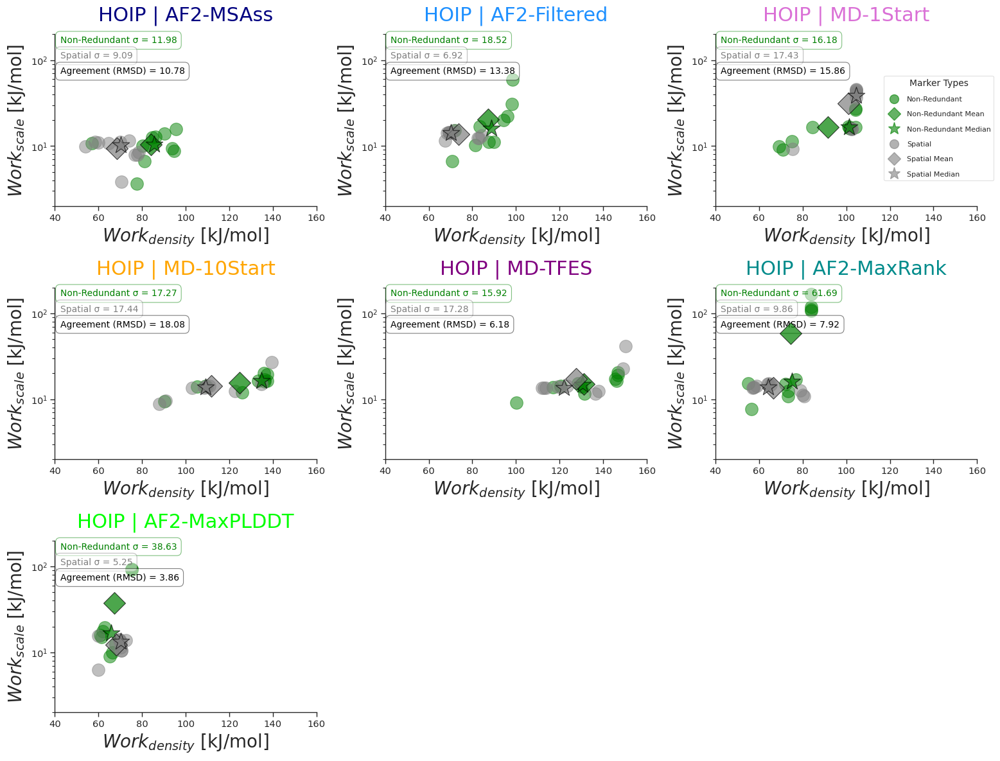

In [149]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Set up the data
# Filter data for specific split types
_ensemble_pmf_df = ensemble_pmf_df[ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]

# Filter for dataset order and use the new naming system
_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["ensemble"].isin(full_dataset_colours)]

# Force the order of the datasets using new naming
_ensemble_pmf_df["ensemble"] = pd.Categorical(_ensemble_pmf_df["ensemble"], 
                                            categories=full_dataset_colours, 
                                            ordered=True)

_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["analysis"]=="BV"]
# Define consistent styles for split types using new color scheme
split_styles = {
    'R3': {'marker': 'o', 'color': split_type_dataset_colours['R3']},
    'Sp': {'marker': 'o', 'color': split_type_dataset_colours['Sp']}
}

# Set figure style
sns.set_style("ticks")

# Create the FacetGrid
g = sns.FacetGrid(_ensemble_pmf_df, 
                #   row="protein",
                 col_wrap=3, 
                  col="ensemble", 
                  height=4, 
                  aspect=1.3, 
                  sharey=False, 
                  sharex=False)

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-Tdelta_S_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  s=200,
                  label=split_name_mapping[split_type],
                  alpha=0.5)

# Function to calculate and annotate means, medians, and stats with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    means = {}  # Store means for RMSD calculation
    medians = {}  # Store medians for RMSD calculation
    
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            mean_x = subset["-Tdelta_S_opt_kj"].mean()
            mean_y = subset["delta_H_abs_kj"].mean()
            median_x = subset["-Tdelta_S_opt_kj"].median()
            median_y = subset["delta_H_abs_kj"].median()
            
            means[split_type] = np.array([mean_x, mean_y])
            medians[split_type] = np.array([median_x, median_y])
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-Tdelta_S_opt_kj"], subset["delta_H_abs_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot mean with diamond marker
            ax.scatter(mean_x, mean_y, 
                      marker='D',  # Diamond for mean
                      s=300,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Mean',
                      alpha=0.7,
                      zorder=5)
            
            # Plot median with star marker
            ax.scatter(median_x, median_y, 
                      marker='*',  # Star for median
                      s=400,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Median',
                      alpha=0.7,
                      zorder=5)
            
            # Add std dev annotation with refined styling
            ax.annotate(f'{split_name_mapping[split_type]} σ = {mult_std:.2f}',
                       xy=(0.02, 0.95 - (0.09 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=10,
                       color=style['color'],
                       bbox=dict(facecolor='white',
                                edgecolor=style['color'],
                                alpha=0.5,
                                boxstyle='round,pad=0.5'))
    
    # Calculate and annotate RMSD between medians if we have both split types
    if len(medians) == 2:
        msd = np.mean((medians['R3'] - medians['Sp'])**2)**0.5
        ax.annotate(f'Agreement (RMSD) = {msd:.2f}',
                   xy=(0.02, 0.77),  # Position below the other annotations
                   xycoords='axes fraction',
                   fontsize=10,
                   color='black',
                   bbox=dict(facecolor='white',
                            edgecolor='black',
                            alpha=0.5,
                            boxstyle='round,pad=0.5'))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Custom function to set colored titles with refined styling
def set_colored_titles(figure):
    for ax in figure.axes:
        title = ax.get_title()
        if title:
            # The title should just be the ensemble name
            ensemble = title.strip()
            if ensemble in full_dataset_colours:
                ax.set_title(f"{protein} | {ensemble}", 
                           color=full_dataset_colours[ensemble],
                           pad=15,
                           fontsize=22,)
                        #    fontweight='bold')

# Set and style titles
g.set_titles(col_template="{col_name}")  # Use only the column name
set_colored_titles(g.fig)

# Add styled axis labels - ensure all subplots have labels
for ax in g.axes.flat:
    ax.set_xlabel(metric_axis_mapping["-Tdelta_S_opt_kj"], fontsize=20)
    ax.set_ylabel(metric_axis_mapping["delta_H_abs_kj"], fontsize=20)

# Create refined legend elements
handles = []
labels = []

for split_type, style in split_styles.items():
    # Data points
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.6,
                            label=split_name_mapping[split_type]))
    # Mean markers
    handles.append(plt.Line2D([0], [0], 
                            marker='D',  # Diamond for mean
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.6,
                            label=f'{split_name_mapping[split_type]} Mean'))
    # Median markers
    handles.append(plt.Line2D([0], [0], 
                            marker='*',  # Star for median
                            color=style['color'],
                            linestyle='None',
                            markersize=14,
                            alpha=0.6,
                            label=f'{split_name_mapping[split_type]} Median'))
    labels.extend([
        split_name_mapping[split_type],
        f'{split_name_mapping[split_type]} Mean',
        f'{split_name_mapping[split_type]} Median'
    ])

# Add refined legend
g.fig.legend(handles, labels, 
            loc='upper right',
            bbox_to_anchor=(1, 0.9),
            title="Marker Types",
            title_fontsize=10,
            fontsize=8,
            frameon=True,
            framealpha=0.6,
            fancybox=True,
            labelspacing=1.2)

g.set(yscale="log", ylim=(2e0, 2e2),xlim=(40,160))  # Set y-scale to log and limits

# Final layout adjustments
plt.tight_layout()
plt.show()


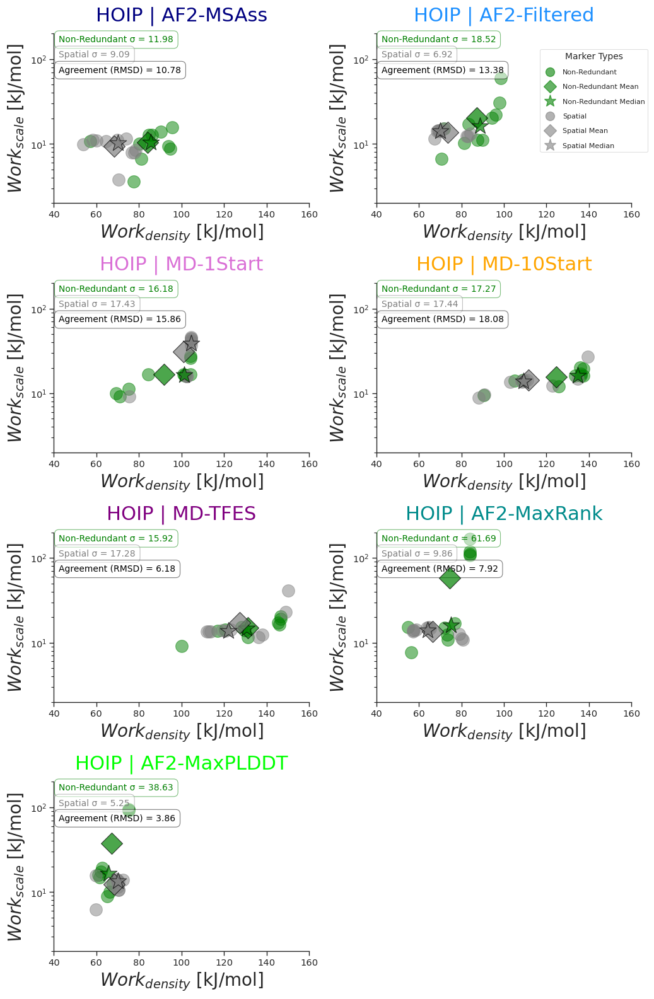

In [150]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Set up the data
# Filter data for specific split types
_ensemble_pmf_df = ensemble_pmf_df[ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]

# Filter for dataset order and use the new naming system
_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["ensemble"].isin(full_dataset_colours)]

# Force the order of the datasets using new naming
_ensemble_pmf_df["ensemble"] = pd.Categorical(_ensemble_pmf_df["ensemble"], 
                                            categories=full_dataset_colours, 
                                            ordered=True)

_ensemble_pmf_df = _ensemble_pmf_df[_ensemble_pmf_df["analysis"]=="BV"]
# Define consistent styles for split types using new color scheme
split_styles = {
    'R3': {'marker': 'o', 'color': split_type_dataset_colours['R3']},
    'Sp': {'marker': 'o', 'color': split_type_dataset_colours['Sp']}
}

# Set figure style
sns.set_style("ticks")

# Create the FacetGrid
g = sns.FacetGrid(_ensemble_pmf_df, 
                #   row="protein",
                 col_wrap=2, 
                  col="ensemble", 
                  height=4, 
                  aspect=1.3, 
                  sharey=False, 
                  sharex=False)

# Custom scatter plot function with consistent styling
def custom_scatter(data, **kwargs):
    ax = plt.gca()
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        ax.scatter(subset["-Tdelta_S_opt_kj"], 
                  subset["delta_H_abs_kj"],
                  marker=style['marker'],
                  color=style['color'],
                  s=200,
                  label=split_name_mapping[split_type],
                  alpha=0.5)

# Function to calculate and annotate means, medians, and stats with consistent styling
def annotate_statistics(data, **kwargs):
    ax = plt.gca()
    means = {}  # Store means for RMSD calculation
    medians = {}  # Store medians for RMSD calculation
    
    for split_type, style in split_styles.items():
        subset = data[data["split_type"] == split_type]
        if len(subset) > 0:
            # Calculate statistics
            mean_x = subset["-Tdelta_S_opt_kj"].mean()
            mean_y = subset["delta_H_abs_kj"].mean()
            median_x = subset["-Tdelta_S_opt_kj"].median()
            median_y = subset["delta_H_abs_kj"].median()
            
            means[split_type] = np.array([mean_x, mean_y])
            medians[split_type] = np.array([median_x, median_y])
            
            # Calculate multivariate standard deviation
            X = np.vstack([subset["-Tdelta_S_opt_kj"], subset["delta_H_abs_kj"]]).T
            cov_matrix = np.cov(X.T)
            mult_std = np.sqrt(np.trace(cov_matrix))
            
            # Plot mean with diamond marker
            ax.scatter(mean_x, mean_y, 
                      marker='D',  # Diamond for mean
                      s=300,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Mean',
                      alpha=0.7,
                      zorder=5)
            
            # Plot median with star marker
            ax.scatter(median_x, median_y, 
                      marker='*',  # Star for median
                      s=400,
                      color=style['color'], 
                      edgecolor='black',
                      label=f'{split_name_mapping[split_type]} Median',
                      alpha=0.7,
                      zorder=5)
            
            # Add std dev annotation with refined styling
            ax.annotate(f'{split_name_mapping[split_type]} σ = {mult_std:.2f}',
                       xy=(0.02, 0.95 - (0.09 * list(split_styles.keys()).index(split_type))),
                       xycoords='axes fraction',
                       fontsize=10,
                       color=style['color'],
                       bbox=dict(facecolor='white',
                                edgecolor=style['color'],
                                alpha=0.5,
                                boxstyle='round,pad=0.5'))
    
    # Calculate and annotate RMSD between medians if we have both split types
    if len(medians) == 2:
        msd = np.mean((medians['R3'] - medians['Sp'])**2)**0.5
        ax.annotate(f'Agreement (RMSD) = {msd:.2f}',
                   xy=(0.02, 0.77),  # Position below the other annotations
                   xycoords='axes fraction',
                   fontsize=10,
                   color='black',
                   bbox=dict(facecolor='white',
                            edgecolor='black',
                            alpha=0.5,
                            boxstyle='round,pad=0.5'))

# Apply the plotting functions
g.map_dataframe(custom_scatter)
g.map_dataframe(annotate_statistics)

# Custom function to set colored titles with refined styling
def set_colored_titles(figure):
    for ax in figure.axes:
        title = ax.get_title()
        if title:
            # The title should just be the ensemble name
            ensemble = title.strip()
            if ensemble in full_dataset_colours:
                ax.set_title(f"{protein} | {ensemble}", 
                           color=full_dataset_colours[ensemble],
                           pad=15,
                           fontsize=22,)
                        #    fontweight='bold')

# Set and style titles
g.set_titles(col_template="{col_name}")  # Use only the column name
set_colored_titles(g.fig)

# Add styled axis labels - ensure all subplots have labels
for ax in g.axes.flat:
    ax.set_xlabel(metric_axis_mapping["-Tdelta_S_opt_kj"], fontsize=20)
    ax.set_ylabel(metric_axis_mapping["delta_H_abs_kj"], fontsize=20)

# Create refined legend elements
handles = []
labels = []

for split_type, style in split_styles.items():
    # Data points
    handles.append(plt.Line2D([0], [0], 
                            marker=style['marker'],
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.6,
                            label=split_name_mapping[split_type]))
    # Mean markers
    handles.append(plt.Line2D([0], [0], 
                            marker='D',  # Diamond for mean
                            color=style['color'],
                            linestyle='None',
                            markersize=10,
                            alpha=0.6,
                            label=f'{split_name_mapping[split_type]} Mean'))
    # Median markers
    handles.append(plt.Line2D([0], [0], 
                            marker='*',  # Star for median
                            color=style['color'],
                            linestyle='None',
                            markersize=14,
                            alpha=0.6,
                            label=f'{split_name_mapping[split_type]} Median'))
    labels.extend([
        split_name_mapping[split_type],
        f'{split_name_mapping[split_type]} Mean',
        f'{split_name_mapping[split_type]} Median'
    ])

# Add refined legend
g.fig.legend(handles, labels, 
            loc='upper right',
            bbox_to_anchor=(1, 0.95),
            title="Marker Types",
            title_fontsize=10,
            fontsize=8,
            frameon=True,
            framealpha=0.6,
            fancybox=True,
            labelspacing=1.2)

g.set(yscale="log", ylim=(2e0, 2e2),xlim=(40,160))  # Set y-scale to log and limits

# Final layout adjustments
plt.tight_layout()
plt.show()


In [151]:
dMSE_energy_df

,name,replicate,dMSE,dataset,system,system_name,calc_name,avg_H_opt,avg_H_opt_kj,avg_S_opt,...,likelihood_opt,likelihood_conf,quasi_likelihood,protein,method,fit,ensemble,split_type,split_name,analysis
0,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,1,-0.051038,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_1,test_HOIP_AF2_Cleaned_1,25062.249847,25.062250,-2.970819,...,0.961291,0.935729,0.962498,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
1,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,10,-0.021098,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_10,test_HOIP_AF2_Cleaned_10,14012.893928,14.012894,-60.139091,...,0.966809,0.945254,0.968007,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
2,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,2,-0.059236,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_2,test_HOIP_AF2_Cleaned_2,8861.141229,8.861141,-217.266310,...,0.972162,0.960045,0.971636,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
3,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,3,-0.028710,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_3,test_HOIP_AF2_Cleaned_3,12231.977548,12.231978,-89.114859,...,0.971117,0.954332,0.972943,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
4,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,4,-0.048437,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_4,test_HOIP_AF2_Cleaned_4,17668.427603,17.668428,-10.049734,...,0.961879,0.938022,0.963247,HOIP,Cleaned,BV,AF2-Filtered,R3,Non-Redundant,BV
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255,HOIP_max_plddt_BV_bench_Sp_res_neighbours,5,-0.107642,test,HOIP_max_plddt_BV_bench_Sp_res_neighbours,HOIP_max_plddt_BV_bench_Sp_res_neighbours_5,test_HOIP_max_plddt_5,13032.835064,13.032835,-43.919944,...,0.972128,0.953627,0.972075,HOIP,plddt,BV,AF2-MaxPLDDT,Sp,Spatial,BV
256,HOIP_max_plddt_BV_bench_Sp_res_neighbours,6,-0.116212,test,HOIP_max_plddt_BV_bench_Sp_res_neighbours,HOIP_max_plddt_BV_bench_Sp_res_neighbours_6,test_HOIP_max_plddt_6,13078.954611,13.078955,-41.833801,...,0.972082,0.953262,0.972017,HOIP,plddt,BV,AF2-MaxPLDDT,Sp,Spatial,BV
257,HOIP_max_plddt_BV_bench_Sp_res_neighbours,7,-0.065129,test,HOIP_max_plddt_BV_bench_Sp_res_neighbours,HOIP_max_plddt_BV_bench_Sp_res_neighbours_7,test_HOIP_max_plddt_7,9440.963386,9.440963,-179.751008,...,0.976389,0.961816,0.975434,HOIP,plddt,BV,AF2-MaxPLDDT,Sp,Spatial,BV
258,HOIP_max_plddt_BV_bench_Sp_res_neighbours,8,0.020527,test,HOIP_max_plddt_BV_bench_Sp_res_neighbours,HOIP_max_plddt_BV_bench_Sp_res_neighbours_8,test_HOIP_max_plddt_8,13867.270449,13.867270,-52.919446,...,0.975513,0.956653,0.976632,HOIP,plddt,BV,AF2-MaxPLDDT,Sp,Spatial,BV


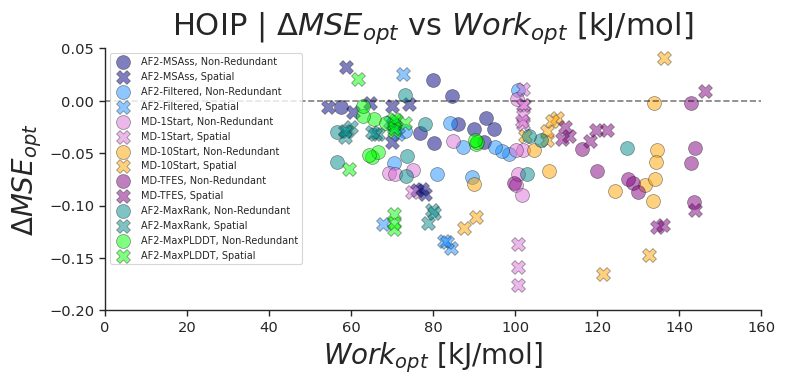

In [152]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Set publication-ready style
sns.set_style("ticks")

# Filter the dataframe


dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3", "Sp"])]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["ensemble"].isin(full_dataset_colours.keys())]

# Create figure with specific size for publication
fig, ax = plt.subplots(figsize=(8,4))

# Create scatter plot with publication-ready formatting
for ensemble in full_dataset_colours.keys():
    for split, marker in {'Non-Redundant': 'o', 'Spatial': 'X'}.items():
        # Filter data for this ensemble and split
        subset = dMSE_energy_df[(dMSE_energy_df['ensemble'] == ensemble) & 
                              (dMSE_energy_df['split_name'] == split)]
        
        # Plot with appropriate styling
        ax.scatter(subset['delta_G_opt_kj'], subset['dMSE'],
                  color=full_dataset_colours[ensemble],
                  marker=marker,
                  s=100,
                  alpha=0.5,
                  label=f"{ensemble}, {split}",
                  edgecolor='k',
                  linewidth=0.5)

# add title
metric_name1 = metric_axis_mapping.get("dMSE", 'Unknown Metric')
metric_name2 = metric_axis_mapping.get("delta_G_opt_kj", 'Unknown Metric')
protein_name = "HOIP"  # Replace with actual protein name if available
plt.title(f"{protein_name} | {metric_name1} vs {metric_name2}", fontsize=22, pad=10)
# 
# Add horizontal line at y=0
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)

# Format axes for publication
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(direction='out', length=4, width=1)

# Set labels using standardized mapping
ax.set_xlabel(metric_axis_mapping["delta_G_opt_kj"], fontsize=20)
ax.set_ylabel(metric_axis_mapping["dMSE"], fontsize=20)

# Set axis limits
ax.set_ylim((-0.2, 0.05))
ax.set_xlim((0, 160))
# log scale for x-axis
# ax.set_xscale('log')

# Create custom legend with both ensemble and split type represented
handles, labels = ax.get_legend_handles_labels()
legend = ax.legend(fontsize=7, frameon=True)#, loc='lower left')

# Finalize layout and display
plt.tight_layout()
plt.show()


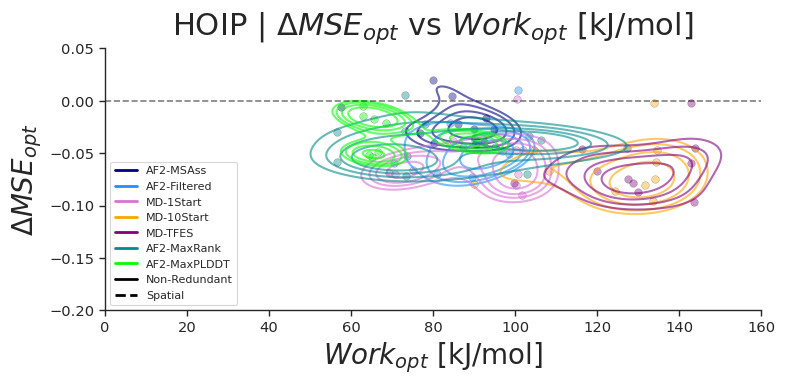

In [153]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Set publication-ready style
sns.set_style("ticks")

# Filter the dataframe
dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3"])]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["ensemble"].isin(full_dataset_colours.keys())]

# Create figure with specific size for publication
fig, ax = plt.subplots(figsize=(8,4))

# Create contour/KDE plot for each ensemble and split combination
for ensemble in full_dataset_colours.keys():
    for split_type, split_name in zip(['R3', 'Sp'], ['Non-Redundant', 'Spatial']):
        # Filter data for this ensemble and split
        subset = dMSE_energy_df[(dMSE_energy_df['ensemble'] == ensemble) & 
                              (dMSE_energy_df['split_type'] == split_type)]
        
        if len(subset) > 1:  # Need at least 2 points for KDE
            # Create KDE plot with transparency gradient
            sns.kdeplot(data=subset, x='delta_G_opt_kj', y='dMSE',
                       color=full_dataset_colours[ensemble],
                       alpha=0.6,
                       levels=5,
                       thresh=0.5,
                       linestyles='--' if split_type == 'Sp' else '-',
                       linewidths=1.5,
                       ax=ax)
            
            # Add scatter points for reference
            ax.scatter(subset['delta_G_opt_kj'], subset['dMSE'],
                      color=full_dataset_colours[ensemble],
                      marker='X' if split_type == 'Sp' else 'o',
                      s=30,
                      alpha=0.4,
                      edgecolor='k',
                      linewidth=0.3)

# Add title
metric_name1 = metric_axis_mapping.get("dMSE", 'Unknown Metric')
metric_name2 = metric_axis_mapping.get("delta_G_opt_kj", 'Unknown Metric')
protein_name = "HOIP"
plt.title(f"{protein_name} | {metric_name1} vs {metric_name2}", fontsize=22, pad=10)

# Add horizontal line at y=0
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)

# Format axes for publication
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(direction='out', length=4, width=1)

# Set labels using standardized mapping
ax.set_xlabel(metric_axis_mapping["delta_G_opt_kj"], fontsize=20)
ax.set_ylabel(metric_axis_mapping["dMSE"], fontsize=20)

# Set axis limits
ax.set_ylim((-0.2, 0.05))
ax.set_xlim((0, 160))

# Create custom legend
from matplotlib.lines import Line2D
legend_elements = []

# Add ensemble colors
for ensemble in full_dataset_colours.keys():
    legend_elements.append(Line2D([0], [0], color=full_dataset_colours[ensemble], 
                                 lw=2, label=ensemble))

# Add split type styles
legend_elements.append(Line2D([0], [0], color='black', linestyle='-', 
                             lw=2, label='Non-Redundant'))
legend_elements.append(Line2D([0], [0], color='black', linestyle='--', 
                             lw=2, label='Spatial'))

ax.legend(handles=legend_elements, fontsize=8, frameon=True, loc='lower left')

# Finalize layout and display
plt.tight_layout()
plt.show()


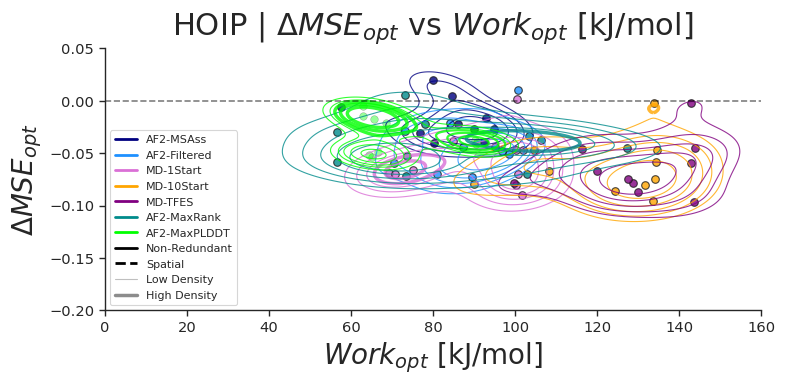

In [154]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde

# Set publication-ready style
sns.set_style("ticks")

# Filter the dataframe
dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3"])]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["ensemble"].isin(full_dataset_colours.keys())]

# Create figure with specific size for publication
fig, ax = plt.subplots(figsize=(8,4))

# Method 1: Using varying line widths and alpha for different density levels
def create_gradient_kde(subset, color, linestyle, ax):
    """Create KDE with gradient line widths and transparency"""
    if len(subset) < 2:
        return
    
    # Create KDE manually for more control
    x = subset['delta_G_opt_kj'].values
    y = subset['dMSE'].values
    
    # Create grid for KDE evaluation
    x_grid = np.linspace(x.min() - 10, x.max() + 10, 100)
    y_grid = np.linspace(y.min() - 0.05, y.max() + 0.05, 100)
    X, Y = np.meshgrid(x_grid, y_grid)
    
    # Compute KDE
    try:
        kde = gaussian_kde(np.vstack([x, y]))
        Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
        
        # Define contour levels (more levels for smoother gradient)
        levels = np.linspace(Z.min(), Z.max(), 8)[1:]  # Skip the minimum
        
        # Create line widths that increase with density (high density = thick lines)
        line_widths = np.linspace(0.8, 3.0, len(levels))
        
        # Create alpha values that increase with density
        alphas = np.linspace(0.3, 0.9, len(levels))
        
        # Plot contours with varying line widths and transparency
        for i, (level, lw, alpha) in enumerate(zip(levels, line_widths, alphas)):
            ax.contour(X, Y, Z, levels=[level], 
                      colors=[color], 
                      linewidths=lw,
                      linestyles=linestyle,
                      alpha=alpha)
                      
    except Exception as e:
        print(f"KDE failed: {e}")

# Method 2: Alternative using seaborn with custom styling
def create_seaborn_gradient_kde(subset, color, linestyle, ax):
    """Alternative method using seaborn with post-processing"""
    if len(subset) < 2:
        return
        
    # Create the KDE plot
    kde_plot = sns.kdeplot(data=subset, x='delta_G_opt_kj', y='dMSE',
                          color=color,
                          levels=6,
                          thresh=0.3,
                          linestyles=linestyle,
                          ax=ax)
    
    # Get the contour collections and modify them
    for collection in ax.collections:
        if hasattr(collection, 'get_paths') and len(collection.get_paths()) > 0:
            # Get current line widths
            current_lw = collection.get_linewidths()
            if len(current_lw) > 0:
                # Create gradient: outer contours thin, inner contours thick
                n_levels = len(collection.get_paths())
                new_widths = np.linspace(0.8, 2.5, n_levels)
                new_alphas = np.linspace(0.4, 0.9, n_levels)
                
                # Apply new styling
                collection.set_linewidths(new_widths)
                collection.set_alpha(0.8)  # Base alpha

# Create contour/KDE plot for each ensemble and split combination
for ensemble in full_dataset_colours.keys():
    for split_type, split_name in zip(['R3', 'Sp'], ['Non-Redundant', 'Spatial']):
        # Filter data for this ensemble and split
        subset = dMSE_energy_df[(dMSE_energy_df['ensemble'] == ensemble) &
                               (dMSE_energy_df['split_type'] == split_type)]
        
        if len(subset) > 1:  # Need at least 2 points for KDE
            linestyle = '--' if split_type == 'Sp' else '-'
            
            # Use Method 1 for gradient KDE
            create_seaborn_gradient_kde(subset, full_dataset_colours[ensemble], linestyle, ax)
            
            # Add scatter points for reference
            ax.scatter(subset['delta_G_opt_kj'], subset['dMSE'],
                      color=full_dataset_colours[ensemble],
                      marker='X' if split_type == 'Sp' else 'o',
                      s=30,
                      alpha=0.4,
                      edgecolor='k',
                      linewidth=0.3)

# Method 3: Using filled contours with transparency gradient
def add_filled_density_regions(subset, color, ax):
    """Add filled regions with transparency gradient"""
    if len(subset) < 2:
        return
        
    x = subset['delta_G_opt_kj'].values
    y = subset['dMSE'].values
    
    # Create grid for KDE evaluation
    x_grid = np.linspace(x.min() - 10, x.max() + 10, 50)
    y_grid = np.linspace(y.min() - 0.05, y.max() + 0.05, 50)
    X, Y = np.meshgrid(x_grid, y_grid)
    
    try:
        kde = gaussian_kde(np.vstack([x, y]))
        Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
        
        # Create filled contours with decreasing alpha for outer regions
        levels = np.percentile(Z.flatten(), [60, 70, 80, 90, 95])
        alphas = [0.1, 0.15, 0.2, 0.25, 0.3]
        
        for level, alpha in zip(levels, alphas):
            ax.contourf(X, Y, Z, levels=[level, Z.max()], 
                       colors=[color], alpha=alpha)
                       
    except Exception as e:
        print(f"Filled contour failed: {e}")

# Uncomment to add filled regions (optional)
# for ensemble in full_dataset_colours.keys():
#     subset = dMSE_energy_df[dMSE_energy_df['ensemble'] == ensemble]
#     if len(subset) > 1:
#         add_filled_density_regions(subset, full_dataset_colours[ensemble], ax)

# Add title
metric_name1 = metric_axis_mapping.get("dMSE", 'Unknown Metric')
metric_name2 = metric_axis_mapping.get("delta_G_opt_kj", 'Unknown Metric')
protein_name = "HOIP"
plt.title(f"{protein_name} | {metric_name1} vs {metric_name2}", fontsize=22, pad=10)

# Add horizontal line at y=0
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)

# Format axes for publication
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(direction='out', length=4, width=1)

# Set labels using standardized mapping
ax.set_xlabel(metric_axis_mapping["delta_G_opt_kj"], fontsize=20)
ax.set_ylabel(metric_axis_mapping["dMSE"], fontsize=20)

# Set axis limits
ax.set_ylim((-0.2, 0.05))
ax.set_xlim((0, 160))

# Create custom legend
from matplotlib.lines import Line2D
legend_elements = []

# Add ensemble colors
for ensemble in full_dataset_colours.keys():
    legend_elements.append(Line2D([0], [0], color=full_dataset_colours[ensemble],
                                 lw=2, label=ensemble))

# Add split type styles
legend_elements.append(Line2D([0], [0], color='black', linestyle='-',
                             lw=2, label='Non-Redundant'))
legend_elements.append(Line2D([0], [0], color='black', linestyle='--',
                             lw=2, label='Spatial'))

# Add density gradient explanation
legend_elements.append(Line2D([0], [0], color='gray', lw=0.8, alpha=0.5,
                             label='Low Density'))
legend_elements.append(Line2D([0], [0], color='gray', lw=2.5, alpha=0.9,
                             label='High Density'))

ax.legend(handles=legend_elements, fontsize=8, frameon=True, loc='lower left')

# Finalize layout and display
plt.tight_layout()
plt.show()

/tmp/ipykernel_2064812/2467110706.py:48: UserWarning: No contour levels were found within the data range.
  ax.contour(X, Y, Z, levels=[level],


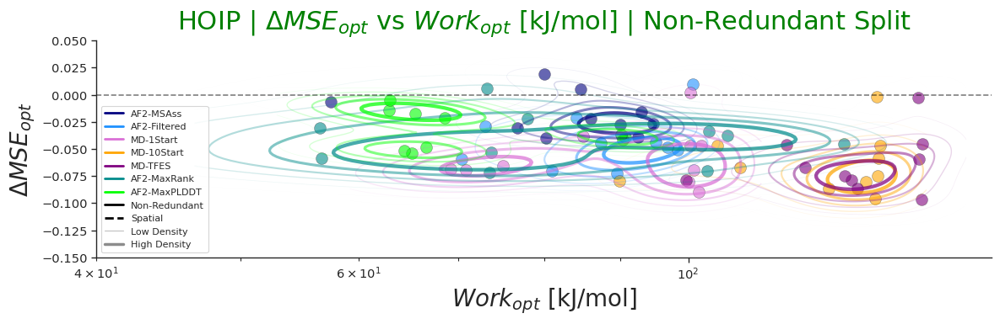

In [155]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde

# Set publication-ready style
sns.set_style("ticks")

# Filter the dataframe
dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3"])]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["ensemble"].isin(full_dataset_colours.keys())]

# Create figure with specific size for publication
fig, ax = plt.subplots(figsize=(12,4))

# Method 1: Using varying line widths and alpha for different density levels
def create_gradient_kde(subset, color, linestyle, ax):
    """Create KDE with gradient line widths and transparency"""
    if len(subset) < 2:
        return
    
    # Create KDE manually for more control
    x = subset['delta_G_opt_kj'].values
    y = subset['dMSE'].values
    
    # Create grid for KDE evaluation
    x_grid = np.linspace(x.min() - 10, x.max() + 10, 100)
    y_grid = np.linspace(y.min() - 0.05, y.max() + 0.05, 100)
    X, Y = np.meshgrid(x_grid, y_grid)
    
    # Compute KDE
    try:
        kde = gaussian_kde(np.vstack([x, y]))
        Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
        
        # Define contour levels (more levels for smoother gradient)
        levels = np.linspace(Z.min(), Z.max(), 8)[1:]  # Skip the minimum
        
        # Create line widths that increase with density (high density = thick lines)
        line_widths = np.linspace(0.5, 2.0, len(levels))
        line_widths = line_widths**2  # Square to enhance gradient effect
        # Create alpha values that increase with density
        alphas = np.linspace(0.1, 1.0, len(levels))
        alphas = alphas**2
        
        # Plot contours with varying line widths and transparency
        for i, (level, lw, alpha) in enumerate(zip(levels, line_widths, alphas)):
            ax.contour(X, Y, Z, levels=[level], 
                      colors=[color], 
                      linewidths=lw,
                      linestyles=linestyle,
                      alpha=alpha)
                      
    except Exception as e:
        print(f"KDE failed: {e}")

# Method 2: Alternative using seaborn with custom styling
def create_seaborn_gradient_kde(subset, color, linestyle, ax):
    """Alternative method using seaborn with post-processing"""
    if len(subset) < 2:
        return
        
    # Create the KDE plot
    kde_plot = sns.kdeplot(data=subset, x='delta_G_opt_kj', y='dMSE',
                          color=color,
                          levels=6,
                          thresh=0.3,
                          linestyles=linestyle,
                          ax=ax)
    
    # Get the contour collections and modify them
    for collection in ax.collections:
        if hasattr(collection, 'get_paths') and len(collection.get_paths()) > 0:
            # Get current line widths
            current_lw = collection.get_linewidths()
            if len(current_lw) > 0:
                # Create gradient: outer contours thin, inner contours thick
                n_levels = len(collection.get_paths())
                new_widths = np.linspace(0.8, 2.5, n_levels)
                new_alphas = np.linspace(0.4, 0.9, n_levels)
                
                # Apply new styling
                collection.set_linewidths(new_widths)
                collection.set_alpha(0.8)  # Base alpha

# Create contour/KDE plot for each ensemble and split combination
for ensemble in full_dataset_colours.keys():
    for split_type, split_name in zip(['R3', 'Sp'], ['Non-Redundant', 'Spatial']):
        # Filter data for this ensemble and split
        subset = dMSE_energy_df[(dMSE_energy_df['ensemble'] == ensemble) &
                               (dMSE_energy_df['split_type'] == split_type)]
        
        if len(subset) > 1:  # Need at least 2 points for KDE
            linestyle = '--' if split_type == 'Sp' else '-'
            
            # Use Method 1 for gradient KDE
            create_gradient_kde(subset, full_dataset_colours[ensemble], linestyle, ax)
            
            # Add scatter points for reference
            ax.scatter(subset['delta_G_opt_kj'], subset['dMSE'],
                      color=full_dataset_colours[ensemble],
                      marker='X' if split_type == 'Sp' else 'o',
                      s=100,
                      alpha=0.6,
                      edgecolor='k',
                      linewidth=0.3)

# Method 3: Using filled contours with transparency gradient
def add_filled_density_regions(subset, color, ax):
    """Add filled regions with transparency gradient"""
    if len(subset) < 2:
        return
        
    x = subset['delta_G_opt_kj'].values
    y = subset['dMSE'].values
    
    # Create grid for KDE evaluation
    x_grid = np.linspace(x.min() - 10, x.max() + 10, 50)
    y_grid = np.linspace(y.min() - 0.05, y.max() + 0.05, 50)
    X, Y = np.meshgrid(x_grid, y_grid)
    
    try:
        kde = gaussian_kde(np.vstack([x, y]))
        Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
        
        # Create filled contours with decreasing alpha for outer regions
        levels = np.percentile(Z.flatten(), [60, 70, 80, 90, 95])
        alphas = [0.1, 0.15, 0.2, 0.25, 0.3]
        
        for level, alpha in zip(levels, alphas):
            ax.contourf(X, Y, Z, levels=[level, Z.max()], 
                       colors=[color], alpha=alpha)
                       
    except Exception as e:
        print(f"Filled contour failed: {e}")

# Uncomment to add filled regions (optional)
# for ensemble in full_dataset_colours.keys():
#     subset = dMSE_energy_df[dMSE_energy_df['ensemble'] == ensemble]
#     if len(subset) > 1:
#         add_filled_density_regions(subset, full_dataset_colours[ensemble], ax)

# Add title
metric_name1 = metric_axis_mapping.get("dMSE", 'Unknown Metric')
metric_name2 = metric_axis_mapping.get("delta_G_opt_kj", 'Unknown Metric')
protein_name = "HOIP"
plt.title(f"{protein_name} | {metric_name1} vs {metric_name2} | Non-Redundant Split", fontsize=22, pad=10, color='green')

# Add horizontal line at y=0
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)

# Format axes for publication
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(direction='out', length=4, width=1)

# Set labels using standardized mapping
ax.set_xlabel(metric_axis_mapping["delta_G_opt_kj"], fontsize=20)
ax.set_ylabel(metric_axis_mapping["dMSE"], fontsize=20)

# Set axis limits
ax.set_ylim((-0.15, 0.05))
ax.set_xlim((40, 160))

# Create custom legend
from matplotlib.lines import Line2D
legend_elements = []

# Add ensemble colors
for ensemble in full_dataset_colours.keys():
    legend_elements.append(Line2D([0], [0], color=full_dataset_colours[ensemble],
                                 lw=2, label=ensemble))

# Add split type styles
legend_elements.append(Line2D([0], [0], color='black', linestyle='-',
                             lw=2, label='Non-Redundant'))
legend_elements.append(Line2D([0], [0], color='black', linestyle='--',
                             lw=2, label='Spatial'))

# Add density gradient explanation
legend_elements.append(Line2D([0], [0], color='gray', lw=0.8, alpha=0.5,
                             label='Low Density'))
legend_elements.append(Line2D([0], [0], color='gray', lw=2.5, alpha=0.9,
                             label='High Density'))

ax.legend(handles=legend_elements, fontsize=8, frameon=True, loc='lower left')
plt.xscale("log")

# Finalize layout and display
plt.tight_layout()
plt.show()

/tmp/ipykernel_2064812/1151253000.py:48: UserWarning: No contour levels were found within the data range.
  ax.contour(X, Y, Z, levels=[level],


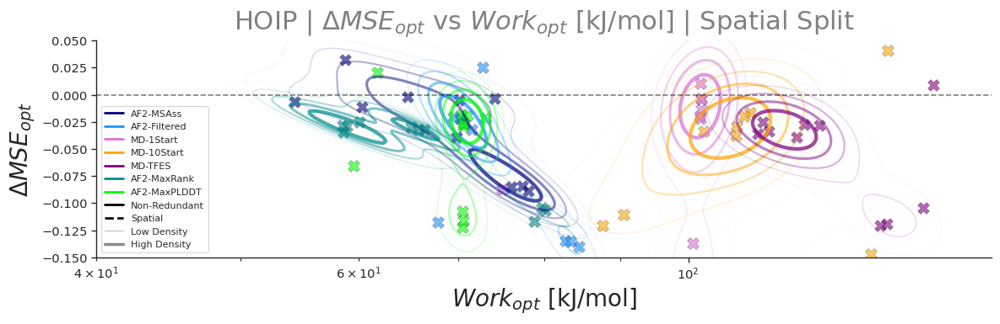

In [156]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde

# Set publication-ready style
sns.set_style("ticks")

# Filter the dataframe
dMSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["Sp"])]
dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["ensemble"].isin(full_dataset_colours.keys())]

# Create figure with specific size for publication
fig, ax = plt.subplots(figsize=(12,4))

# Method 1: Using varying line widths and alpha for different density levels
def create_gradient_kde(subset, color, linestyle, ax):
    """Create KDE with gradient line widths and transparency"""
    if len(subset) < 2:
        return
    
    # Create KDE manually for more control
    x = subset['delta_G_opt_kj'].values
    y = subset['dMSE'].values
    
    # Create grid for KDE evaluation
    x_grid = np.linspace(x.min() - 10, x.max() + 10, 100)
    y_grid = np.linspace(y.min() - 0.05, y.max() + 0.05, 100)
    X, Y = np.meshgrid(x_grid, y_grid)
    
    # Compute KDE
    try:
        kde = gaussian_kde(np.vstack([x, y]))
        Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
        
        # Define contour levels (more levels for smoother gradient)
        levels = np.linspace(Z.min(), Z.max(), 8)[1:]  # Skip the minimum
        
        # Create line widths that increase with density (high density = thick lines)
        line_widths = np.linspace(0.5, 2.0, len(levels))
        line_widths = line_widths**2  # Square to enhance gradient effect
        # Create alpha values that increase with density
        alphas = np.linspace(0.1, 1.0, len(levels))
        alphas = alphas**2
        
        # Plot contours with varying line widths and transparency
        for i, (level, lw, alpha) in enumerate(zip(levels, line_widths, alphas)):
            ax.contour(X, Y, Z, levels=[level], 
                      colors=[color], 
                      linewidths=lw,
                      linestyles=linestyle,
                      alpha=alpha)
                      
    except Exception as e:
        print(f"KDE failed: {e}")

# Method 2: Alternative using seaborn with custom styling
def create_seaborn_gradient_kde(subset, color, linestyle, ax):
    """Alternative method using seaborn with post-processing"""
    if len(subset) < 2:
        return
        
    # Create the KDE plot
    kde_plot = sns.kdeplot(data=subset, x='delta_G_opt_kj', y='dMSE',
                          color=color,
                          levels=6,
                          thresh=0.3,
                          linestyles=linestyle,
                          ax=ax)
    
    # Get the contour collections and modify them
    for collection in ax.collections:
        if hasattr(collection, 'get_paths') and len(collection.get_paths()) > 0:
            # Get current line widths
            current_lw = collection.get_linewidths()
            if len(current_lw) > 0:
                # Create gradient: outer contours thin, inner contours thick
                n_levels = len(collection.get_paths())
                new_widths = np.linspace(0.8, 2.5, n_levels)
                new_alphas = np.linspace(0.4, 0.9, n_levels)
                
                # Apply new styling
                collection.set_linewidths(new_widths)
                collection.set_alpha(0.8)  # Base alpha

# Create contour/KDE plot for each ensemble and split combination
for ensemble in full_dataset_colours.keys():
    for split_type, split_name in zip(['R3', 'Sp'], ['Non-Redundant', 'Spatial']):
        # Filter data for this ensemble and split
        subset = dMSE_energy_df[(dMSE_energy_df['ensemble'] == ensemble) &
                               (dMSE_energy_df['split_type'] == split_type)]
        
        if len(subset) > 1:  # Need at least 2 points for KDE
            linestyle = '-' if split_type == 'Sp' else '-'
            
            # Use Method 1 for gradient KDE
            create_gradient_kde(subset, full_dataset_colours[ensemble], linestyle, ax)
            
            # Add scatter points for reference
            ax.scatter(subset['delta_G_opt_kj'], subset['dMSE'],
                      color=full_dataset_colours[ensemble],
                      marker='X' if split_type == 'Sp' else 'o',
                      s=100,
                      alpha=0.6,
                      edgecolor='k',
                      linewidth=0.3)

# Method 3: Using filled contours with transparency gradient
def add_filled_density_regions(subset, color, ax):
    """Add filled regions with transparency gradient"""
    if len(subset) < 2:
        return
        
    x = subset['delta_G_opt_kj'].values
    y = subset['dMSE'].values
    
    # Create grid for KDE evaluation
    x_grid = np.linspace(x.min() - 10, x.max() + 10, 50)
    y_grid = np.linspace(y.min() - 0.05, y.max() + 0.05, 50)
    X, Y = np.meshgrid(x_grid, y_grid)
    
    try:
        kde = gaussian_kde(np.vstack([x, y]))
        Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
        
        # Create filled contours with decreasing alpha for outer regions
        levels = np.percentile(Z.flatten(), [60, 70, 80, 90, 95])
        alphas = [0.1, 0.15, 0.2, 0.25, 0.3]
        
        for level, alpha in zip(levels, alphas):
            ax.contourf(X, Y, Z, levels=[level, Z.max()], 
                       colors=[color], alpha=alpha)
                       
    except Exception as e:
        print(f"Filled contour failed: {e}")

# Uncomment to add filled regions (optional)
# for ensemble in full_dataset_colours.keys():
#     subset = dMSE_energy_df[dMSE_energy_df['ensemble'] == ensemble]
#     if len(subset) > 1:
#         add_filled_density_regions(subset, full_dataset_colours[ensemble], ax)

# Add title
metric_name1 = metric_axis_mapping.get("dMSE", 'Unknown Metric')
metric_name2 = metric_axis_mapping.get("delta_G_opt_kj", 'Unknown Metric')
protein_name = "HOIP"
plt.title(f"{protein_name} | {metric_name1} vs {metric_name2} | Spatial Split", fontsize=22, pad=10, color='grey')

# Add horizontal line at y=0
ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)

# Format axes for publication
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(direction='out', length=4, width=1)

# Set labels using standardized mapping
ax.set_xlabel(metric_axis_mapping["delta_G_opt_kj"], fontsize=20)
ax.set_ylabel(metric_axis_mapping["dMSE"], fontsize=20)

# Set axis limits
ax.set_ylim((-0.15, 0.05))
ax.set_xlim((40, 160))

# Create custom legend
from matplotlib.lines import Line2D
legend_elements = []

# Add ensemble colors
for ensemble in full_dataset_colours.keys():
    legend_elements.append(Line2D([0], [0], color=full_dataset_colours[ensemble],
                                 lw=2, label=ensemble))

# Add split type styles
legend_elements.append(Line2D([0], [0], color='black', linestyle='-',
                             lw=2, label='Non-Redundant'))
legend_elements.append(Line2D([0], [0], color='black', linestyle='--',
                             lw=2, label='Spatial'))

# Add density gradient explanation
legend_elements.append(Line2D([0], [0], color='gray', lw=0.8, alpha=0.5,
                             label='Low Density'))
legend_elements.append(Line2D([0], [0], color='gray', lw=2.5, alpha=0.9,
                             label='High Density'))

ax.legend(handles=legend_elements, fontsize=8, frameon=True, loc='lower left')
plt.xscale("log")
# Finalize layout and display
plt.tight_layout()
plt.show()

In [157]:

mean_dMSE_df["method"] = mean_dMSE_df["name"].apply(lambda x: x.split("_")[2])

mean_dMSE_df["fit"] = mean_dMSE_df["name"].apply(lambda x: x.split("_")[4])

print(mean_dMSE_df["method"].unique())

print(mean_dMSE_df["fit"].unique())

mean_dMSE_df["ensemble"] = mean_dMSE_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)

# if top or bottom in name add "500" to the end
mean_dMSE_df["ensemble"] = mean_dMSE_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)

# if dirty, clean or conf in name add af_ to the front
mean_dMSE_df["ensemble"] = mean_dMSE_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)

# if Good or Bad in name add MD to the front
mean_dMSE_df["ensemble"] = mean_dMSE_df["ensemble"].apply(lambda x: "MD_" + x if "Good" in x or "Bad" in x else x)

print(mean_dMSE_df.ensemble.unique())
print(len(mean_dMSE_df.ensemble.unique()))
fit_mean_dMSE_df = mean_dMSE_df[mean_dMSE_df["fit"] == "bench"]

mean_fit_mean_dMSE_df = fit_mean_dMSE_df.groupby(["name", "replicate", "protein", "split_type"])["dMSE"].mean().reset_index()



['TFES' '10Start' 'Cleaned' 'MSAss' '1Start' 'rank' 'plddt']
['bench']
['TFES' '10Start' 'Cleaned' 'MSAss' '1Start' 'rank' 'plddt']
7


In [158]:

dMSE_percentage_df["method"] = dMSE_percentage_df["name"].apply(lambda x: x.split("_")[2])

dMSE_percentage_df["fit"] = dMSE_percentage_df["name"].apply(lambda x: x.split("_")[4])

print(dMSE_percentage_df["method"].unique())

print(dMSE_percentage_df["fit"].unique())

dMSE_percentage_df["ensemble"] = dMSE_percentage_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)

# if top or bottom in name add "500" to the end
dMSE_percentage_df["ensemble"] = dMSE_percentage_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)

# if dirty, clean or conf in name add af_ to the front
dMSE_percentage_df["ensemble"] = dMSE_percentage_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)

# if Good or Bad in name add MD to the front
dMSE_percentage_df["ensemble"] = dMSE_percentage_df["ensemble"].apply(lambda x: "MD_" + x if "Good" in x or "Bad" in x else x)

print(dMSE_percentage_df.ensemble.unique())
print(len(dMSE_percentage_df.ensemble.unique()))

NameError: name 'dMSE_percentage_df' is not defined

In [ ]:

dMSE_df["method"] = dMSE_df["name"].apply(lambda x: x.split("_")[2])

dMSE_df["fit"] = dMSE_df["name"].apply(lambda x: x.split("_")[4])

print(dMSE_df["method"].unique())

print(dMSE_df["fit"].unique())

dMSE_df["ensemble"] = dMSE_df["method"].apply(lambda x: "Shaw_" + x if x == "400" else x)

# if top or bottom in name add "500" to the end
dMSE_df["ensemble"] = dMSE_df["ensemble"].apply(lambda x: x + "_500" if "top" in x or "bottom" in x else x)

# if dirty, clean or conf in name add af_ to the front
dMSE_df["ensemble"] = dMSE_df["ensemble"].apply(lambda x: "af_" + x if "dirty" in x or "clean" in x or "conf" in x else x)

# if Good or Bad in name add MD to the front
dMSE_df["ensemble"] = dMSE_df["ensemble"].apply(lambda x: "MD_" + x if "Good" in x or "Bad" in x else x)

print(dMSE_df.ensemble.unique())
print(len(dMSE_df.ensemble.unique()))

['Cleaned' 'rank' 'plddt']
['bench']
['Cleaned' 'rank' 'plddt']
3


In [ ]:
RW_mean_fit_mean_dMSE_df = mean_fit_mean_dMSE_df[["name", "replicate", "dMSE"]]
# 
# dMSE_energy_df = pd.merge(RW_mean_fit_mean_dMSE_df, BV_energy_df, on=["name", "replicate"], how="outer")

In [ ]:
# dMSE_energy_df

# dMSE_energy_df["dMSE/work"] = dMSE_energy_df["dMSE"]/dMSE_energy_df["ratio_energy_difference"]

# # dMSE_energy_df["JSD/work"] = dMSE_energy_df["JS_divergence"]/dMSE_energy_df["ratio_energy_difference"]


# dMSE_energy_df["dMSE*work"] = dMSE_energy_df["dMSE"]*dMSE_energy_df["ratio_energy_difference"]

# # dMSE_energy_df["JSD*work"] = dMSE_energy_df["JS_divergence"]*dMSE_energy_df["ratio_energy_difference"]


# # dMSE_energy_df["dMSE/JSD"]= dMSE_energy_df["dMSE"]/dMSE_energy_df["JS_divergence"]
# # dMSE_energy_df["dMSE*JSD"]= dMSE_energy_df["dMSE"]*dMSE_energy_df["JS_divergence"]


# dMSE_energy_df["dMSE/gibbs_free_energy"]= dMSE_energy_df["dMSE"]/dMSE_energy_df["gibbs_free_energy"]
# dMSE_energy_df["dMSE*gibbs_free_energy"]= dMSE_energy_df["dMSE"]*dMSE_energy_df["gibbs_free_energy"]



# dMSE_energy_df["exp(dMSE/gibbs_free_energy)"]= np.exp(dMSE_energy_df["dMSE"]/dMSE_energy_df["gibbs_free_energy"])
# dMSE_energy_df["exp(dMSE*gibbs_free_energy)"]= np.exp(dMSE_energy_df["dMSE"]*dMSE_energy_df["gibbs_free_energy"])

# dMSE_energy_df["exp(dMSE/%_energy_difference)"]= np.exp(dMSE_energy_df["dMSE"]/dMSE_energy_df["%_energy_difference"])

# dMSE_energy_df["Gfe*exp(dMSE)"]= dMSE_energy_df["gibbs_free_energy"]*np.exp(dMSE_energy_df["dMSE"])

# dMSE_energy_df["Gfe**(dMSE)"]= dMSE_energy_df["gibbs_free_energy"]**dMSE_energy_df["dMSE"]

# dMSE_energy_df["ratio**dMSE"]= dMSE_energy_df["ratio_energy_difference"]**dMSE_energy_df["dMSE"]

In [ ]:
# mean_dMSE_percentage_df = mean_dMSE_percentage_df[["name", "replicate", "dMSEratio","dMSE%"]]

# dMSE_percentage_energy_df = pd.merge(mean_dMSE_percentage_df, BV_energy_df, on=["name", "replicate"], how="outer")

In [ ]:
# dMSE_percentage_energy_df

In [ ]:
dMSE_ensemble_pmf_df = pd.merge(RW_mean_fit_mean_dMSE_df, ensemble_pmf_df, on=["name", "replicate"], how="inner")

dMSE_ensemble_pmf_df["method"] = dMSE_ensemble_pmf_df["name"].apply(lambda x: x.split("_")[3])

In [ ]:
dMSE_ensemble_pmf_df

,name,replicate,dMSE,dataset,system,system_name,calc_name,avg_H_opt,avg_H_opt_kj,avg_S_opt,...,K_abs,Q_abs,Z_opt,likelihood_opt,likelihood_conf,protein,method,ensemble,split_type,analysis
0,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,1,-0.323381,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_1,test_HOIP_AF2_Cleaned_1,25062.249847,25.062250,-5223.136588,...,23226.484375,NaN,2824.906621,0.528037,0.320233,HOIP,BV,Cleaned,R3,BV
1,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,10,-0.316661,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_10,test_HOIP_AF2_Cleaned_10,14012.893928,14.012894,-8685.665119,...,276.136713,NaN,1579.471799,0.349648,0.161106,HOIP,BV,Cleaned,R3,BV
2,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,2,-0.171668,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_2,test_HOIP_AF2_Cleaned_2,8861.141229,8.861141,-8776.153777,...,34.967143,NaN,998.788883,0.346577,0.164022,HOIP,BV,Cleaned,R3,BV
3,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,3,-0.331895,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_3,test_HOIP_AF2_Cleaned_3,12231.977548,12.231978,-8748.951740,...,135.169467,NaN,1378.734734,0.347244,0.131672,HOIP,BV,Cleaned,R3,BV
4,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,4,-0.351230,test,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence,HOIP_AF2_Cleaned_BV_bench_R3_k_sequence_4,test_HOIP_AF2_Cleaned_4,17668.427603,17.668428,-5669.127899,...,1196.570998,NaN,1991.507484,0.501931,0.151543,HOIP,BV,Cleaned,R3,BV
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,HOIP_max_plddt_noBV_bench_s_naive_sequential,5,0.000000,test,HOIP_max_plddt_noBV_bench_s_naive_sequential,HOIP_max_plddt_noBV_bench_s_naive_sequential_5,test_HOIP_max_plddt_5,7529.705513,7.529706,-7690.593201,...,20.498243,NaN,848.715302,0.395153,0.184125,HOIP,noBV,plddt,s,noBV
236,HOIP_max_plddt_noBV_bench_s_naive_sequential,6,0.000000,test,HOIP_max_plddt_noBV_bench_s_naive_sequential,HOIP_max_plddt_noBV_bench_s_naive_sequential_6,test_HOIP_max_plddt_6,7529.705513,7.529706,-7690.593201,...,20.498243,NaN,848.715302,0.395153,0.184125,HOIP,noBV,plddt,s,noBV
237,HOIP_max_plddt_noBV_bench_s_naive_sequential,7,0.000000,test,HOIP_max_plddt_noBV_bench_s_naive_sequential,HOIP_max_plddt_noBV_bench_s_naive_sequential_7,test_HOIP_max_plddt_7,7529.705513,7.529706,-7690.593201,...,20.498243,NaN,848.715302,0.395153,0.184125,HOIP,noBV,plddt,s,noBV
238,HOIP_max_plddt_noBV_bench_s_naive_sequential,8,0.000000,test,HOIP_max_plddt_noBV_bench_s_naive_sequential,HOIP_max_plddt_noBV_bench_s_naive_sequential_8,test_HOIP_max_plddt_8,7529.705513,7.529706,-7690.593201,...,20.498243,NaN,848.715302,0.395153,0.184125,HOIP,noBV,plddt,s,noBV


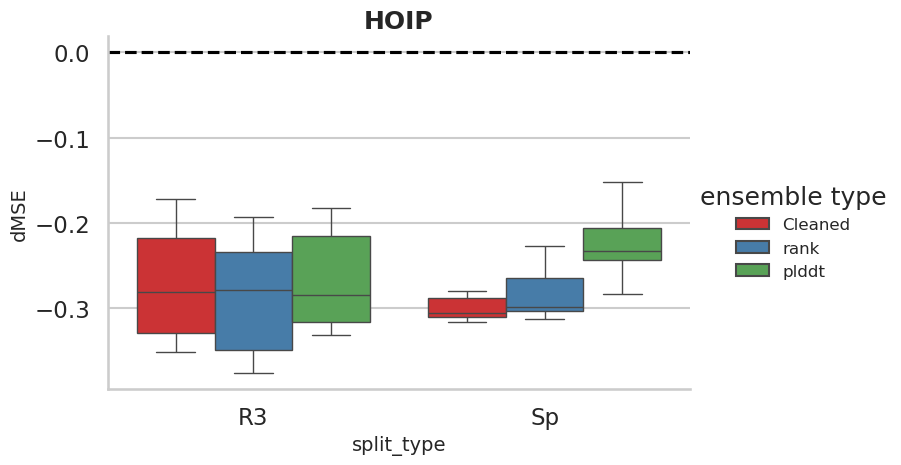

In [ ]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3","Sp"])]
# only include val dataset
_MSE_energy_df = _MSE_energy_df[_MSE_energy_df["method"]=="BV"]

# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["HOIP"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.boxplot, x="split_type", y="dMSE", hue="ensemble", palette="Set1")#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("split_type", fontsize=14)
g.set_ylabels("dMSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')
# # Adjust subplot spacing
g.tight_layout()

# Add legend
# g.set(xscale="log")
# g.set(ylim=(0, 0.5))
g.add_legend(title="ensemble type", fontsize=12)
# Show the plot
plt.show()

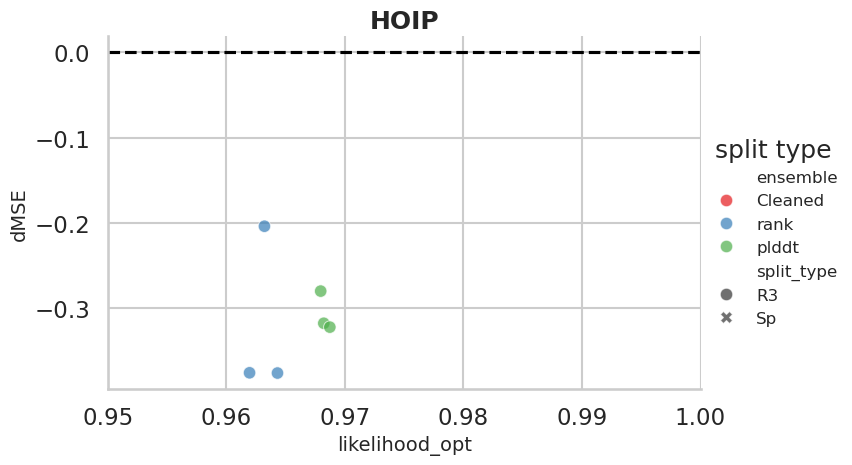

In [ ]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3","Sp"])]
_MSE_energy_df = _MSE_energy_df[_MSE_energy_df["method"]=="BV"]

# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["HOIP"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="likelihood_opt", y="dMSE", hue="ensemble", palette="Set1", style="split_type",alpha=0.7)#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("likelihood_opt", fontsize=14)
g.set_ylabels("dMSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')
g.tight_layout()
# Add legend
# g.set(xscale="log")
g.set(xlim=(0.95, 1))
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

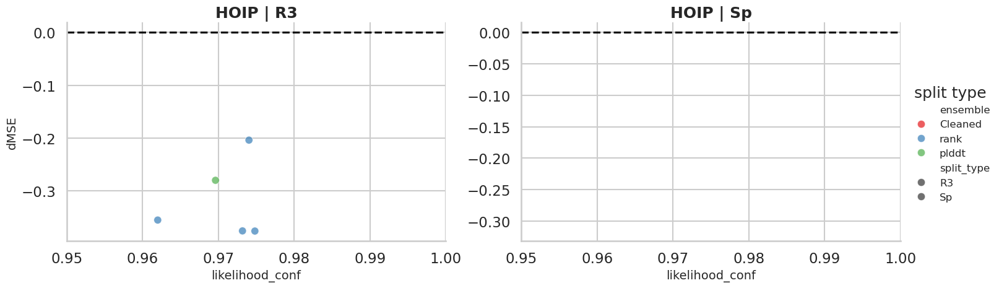

In [ ]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3","Sp"])]
_MSE_energy_df = _MSE_energy_df[_MSE_energy_df["method"]=="BV"]

# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein", col="split_type",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["HOIP"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="likelihood_conf", y="dMSE", hue="ensemble", palette="Set1", style="split_type",alpha=0.7)#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("likelihood_conf", fontsize=14)
g.set_ylabels("dMSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')
g.tight_layout()
# Add legend
# g.set(xscale="log")
g.set(xlim=(0.95, 1))
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

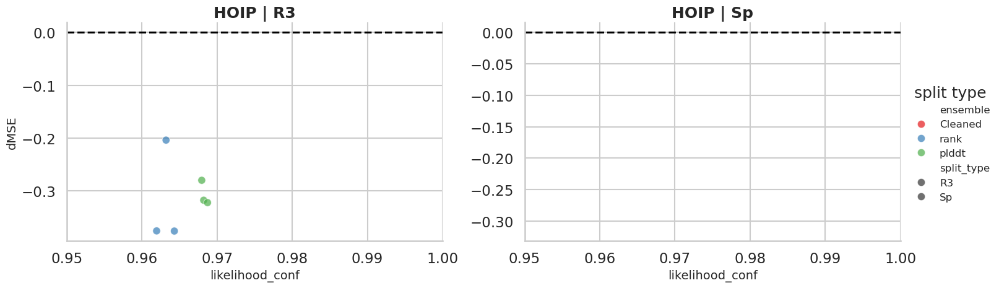

In [ ]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3","Sp"])]
_MSE_energy_df = _MSE_energy_df[_MSE_energy_df["method"]=="BV"]

# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein", col="split_type",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["HOIP"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="likelihood_opt", y="dMSE", hue="ensemble", palette="Set1", style="split_type",alpha=0.7)#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("likelihood_conf", fontsize=14)
g.set_ylabels("dMSE", fontsize=14)
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')
g.tight_layout()
# Add legend
# g.set(xscale="log")
g.set(xlim=(0.95, 1))
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

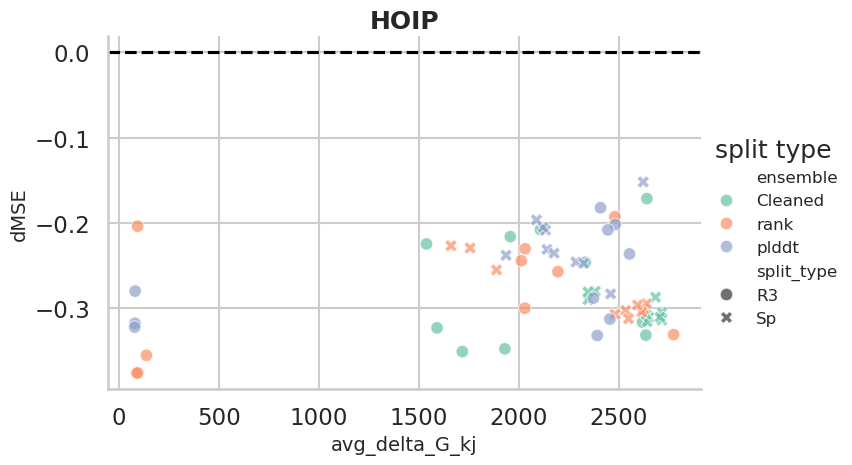

In [ ]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3","Sp"])]
_MSE_energy_df = _MSE_energy_df[_MSE_energy_df["method"]=="BV"]

# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["HOIP"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_G_opt_kj", y="dMSE", hue="ensemble", palette="Set2", style="split_type",alpha=0.7)#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("avg_delta_G_kj", fontsize=14)
g.set_ylabels("dMSE", fontsize=14)
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')  
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")
# g.set(ylim=(0, 0.5))
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

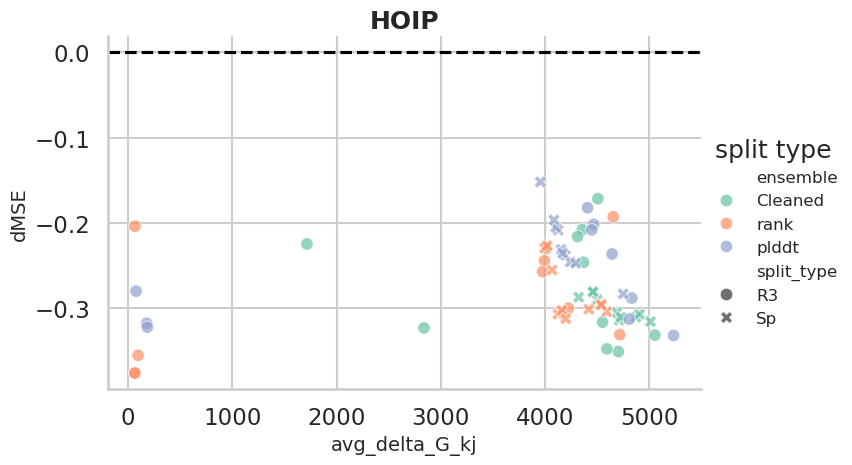

In [ ]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3","Sp"])]
_MSE_energy_df = _MSE_energy_df[_MSE_energy_df["method"]=="BV"]

# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["HOIP"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_G_conf_kj", y="dMSE", hue="ensemble", palette="Set2", style="split_type",alpha=0.7)#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("avg_delta_G_kj", fontsize=14)
g.set_ylabels("dMSE", fontsize=14)
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')  
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")
# g.set(ylim=(0, 0.5))
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

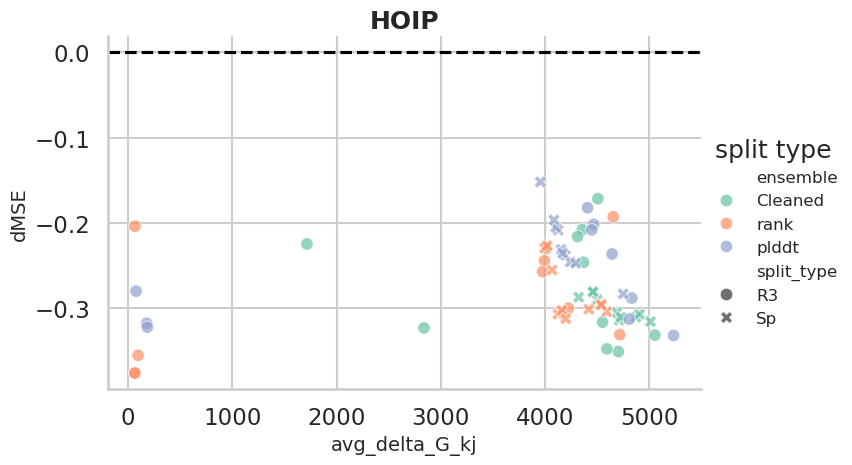

In [ ]:



import seaborn as sns
import matplotlib.pyplot as plt
# Set context and style
sns.set_context("talk")
sns.set_style("whitegrid")
# # Create a custom palette

_MSE_energy_df = dMSE_ensemble_pmf_df[dMSE_ensemble_pmf_df["split_type"].isin(["R3","Sp"])]
_MSE_energy_df = _MSE_energy_df[_MSE_energy_df["method"]=="BV"]

# _MSE_energy_df=MSE_energy_df
# Create the FacetGrid
g = sns.FacetGrid(_MSE_energy_df, row="protein",height=5, aspect=1.5, sharey=False, sharex=False, row_order=["HOIP"])#, col_order=split_order, sharex=True)
# Map the boxplot to the FacetGrid
g.map_dataframe(sns.scatterplot, x="avg_G_conf_kj", y="dMSE", hue="ensemble", palette="Set2", style="split_type",alpha=0.7)#, order=_dataset_order)
#, order=_dataset_order)
# Customize the plot
g.set_titles(row_template="{row_name}", col_template="{col_name}", fontsize=16, fontweight="bold")
g.set_xlabels("avg_delta_G_kj", fontsize=14)
g.set_ylabels("dMSE", fontsize=14)
for ax in g.axes.flat:
    ax.axhline(y=0, color='black', linestyle='--')  
# # Rotate x-tick labels
# for ax in g.axes.flat:
#     ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
# # Adjust subplot spacing
g.tight_layout()
# Add legend
# g.set(xscale="log")
# g.set(ylim=(0, 0.5))
g.add_legend(title="split type", fontsize=12)
# Show the plot
plt.show()

In [ ]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Assuming val_mse_BPTI_dfs is already filtered to include only 'Val' in "Type"
# val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']

# # remove mse less than 0
# val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]

# print(val_mse_dfs.mse.value_counts())
# # Set the figure size and style if not already set globally
# sns.set(style="whitegrid")
# _dMSE_energy_df = dMSE_energy_df[dMSE_energy_df["split_type"].isin(["R3","Sp"])]
# # Create a FacetGrid, mapping each 'protein' to a subplot
# g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey=True, sharex=False,row_order=protein_names)
# g.map_dataframe(sns.boxplot, x='split_type', y='dMSE', hue='bench', order=[ 'R3', 'Sp'], palette='tab10')

# # Additional customizations
# g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
# g.add_legend()  # Add legend
# g.set_axis_labels("Split Type", "dMSE")  # Set axis labels

# # Adjust the y-axis limits uniformly across all facets
# # g.set(ylim=(-0.05, 0.4))

# # Optional: Adjust the legend and titles
# plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# # g.fig.suptitle('BPTI Val MSE vs Split Type by Protein')  # Set a super title for the grid

# # Display the plot
# plt.show()


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming val_mse_BPTI_dfs is already filtered to include only 'Val' in "Type"
val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']

# remove mse less than 0
val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]

print(val_mse_dfs.mse.value_counts())
# Set the figure size and style if not already set globally
sns.set(style="whitegrid")

# Create a FacetGrid, mapping each 'protein' to a subplot
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row',row_order=protein_names)
g.map_dataframe(sns.boxplot, x='split_type', y='%_energy_difference', hue='bench', order=[ 'R3', 'Sp'], palette='tab10')

# Additional customizations
g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
g.add_legend()  # Add legend
g.set_axis_labels("Split Type", "%_energy_difference")  # Set axis labels

# Adjust the y-axis limits uniformly across all facets
# g.set(ylim=(0.9, 1.4))

# Optional: Adjust the legend and titles
plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI Val MSE vs Split Type by Protein')  # Set a super title for the grid
# g.set(yscale="log")
# Display the plot
plt.show()


mse
0.090065    2
0.066766    1
0.044190    1
0.036744    1
0.031549    1
           ..
0.126548    1
0.114958    1
0.136100    1
0.127821    1
0.038852    1
Name: count, Length: 479, dtype: int64


NameError: name '_dMSE_energy_df' is not defined

mse
0.090065    2
0.098964    1
0.043578    1
0.051085    1
0.063783    1
           ..
0.074733    1
0.073281    1
0.064713    1
0.052000    1
0.039121    1
Name: count, Length: 1119, dtype: int64


ValueError: Could not interpret value `Gfe**(dMSE)` for `y`. An entry with this name does not appear in `data`.

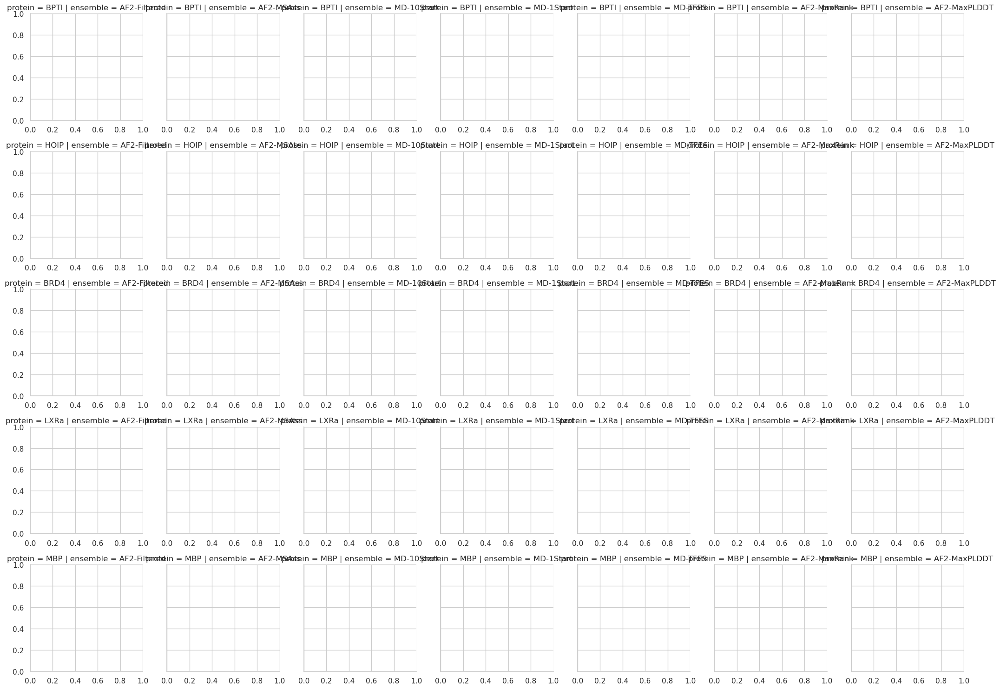

In [159]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming val_mse_BPTI_dfs is already filtered to include only 'Val' in "Type"
val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']

# remove mse less than 0
val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]

print(val_mse_dfs.mse.value_counts())
# Set the figure size and style if not already set globally
sns.set(style="whitegrid")

# Create a FacetGrid, mapping each 'protein' to a subplot
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row',row_order=protein_names)
g.map_dataframe(sns.boxplot, x='split_type', y='Gfe**(dMSE)', hue='bench', order=[ 'R3', 'Sp'], palette='tab10')

# Additional customizations
g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
g.add_legend()  # Add legend
g.set_axis_labels("Split Type", "Gfe**(dMSE)")  # Set axis labels

# Adjust the y-axis limits uniformly across all facets
# g.set(ylim=(0.9, 1.4))

# Optional: Adjust the legend and titles
plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI Val MSE vs Split Type by Protein')  # Set a super title for the grid
# g.set(yscale="log")
# Display the plot
plt.show()


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming val_mse_BPTI_dfs is already filtered to include only 'Val' in "Type"
val_mse_dfs = mse_dfs[mse_dfs['Type'] == 'Val']

# remove mse less than 0
val_mse_dfs = val_mse_dfs[val_mse_dfs['mse'] > 0]

print(val_mse_dfs.mse.value_counts())
# Set the figure size and style if not already set globally
sns.set(style="whitegrid")

# Create a FacetGrid, mapping each 'protein' to a subplot
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="ensemble", height=3, aspect=1, sharey='row', sharex='row',row_order=protein_names)
g.map_dataframe(sns.boxplot, x='split_type', y='Gfe**(dMSE)', hue='bench', order=[ 'R3', 'Sp'], palette='pastel')

# Additional customizations
g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
g.add_legend()  # Add legend
g.set_axis_labels("Split Type", "Gfe**(dMSE)")  # Set axis labels

# Adjust the y-axis limits uniformly across all facets
# g.set(ylim=(0.9, 1.4))

# Optional: Adjust the legend and titles
plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title
# g.fig.suptitle('BPTI Val MSE vs Split Type by Protein')  # Set a super title for the grid
# g.set(yscale="log")
# Display the plot
plt.show()


In [ ]:
_dMSE_energy_df

In [ ]:
import seaborn as sns

import matplotlib.pyplot as plt

sns.set(style="whitegrid")
replicate_order = ["1", "2", "3", "4", "5", "6", "7", "8", "9", "10"]
_dMSE_energy_df["replicate"] = _dMSE_energy_df["replicate"].astype("int")

# Create a FacetGrid, mapping each 'protein' to a subplot
g = sns.FacetGrid(_dMSE_energy_df, row="protein", col="split_type", height=3, aspect=1, sharey='row', sharex='row',row_order=["BPTI"])
g.map_dataframe(sns.scatterplot, x='replicate', y='dMSE', hue='ensemble', palette='Set1', style='split_type')

# Additional customizations
g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
g.set_axis_labels("Replicate", "dMSE")  # Set axis labels

# Set grid spacing to match values of x
g.set(xticks=_dMSE_energy_df["replicate"].unique())

# Display the plot
plt.show()


In [ ]:
# import seaborn as sns
# import matplotlib.pyplot as plt


# # Create a FacetGrid, mapping each 'protein' to a subplot
# g = sns.FacetGrid(dMSE_df, row="protein", col="split_type", height=3, aspect=1, sharey='row', sharex='row',row_order=protein_names)
# g.map_dataframe(sns.scatterplot, x='replicate', y='dMSE', hue='ensemble', palette='tab10', style='split_type')

# # Additional customizations
# g.set_titles("Protein: {row_name} | {col_name}")  # Set titles for subplots
# g.add_legend()  # Add legend
# g.set_axis_labels("Split Type", "dMSE/work")  # Set axis labels

# # Optional: Adjust the legend and titles
# plt.subplots_adjust(top=0.95)  # Adjust subplots to provide space for the title

# # Display the plot
# plt.show()


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Get unique values
proteins = _dMSE_energy_df['protein'].unique()
split_types = _dMSE_energy_df['split_type'].unique()

# Calculate the grid size
n_rows = len(proteins)
n_cols = len(split_types)

# Create the figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 3*n_rows), sharex='row', sharey='row')

# Flatten axes if it's a 1D array
if n_rows == 1 or n_cols == 1:
    axes = axes.flatten()

# Loop through proteins and split_types
for i, protein in enumerate(protein_names):
    for j, split_type in enumerate(split_types):
        # Filter data
        data = _dMSE_energy_df[((_dMSE_energy_df['protein'] == protein) & 
                                (_dMSE_energy_df['split_type'] == split_type))]
        
        # Get the correct axis
        if n_rows == 1 and n_cols == 1:
            ax = axes
        elif n_rows == 1 or n_cols == 1:
            ax = axes[i*n_cols + j]
        else:
            ax = axes[i, j]
        
        # Create the line plot
        sns.lineplot(data=data, x='replicate', y='dMSE/work', hue='ensemble', 
                     palette='Set1', style='split_type', markers=True, dashes=False, ax=ax)
        
        # Set title
        ax.set_title(f"Protein: {protein} | {split_type}")
        
        # Only set xlabel for bottom row
        if i == n_rows - 1:
            ax.set_xlabel("Replicate")
        else:
            ax.set_xlabel("")
        
        # Only set ylabel for left column
        if j == 0:
            ax.set_ylabel("dMSE/work")
        else:
            ax.set_ylabel("")

# Adjust layout
plt.tight_layout()

# Add a general legend
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=3)

# Remove individual legends
for ax in fig.get_axes():
    ax.get_legend().remove()

plt.show()